In [1]:
import pandas as pd

In [2]:
use_sdf=True
data=pd.read_excel("diff_dataset_03.xlsx",index_col=0)
data

,Analyte,Retention time,CMPA,S_Analyte_dipole_x,S_Analyte_dipole_y,S_Analyte_dipole_z,R_Analyte_dipole_x,R_Analyte_dipole_y,R_Analyte_dipole_z,Analyte_dipole,pH,flow rate,column temperature,CMPA concentration,packing materials,column diameter,column length,solvent_polar
0,Alfuzosin,4.6,CM-B-CD,-1.638529,-1.966611,0.816202,-1.638514,-1.966612,-0.816219,2.686727,5.6,1.0,25,19.50,C4,4.6,250,76.8125
1,Terazosin,7.6,CM-B-CD,-0.824608,-3.208628,0.013942,-0.844138,-3.202228,-0.036212,3.311819,6.0,1.0,25,32.40,C4,4.6,250,78.7250
2,Doxazosin,6.3,CM-B-CD,-0.482797,-3.521387,-0.150192,-0.481582,-3.521700,0.148434,3.557573,5.8,1.0,25,13.00,C4,4.6,250,71.5000
3,methylphenobarbital,-3.7,B-CD,0.489057,-0.083723,0.012511,0.489057,-0.083723,-0.012511,0.496329,4.3,1.0,25,17.60,C18,2.0,100,77.8750
4,Duloxetine_hydrochloride,4.4,SBE-B-CD,-0.356367,-0.475904,0.243404,-0.356367,-0.475904,-0.243404,0.642439,2.5,1.0,40,6.89,C18,4.6,150,67.4720
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135,Ibuprofen,4.7,HP-B-CD,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,20,25.00,C18,4.6,150,66.0800
136,Ibuprofen,3.8,HP-B-CD,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,30,25.00,C18,4.6,150,66.0800
137,Ibuprofen,3.1,HP-B-CD,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,40,25.00,C18,4.6,150,66.0800
138,Ibuprofen,2.4,HP-B-CD,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,50,25.00,C18,4.6,150,66.0800


In [3]:
finger_fenli = pd.read_csv(r'./fenli_huan_print_01.csv')
finger_tianjia = pd.read_csv(r'../tianjia_huan_print_01.csv')

finger_fenli = finger_fenli.rename(columns={"Unnamed: 0": 'Analyte'})
finger_tianjia = finger_tianjia.rename(columns={"Unnamed: 0": 'CMPA'})

data_fenli = pd.read_csv(r'./fenli_huan_features_01.csv')
data_tianjia = pd.read_csv(r'../tianjia_huan_features_01.csv')
data_PBF = pd.read_csv(r'PBF_features_01.csv')

data_fenli = data_fenli.rename(columns={"Unnamed: 0": 'Analyte'})
data_tianjia = data_tianjia.rename(columns={"Unnamed: 0": 'CMPA'})
data_PBF = data_PBF.rename(columns={"Unnamed: 0": 'Analyte'})

finger_1 = data.merge(finger_fenli, left_on='Analyte', right_on='Analyte', how='left')
finger_2 = finger_1.merge(finger_tianjia, left_on='CMPA', right_on='CMPA', how='left')
final_1 = finger_2.merge(data_fenli, left_on='Analyte', right_on='Analyte', how='left')

final_2 = final_1.merge(data_tianjia, left_on='CMPA', right_on='CMPA', how='left')
final_3 = final_2.merge(data_PBF, left_on='Analyte', right_on='Analyte', how='left')

material = final_3[['Analyte', 'CMPA']]
data_final = final_3.drop(['Analyte', 'CMPA'], axis=1)

In [4]:
data_final

,Retention time,S_Analyte_dipole_x,S_Analyte_dipole_y,S_Analyte_dipole_z,R_Analyte_dipole_x,R_Analyte_dipole_y,R_Analyte_dipole_z,Analyte_dipole,pH,flow rate,...,CMPA_chi1,CMPA_kappa1,CMPA_kappa2,CMPA_kappa3,CMPA_HallKierAlpha,CMPA_maccs_fingerprint,CMPA_topological_torsion,CMPA_Morgan Fingerprint,R_PBF,S_PBF
0,4.6,-1.638529,-1.966611,0.816202,-1.638514,-1.966612,-0.816219,2.686727,5.6,1.0,...,83.818148,28.494708,41.185505,22.713404,-1.96,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 0 0 ... 0 0 0],1.065515,1.066900
1,7.6,-0.824608,-3.208628,0.013942,-0.844138,-3.202228,-0.036212,3.311819,6.0,1.0,...,83.818148,28.494708,41.185505,22.713404,-1.96,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 0 0 ... 0 0 0],0.837385,0.868995
2,6.3,-0.482797,-3.521387,-0.150192,-0.481582,-3.521700,0.148434,3.557573,5.8,1.0,...,83.818148,28.494708,41.185505,22.713404,-1.96,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 0 0 ... 0 0 0],1.252167,0.977538
3,-3.7,0.489057,-0.083723,0.012511,0.489057,-0.083723,-0.012511,0.496329,4.3,1.0,...,65.423359,18.067180,26.029053,12.055260,-1.40,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 0 0 ... 0 0 0],1.132214,1.132393
4,4.4,-0.356367,-0.475904,0.243404,-0.356367,-0.475904,-0.243404,0.642439,2.5,1.0,...,24.409584,4.166097,20.963630,21.920000,-0.08,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 0 0 ... 0 0 0],0.679494,0.629303
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,4.7,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,...,94.873106,21.885093,41.381888,23.728684,-1.68,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 1 0 ... 0 0 0],0.897324,0.848207
135,3.8,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,...,94.873106,21.885093,41.381888,23.728684,-1.68,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 1 0 ... 0 0 0],0.897324,0.848207
136,3.1,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,...,94.873106,21.885093,41.381888,23.728684,-1.68,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 1 0 ... 0 0 0],0.897324,0.848207
137,2.4,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,...,94.873106,21.885093,41.381888,23.728684,-1.68,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 1 0 ... 0 0 0],0.897324,0.848207


In [5]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder

# 初始化LabelEncoder
le_metal = LabelEncoder()
# 对“色谱柱”列进行编码
data_final['packing materials'] = le_metal.fit_transform(data['packing materials'])
# data_final['柱长'] = le_metal.fit_transform(data['柱长'])

In [6]:
# 目标值
y = data_final["Retention time"]
X = data_final.drop("Retention time", axis=1)
X

,S_Analyte_dipole_x,S_Analyte_dipole_y,S_Analyte_dipole_z,R_Analyte_dipole_x,R_Analyte_dipole_y,R_Analyte_dipole_z,Analyte_dipole,pH,flow rate,column temperature,...,CMPA_chi1,CMPA_kappa1,CMPA_kappa2,CMPA_kappa3,CMPA_HallKierAlpha,CMPA_maccs_fingerprint,CMPA_topological_torsion,CMPA_Morgan Fingerprint,R_PBF,S_PBF
0,-1.638529,-1.966611,0.816202,-1.638514,-1.966612,-0.816219,2.686727,5.6,1.0,25,...,83.818148,28.494708,41.185505,22.713404,-1.96,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 0 0 ... 0 0 0],1.065515,1.066900
1,-0.824608,-3.208628,0.013942,-0.844138,-3.202228,-0.036212,3.311819,6.0,1.0,25,...,83.818148,28.494708,41.185505,22.713404,-1.96,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 0 0 ... 0 0 0],0.837385,0.868995
2,-0.482797,-3.521387,-0.150192,-0.481582,-3.521700,0.148434,3.557573,5.8,1.0,25,...,83.818148,28.494708,41.185505,22.713404,-1.96,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 0 0 ... 0 0 0],1.252167,0.977538
3,0.489057,-0.083723,0.012511,0.489057,-0.083723,-0.012511,0.496329,4.3,1.0,25,...,65.423359,18.067180,26.029053,12.055260,-1.40,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 0 0 ... 0 0 0],1.132214,1.132393
4,-0.356367,-0.475904,0.243404,-0.356367,-0.475904,-0.243404,0.642439,2.5,1.0,40,...,24.409584,4.166097,20.963630,21.920000,-0.08,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 0 0 ... 0 0 0],0.679494,0.629303
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,20,...,94.873106,21.885093,41.381888,23.728684,-1.68,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 1 0 ... 0 0 0],0.897324,0.848207
135,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,30,...,94.873106,21.885093,41.381888,23.728684,-1.68,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 1 0 ... 0 0 0],0.897324,0.848207
136,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,40,...,94.873106,21.885093,41.381888,23.728684,-1.68,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 1 0 ... 0 0 0],0.897324,0.848207
137,0.142286,0.239000,0.447573,0.278330,0.313737,-0.344093,0.542493,4.6,1.0,50,...,94.873106,21.885093,41.381888,23.728684,-1.68,[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0...,[0 0 0 ... 0 0 0],[0 1 0 ... 0 0 0],0.897324,0.848207


In [7]:

fingers = X.drop(
     ['R_Analyte_dipole_x', 'R_Analyte_dipole_y', 'R_Analyte_dipole_z','S_Analyte_dipole_x', 'S_Analyte_dipole_y', 'S_Analyte_dipole_z',"Analyte_dipole", 'pH', 'flow rate', 'column temperature', 'CMPA concentration', 'packing materials', "column diameter",
     'column length', 'solvent_polar'], axis=1)

x = ['maccs_fingerprint']  # 示例的特征列表

# 初始化一个列表来存储生成的列名
new_columns = []

# 前缀列表

prefixes = ['Analyte', 'CMPA']

# 遍历所有前缀和特征，生成新的列名
for prefix in prefixes:
    for feature in x:
        new_columns.append(f"{prefix}_{feature}")

# 显示结果
print(new_columns)
choose_finger = []

# 遍历所有列名并检查是否与new_columns中的前缀部分匹配
for col in fingers.columns:
    if '_' in col:
        prefix = '_'.join(col.split('_')[:-1])
        if prefix in new_columns:
            choose_finger.append(col)
print(choose_finger)

basic_feature = ['Labute ASA', 'Number of Rotatable Bonds', 'Molecular Weight', 'LogP', 'chi0', 'kappa1',
                 'Topological Polar Surface Area', 'kappa2', 'Num Valence Electrons', 'kappa3', 'HallKierAlpha', 'chi1']
# 初始化一个列表来存储生成的列名
choose_basic_feature = []

# 前缀列表
# 遍历所有前缀和特征，生成新的列名
for prefix in prefixes:
    for feature in basic_feature:
        choose_basic_feature.append(f"{prefix}_{feature}")
        print(f"{prefix}_{feature}")
choose_basic_feature.append('Fsp3')
choose_basic_feature.append('R_PBF')
choose_basic_feature.append('S_PBF')

# 显示结果
basic_feature = data_final[choose_basic_feature]
finger_feature = X[choose_finger]
X = pd.concat([basic_feature, data_final[
    ['R_Analyte_dipole_x', 'R_Analyte_dipole_y', 'R_Analyte_dipole_z','S_Analyte_dipole_x', 'S_Analyte_dipole_y', 'S_Analyte_dipole_z',"Analyte_dipole", 'pH', 'flow rate', 'column temperature', 'CMPA concentration', 'packing materials', "column diameter",
     'column length', 'solvent_polar']]], axis=1)
X

['Analyte_maccs_fingerprint', 'CMPA_maccs_fingerprint']
['Analyte_maccs_fingerprint_0', 'Analyte_maccs_fingerprint_1', 'Analyte_maccs_fingerprint_2', 'Analyte_maccs_fingerprint_3', 'Analyte_maccs_fingerprint_4', 'Analyte_maccs_fingerprint_5', 'Analyte_maccs_fingerprint_6', 'Analyte_maccs_fingerprint_7', 'Analyte_maccs_fingerprint_8', 'Analyte_maccs_fingerprint_9', 'Analyte_maccs_fingerprint_10', 'Analyte_maccs_fingerprint_11', 'Analyte_maccs_fingerprint_12', 'Analyte_maccs_fingerprint_13', 'Analyte_maccs_fingerprint_14', 'Analyte_maccs_fingerprint_15', 'Analyte_maccs_fingerprint_16', 'Analyte_maccs_fingerprint_17', 'Analyte_maccs_fingerprint_18', 'Analyte_maccs_fingerprint_19', 'Analyte_maccs_fingerprint_20', 'Analyte_maccs_fingerprint_21', 'Analyte_maccs_fingerprint_22', 'Analyte_maccs_fingerprint_23', 'Analyte_maccs_fingerprint_24', 'Analyte_maccs_fingerprint_25', 'Analyte_maccs_fingerprint_26', 'Analyte_maccs_fingerprint_27', 'Analyte_maccs_fingerprint_28', 'Analyte_maccs_fingerprin

,Analyte_Labute ASA,Analyte_Number of Rotatable Bonds,Analyte_Molecular Weight,Analyte_LogP,Analyte_chi0,Analyte_kappa1,Analyte_Topological Polar Surface Area,Analyte_kappa2,Analyte_Num Valence Electrons,Analyte_kappa3,...,S_Analyte_dipole_z,Analyte_dipole,pH,flow rate,column temperature,CMPA concentration,packing materials,column diameter,column length,solvent_polar
0,202.272669,10,389.456,0.65860,43.463737,6.114486,110.77,10.603833,152,5.410307,...,0.816202,2.686727,5.6,1.0,25,19.50,1,4.6,250,76.8125
1,198.608812,6,387.440,0.36470,41.463737,6.336249,101.98,9.196038,150,4.233319,...,0.013942,3.311819,6.0,1.0,25,32.40,1,4.6,250,78.7250
2,226.107485,6,451.483,0.93870,44.634946,8.578875,111.21,10.694450,172,5.111106,...,-0.150192,3.557573,5.8,1.0,25,13.00,1,4.6,250,71.5000
3,124.559991,4,246.266,1.14340,25.350853,4.669720,66.48,5.426676,94,2.079027,...,0.012511,0.496329,4.3,1.0,25,17.60,0,2.0,100,77.8750
4,156.637566,7,297.423,4.00180,31.074468,4.891144,21.26,8.214712,108,4.172224,...,0.243404,0.642439,2.5,1.0,40,6.89,0,4.6,150,67.4720
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,82,4.116334,...,0.447573,0.542493,4.6,1.0,20,25.00,0,4.6,150,66.0800
135,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,82,4.116334,...,0.447573,0.542493,4.6,1.0,30,25.00,0,4.6,150,66.0800
136,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,82,4.116334,...,0.447573,0.542493,4.6,1.0,40,25.00,0,4.6,150,66.0800
137,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,82,4.116334,...,0.447573,0.542493,4.6,1.0,50,25.00,0,4.6,150,66.0800


In [8]:
show_data = pd.concat([material, X, y], axis=1)
show_data

,Analyte,CMPA,Analyte_Labute ASA,Analyte_Number of Rotatable Bonds,Analyte_Molecular Weight,Analyte_LogP,Analyte_chi0,Analyte_kappa1,Analyte_Topological Polar Surface Area,Analyte_kappa2,...,Analyte_dipole,pH,flow rate,column temperature,CMPA concentration,packing materials,column diameter,column length,solvent_polar,Retention time
0,Alfuzosin,CM-B-CD,202.272669,10,389.456,0.65860,43.463737,6.114486,110.77,10.603833,...,2.686727,5.6,1.0,25,19.50,1,4.6,250,76.8125,4.6
1,Terazosin,CM-B-CD,198.608812,6,387.440,0.36470,41.463737,6.336249,101.98,9.196038,...,3.311819,6.0,1.0,25,32.40,1,4.6,250,78.7250,7.6
2,Doxazosin,CM-B-CD,226.107485,6,451.483,0.93870,44.634946,8.578875,111.21,10.694450,...,3.557573,5.8,1.0,25,13.00,1,4.6,250,71.5000,6.3
3,methylphenobarbital,B-CD,124.559991,4,246.266,1.14340,25.350853,4.669720,66.48,5.426676,...,0.496329,4.3,1.0,25,17.60,0,2.0,100,77.8750,-3.7
4,Duloxetine_hydrochloride,SBE-B-CD,156.637566,7,297.423,4.00180,31.074468,4.891144,21.26,8.214712,...,0.642439,2.5,1.0,40,6.89,0,4.6,150,67.4720,4.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,Ibuprofen,HP-B-CD,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,...,0.542493,4.6,1.0,20,25.00,0,4.6,150,66.0800,4.7
135,Ibuprofen,HP-B-CD,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,...,0.542493,4.6,1.0,30,25.00,0,4.6,150,66.0800,3.8
136,Ibuprofen,HP-B-CD,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,...,0.542493,4.6,1.0,40,25.00,0,4.6,150,66.0800,3.1
137,Ibuprofen,HP-B-CD,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,...,0.542493,4.6,1.0,50,25.00,0,4.6,150,66.0800,2.4


In [9]:
show_data = pd.concat([material, X, y], axis=1)
show_data['index'] = show_data.index
X = show_data.drop(columns=['Analyte', 'CMPA', 'Retention time', 'index'])
X

,Analyte_Labute ASA,Analyte_Number of Rotatable Bonds,Analyte_Molecular Weight,Analyte_LogP,Analyte_chi0,Analyte_kappa1,Analyte_Topological Polar Surface Area,Analyte_kappa2,Analyte_Num Valence Electrons,Analyte_kappa3,...,S_Analyte_dipole_z,Analyte_dipole,pH,flow rate,column temperature,CMPA concentration,packing materials,column diameter,column length,solvent_polar
0,202.272669,10,389.456,0.65860,43.463737,6.114486,110.77,10.603833,152,5.410307,...,0.816202,2.686727,5.6,1.0,25,19.50,1,4.6,250,76.8125
1,198.608812,6,387.440,0.36470,41.463737,6.336249,101.98,9.196038,150,4.233319,...,0.013942,3.311819,6.0,1.0,25,32.40,1,4.6,250,78.7250
2,226.107485,6,451.483,0.93870,44.634946,8.578875,111.21,10.694450,172,5.111106,...,-0.150192,3.557573,5.8,1.0,25,13.00,1,4.6,250,71.5000
3,124.559991,4,246.266,1.14340,25.350853,4.669720,66.48,5.426676,94,2.079027,...,0.012511,0.496329,4.3,1.0,25,17.60,0,2.0,100,77.8750
4,156.637566,7,297.423,4.00180,31.074468,4.891144,21.26,8.214712,108,4.172224,...,0.243404,0.642439,2.5,1.0,40,6.89,0,4.6,150,67.4720
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,82,4.116334,...,0.447573,0.542493,4.6,1.0,20,25.00,0,4.6,150,66.0800
135,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,82,4.116334,...,0.447573,0.542493,4.6,1.0,30,25.00,0,4.6,150,66.0800
136,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,82,4.116334,...,0.447573,0.542493,4.6,1.0,40,25.00,0,4.6,150,66.0800
137,116.375811,7,206.285,3.17580,26.748559,2.667643,37.30,5.855791,82,4.116334,...,0.447573,0.542493,4.6,1.0,50,25.00,0,4.6,150,66.0800


In [10]:

X1 = X[[
    'Fsp3',
    'Analyte_Labute ASA',
    'Analyte_Number of Rotatable Bonds',
    # 'Analyte_Molecular Weight',
    'Analyte_LogP',
    # 'Analyte_chi0',
    'Analyte_kappa1',
    'Analyte_Topological Polar Surface Area',
    # 'Analyte_kappa2',
    # 'Analyte_Num Valence Electrons',
    'Analyte_kappa3',
    'Analyte_HallKierAlpha',
    # 'Analyte_chi1',
    'CMPA_Labute ASA',
    # 'CMPA_Number of Rotatable Bonds',
    #'CMPA_Molecular Weight',
    'CMPA_LogP',
    # 'CMPA_chi0',
    'CMPA_kappa1',
    # 'CMPA_Topological Polar Surface Area',
    # 'CMPA_kappa2',
    # 'CMPA_Num Valence Electrons',
    'CMPA_kappa3',
    'CMPA_HallKierAlpha',
    # 'CMPA_chi1',
    'R_Analyte_dipole_x',
    'R_Analyte_dipole_y',
    'R_Analyte_dipole_z',
    'S_Analyte_dipole_x',
    'S_Analyte_dipole_y',
    'S_Analyte_dipole_z',
    "Analyte_dipole",
    "S_PBF",
    "R_PBF",
    'pH',
    'flow rate',
    'column temperature',
    'CMPA concentration',
    'packing materials',
    'column diameter',
    'column length',
    'solvent_polar'
]]

X_title = pd.concat([show_data[['Analyte', 'CMPA']], X1], axis=1)
X_title = pd.concat([X_title, show_data['index']], axis=1)
y = show_data[['Retention time']]

In [69]:
from sklearn.multioutput import MultiOutputRegressor
from sklearn.ensemble import VotingRegressor
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from catboost import CatBoostRegressor
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_squared_error,r2_score,mean_absolute_error
from sklearn.svm import SVR
from sklearn.model_selection import KFold, cross_val_score
from sklearn.linear_model import LinearRegression
from xgboost import XGBRegressor
import optuna
import shap
from lightgbm import LGBMClassifier,LGBMRegressor
import matplotlib.pyplot as plt
#归一化
from sklearn.preprocessing import StandardScaler

standard = StandardScaler()

X_new = standard.fit_transform(X1)
y_new = standard.fit_transform(y)
X_new = pd.DataFrame(X_new, columns=X1.columns)
X_new


,Fsp3,Analyte_Labute ASA,Analyte_NRB,Analyte_LogP,Analyte_kappa1,Analyte_TPSA,Analyte_kappa3,Analyte_HallKierAlpha,CMPA_Labute ASA,CMPA_LogP,...,S_PBF,R_PBF,pH,flow rate,column temperature,CMPA concentration,packing materials,column diameter,column length,solvent_polar
0,1.752268,1.830392,1.682249,-1.509631,0.824786,1.935188,1.431104,-2.453583,0.508032,-0.358841,...,1.312306,1.453183,0.494821,0.426670,-0.388112,0.540643,-0.309174,0.647406,0.621991,0.748731
1,1.752268,1.737489,0.133689,-1.846156,0.934737,1.625972,0.444259,-2.453583,0.508032,-0.358841,...,-0.120861,-0.261433,0.799698,0.426670,-0.388112,1.795354,-0.309174,0.647406,0.621991,1.032219
2,0.261090,2.434765,0.133689,-1.188907,2.046644,1.950667,1.180239,-2.782939,0.508032,-0.358841,...,0.665170,2.856053,0.647260,0.426670,-0.388112,-0.091575,-0.309174,0.647406,0.621991,-0.038736
3,-0.074204,-0.140146,-0.640591,-0.954519,0.108463,0.377148,-1.362007,-1.136159,-0.385678,-0.447197,...,1.786585,1.954495,-0.496028,0.426670,-0.388112,0.355841,-0.839731,-6.780291,-2.518084,0.906224
4,-0.788257,0.673236,0.520829,2.318441,0.218246,-1.213609,0.393033,2.733773,-2.144371,2.077200,...,-1.856633,-1.448136,-1.867973,0.426670,1.923924,-0.685861,-0.839731,0.647406,-1.471392,-0.635803
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,1.211091,-0.347670,0.520829,1.372644,-0.884179,-0.649351,0.346173,-0.148092,0.789789,-0.118520,...,-0.271402,0.189069,-0.267370,0.426670,-1.158790,1.075597,-0.839731,0.647406,-1.471392,-0.842138
135,1.211091,-0.347670,0.520829,1.372644,-0.884179,-0.649351,0.346173,-0.148092,0.789789,-0.118520,...,-0.271402,0.189069,-0.267370,0.426670,0.382567,1.075597,-0.839731,0.647406,-1.471392,-0.842138
136,1.211091,-0.347670,0.520829,1.372644,-0.884179,-0.649351,0.346173,-0.148092,0.789789,-0.118520,...,-0.271402,0.189069,-0.267370,0.426670,1.923924,1.075597,-0.839731,0.647406,-1.471392,-0.842138
137,1.211091,-0.347670,0.520829,1.372644,-0.884179,-0.649351,0.346173,-0.148092,0.789789,-0.118520,...,-0.271402,0.189069,-0.267370,0.426670,3.465281,1.075597,-0.839731,0.647406,-1.471392,-0.842138


In [15]:
k_num = 4

In [152]:

# 定义目标函数
def objective_lgb(trial):
    # 选择超参数
    param = {
        'objective': 'regression',
        'metric': 'mse',
        'boosting_type': 'gbdt',  # 可以选择 gbdt, dart, 等
        'verbosity': -1,
        'num_leaves': trial.suggest_int('num_leaves', 20, 150),
        'max_depth': trial.suggest_int('max_depth', -1, 50),  # -1 表示无限制
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 0.1),
        'n_estimators': trial.suggest_int('n_estimators', 50, 500),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 1, 50),
        'device': 'gpu',              # 启用 GPU
        'gpu_device_id': 0,           # 使用第一个 GPU
    }

    # 创建 LGBMRegressor 模型
    lgb_model = LGBMRegressor(**param)
    kf = KFold(n_splits=k_num, shuffle=True,random_state=32)
    # scores = cross_val_score(xgb_model, X_new, y_new, cv=kf, scoring='neg_mean_absolute_error')
    scores = cross_val_score(lgb_model, X_new, y_new, cv=kf, scoring='r2')
    return scores.mean()

study_lgb = optuna.create_study(direction='maximize')  # 最大化准确率
study_lgb.optimize(objective_lgb, n_trials=100)


[I 2025-02-22 20:13:59,821] A new study created in memory with name: no-name-da07e86f-74b7-4780-bbc9-e85dd0d043ec
C:\Users\re\AppData\Local\Temp\ipykernel_28264\3383179012.py:12: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 0.1),
C:\Users\re\.conda\envs\py310\lib\site-packages\lightgbm\basic.py:357: UserWarning: Converting column-vector to 1d array
  _log_warning("Converting column-vector to 1d array")
C:\Users\re\.conda\envs\py310\lib\site-packages\lightgbm\basic.py:357: UserWarning: Converting column-vector to 1d array
  _log_warning("Converting column-vector to 1d array")
C:\Users\re\.conda\envs\py310\lib\site-packages\lightgbm\basic.py:357: UserWarning: Converting column-vector to 1d array
  _log_warning("Converting column-vector to 1d array")
C:\Users\re\.co

[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000381 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 435
[LightGBM] [Info] Number of data points in the train set: 104, number of used features: 30
[LightGBM] [Info] Start training from score -0.023923
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

C:\Users\re\.conda\envs\py310\lib\site-packages\lightgbm\basic.py:357: UserWarning: Converting column-vector to 1d array
  _log_warning("Converting column-vector to 1d array")


[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 403
[LightGBM] [Info] Number of data points in the train set: 104, number of used features: 30
[LightGBM] [Info] Start training from score 0.044469
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wi

C:\Users\re\.conda\envs\py310\lib\site-packages\lightgbm\basic.py:357: UserWarning: Converting column-vector to 1d array
  _log_warning("Converting column-vector to 1d array")
C:\Users\re\.conda\envs\py310\lib\site-packages\lightgbm\basic.py:357: UserWarning: Converting column-vector to 1d array
  _log_warning("Converting column-vector to 1d array")


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

C:\Users\re\.conda\envs\py310\lib\site-packages\lightgbm\basic.py:357: UserWarning: Converting column-vector to 1d array
  _log_warning("Converting column-vector to 1d array")


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000141 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 452
[LightGBM] [Info] Number of data points in the train set: 105, number of used features: 30
[LightGBM] [Info] Start training from score 0.022194
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

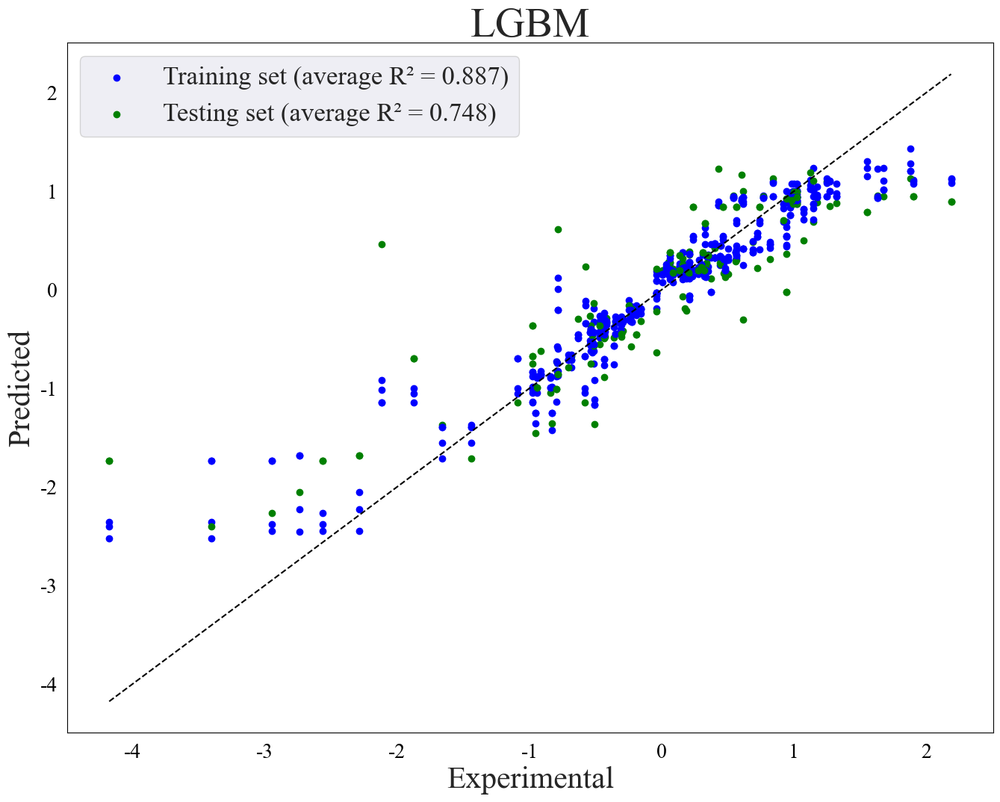

In [55]:

r2_train_lgb = []
r2_test_lgb = []
mae_train_lgb = []
mae_test_lgb = []
mse_train_lgb = []
mse_test_lgb = []
# 用于存储每个样本的预测值
predictions_lgb = np.zeros(y_new.shape).reshape(-1,1)

# 存储所有折的SHAP值
all_shap_values = []
all_expected_values = []
all_X_val = []
shap_values_list_lgb = []
idx_n = []
idx_t = []
fold = 0

plt.figure(figsize=(16, 12),facecolor='none')

kf = KFold(n_splits=k_num, shuffle=True)

for idx_train, idx_test in kf.split(X_new):
    idx_train = np.array(idx_train)
    idx_test = np.array(idx_test)
    X_train, X_test = X_new.iloc[idx_train], X_new.iloc[idx_test]
    y_train, y_test = y_new[idx_train], y_new[idx_test]

    lgb_model=LGBMRegressor(**study_lgb.best_params)
    lgb_model.fit(X_train, y_train)
    y_test_pred2 = lgb_model.predict(X_test)
    y_train_pred2 = lgb_model.predict(X_train)
    lgb_train_r2=r2_score(y_train,y_train_pred2)
    lgb_test_r2=r2_score(y_test,y_test_pred2)
    lgb_train_mae=mean_absolute_error(y_train, y_train_pred2)
    lgb_test_mae=mean_absolute_error(y_test, y_test_pred2)
    lgb_train_mse=mean_squared_error(y_train, y_train_pred2)
    lgb_test_mse=mean_squared_error(y_test, y_test_pred2)

    # 将预测值保存到对应的位置
    # predictions[idx_train] = y_train_pred1.reshape(-1,1)
    predictions_lgb[idx_test] = y_test_pred2.reshape(-1,1)
    r2_train_lgb.append(lgb_train_r2)
    r2_test_lgb.append(lgb_test_r2)
    mae_train_lgb.append(lgb_train_mae)
    mae_test_lgb.append(lgb_test_mae)
    mse_train_lgb.append(lgb_train_mse)
    mse_test_lgb.append(lgb_test_mse)


      # 计算 SHAP 值
    explainer = shap.TreeExplainer(lgb_model)
    shap_values = explainer.shap_values(X_test)
    shap_values1 = explainer(X_test)
    all_X_val.append(idx_test)
    for SHAPs in shap_values:
        shap_values_list_lgb.append(SHAPs)

    # 实际值与预测值的散点图
    plt.scatter(y_train, y_train_pred2,c = 'b')
    plt.scatter(y_test, y_test_pred2,c = 'g')

    fold +=1

plt.scatter(y_train, y_train_pred2, c='b', label=f'Training set (average R² = {sum(r2_train_lgb) / len(r2_train_lgb):.3f})')
plt.scatter(y_test, y_test_pred2 ,c= 'g' ,label=f'Testing set (average R² = {sum(r2_test_lgb) / len(r2_test_lgb):.3f})')

# 确定对角线的起止点
min_val = min(y_new)
max_val = max(y_new)
plt.rcParams['axes.unicode_minus'] = False

# 添加对角线，表示完美预测
plt.plot([min_val, max_val], [min_val, max_val], 'k--')

# 获取当前坐标轴
ax = plt.gca()

#隐藏右边和上边的边框
ax.spines['right'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_color('black')

# 设置坐标轴刻度样式
ax.tick_params(axis='both',       # 'x', 'y', 或 'both'
               which='major',     # 'both', 'major', 或 'minor'
               color='black',    # 刻度线的颜色
               labelcolor='black',
               direction = 'out',
                length = 6,       # 刻度线的长度
                width = 5,  # 刻度线颜色
                labelsize = 20  # 标签字体大小
               ) # 刻度标签的颜色

# 设置坐标轴背景颜色
ax.set_facecolor('none')
# 添加图例和标签
plt.grid(False)
plt.xlabel('Experimental',fontsize = 30)
plt.ylabel('Predicted',fontsize = 30)
plt.title('LGBM',fontsize = 40)
plt.legend(fontsize = 25)
plt.savefig('完美曲线_aveg_LGB_03.png',dpi=1000)
# 显示图表
plt.show()


In [20]:
X1.rename(columns={
    'Analyte_Number of Rotatable Bonds': 'Analyte_NRB',
                   'Analyte_Topological Polar Surface Area': 'Analyte_TPSA',
                   }, inplace=True)

C:\Users\re\AppData\Local\Temp\ipykernel_8176\4082792285.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X1.rename(columns={


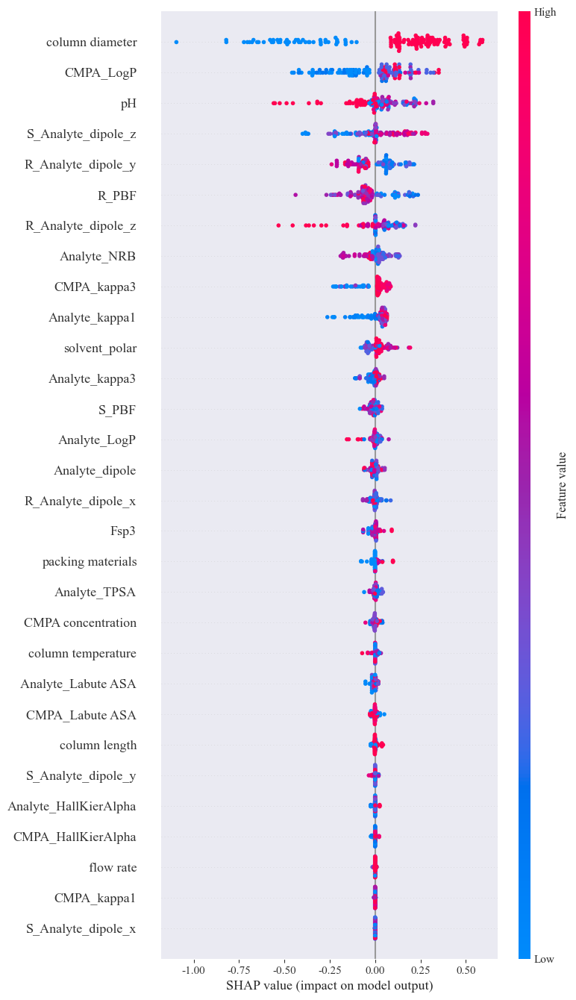

In [39]:
# plt.figure(figsize=(5, 4))
plt.rcParams['font.family'] = 'serif'  # 设置字体类型，例如 'serif', 'sans-serif'
plt.rcParams['font.serif'] = ['Times New Roman']  # 指定具体的 serif 字体
# plt.rcParams['font.sans-serif'] = ['SimHei']
# plt.rcParams['axes.unicode_minus'] = False # 显示负号
new_index = [ix for ix_test_fold in all_X_val for ix in ix_test_fold]
shap.summary_plot(np.array(shap_values_list_lgb),X1.reindex(new_index), max_display = 30,show=False)
plt.grid(False)
plt.savefig('LGBoost_SHAP_value_01.png',dpi = 1000)

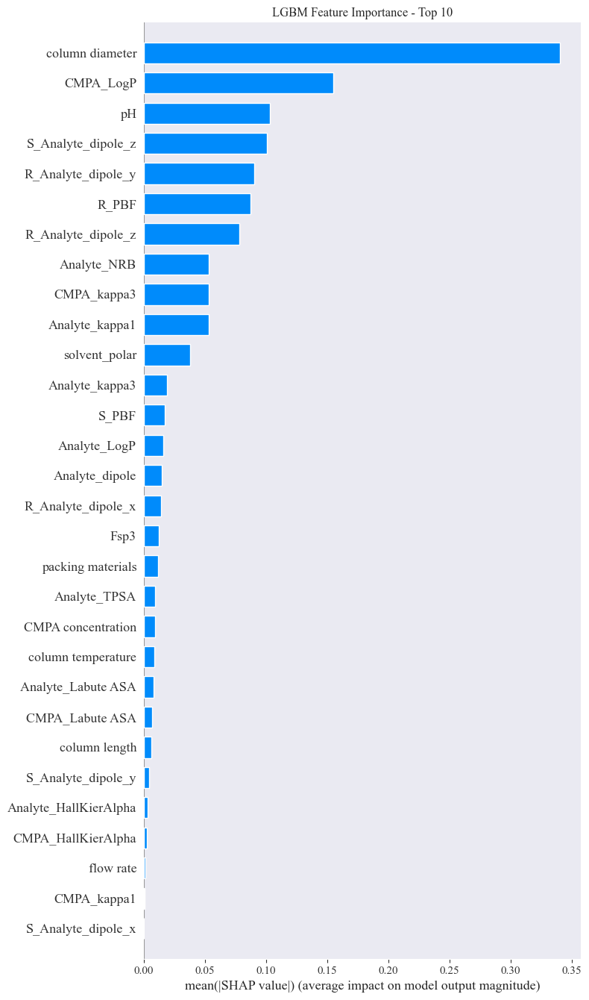

In [42]:
# 提取 SHAP 值和特征名称
shap_values_array = np.array(shap_values_list_lgb)
feature_names = X1.reindex(new_index).columns
plt.grid(False)
# plt.figure(figsize=(16,6))
# 创建一个 DataFrame 来存储特征的重要性（绝对值的平均）
shap_df = pd.DataFrame({
    'feature': feature_names,
    'shap_value': np.abs(shap_values_array).mean(axis=0)  # 计算每个特征的平均绝对 SHAP 值
})

# 对特征按重要性排序并选择前十个
top_features = shap_df.nlargest(30, 'shap_value')

# 绘制前十个特征的条形图
shap.summary_plot(
    shap_values_array[:, top_features.index],
    X1.reindex(new_index).iloc[:, top_features.index],
    plot_type="bar",
    show=False,
    max_display=30
)
plt.title(f'LGBM Feature Importance - Top 10')
plt.tight_layout()

plt.savefig('LGBoost_SHAP_value_importance_01.png',dpi = 1000)

In [157]:
# 定义目标函数
def objective(trial):
 # 设定XGBoost的超参数
 param = {
  'objective': 'reg:squarederror',  # 回归任务
  'eval_metric': 'rmse',
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1.0),
  'max_depth': trial.suggest_int('max_depth', 3, 10),
  'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),

  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),
  'lambda': trial.suggest_loguniform('lambda', 1e-5, 1.0),
  'alpha': trial.suggest_loguniform('alpha', 1e-5, 1.0),
  'n_estimators': 100,  # 固定树的数量
  'tree_method': 'gpu_hist',  # 启用 GPU 训练
 }

 xgb_model = XGBRegressor(**param)
 kf = KFold(n_splits=k_num, shuffle=True,random_state=32)
 # scores = cross_val_score(xgb_model, X_new, y_new, cv=kf, scoring='neg_mean_absolute_error')
 scores = cross_val_score(xgb_model, X_new, y_new, cv=kf, scoring='r2')

 return scores.mean()


study2 = optuna.create_study(direction='maximize')  # 最大化准确率
study2.optimize(objective, n_trials=100)


[I 2025-02-22 20:21:58,986] A new study created in memory with name: no-name-3d7b3715-21ab-4c8d-9cbe-b35b6bdc6a7e
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1412018989.py:7: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1.0),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1412018989.py:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1412018989.py:12: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use su

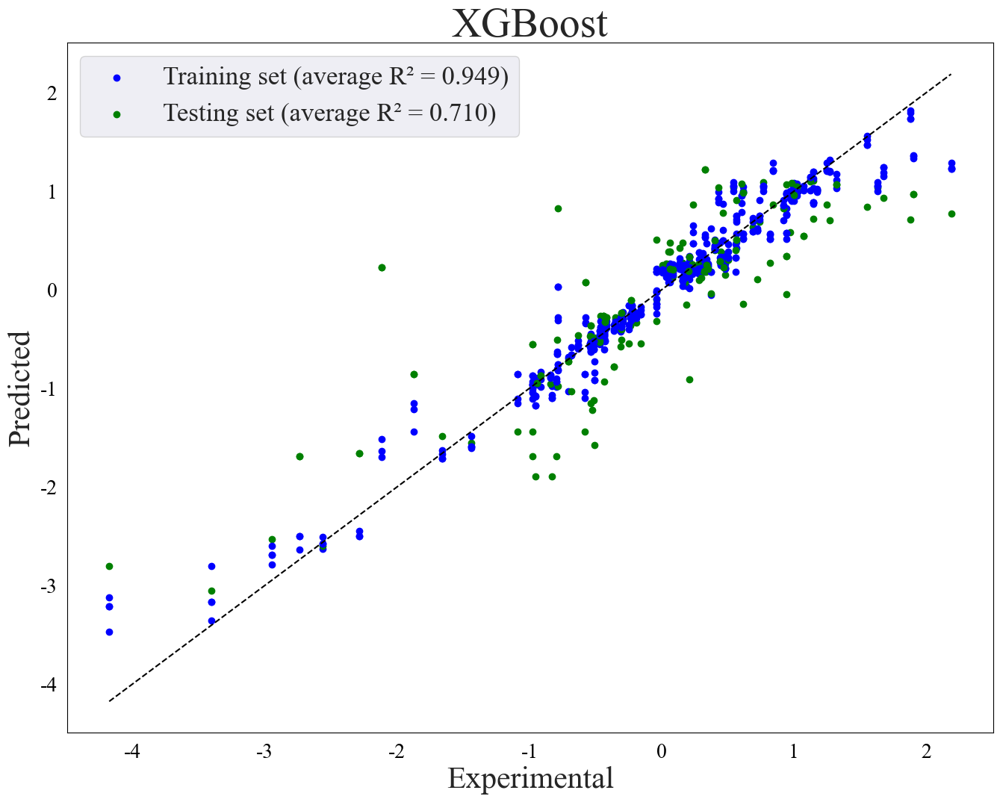

In [76]:

r2_train_xgb = []
r2_test_xgb = []
mae_train_xgb = []
mae_test_xgb = []
mse_train_xgb = []
mse_test_xgb = []
# 用于存储每个样本的预测值
predictions_xgb = np.zeros(y_new.shape).reshape(-1, 1)
# 存储所有折的SHAP值
all_shap_values = []
all_expected_values = []
all_X_val = []
shap_values_list_xgb = []
fold = 0

plt.figure(figsize=(16, 12), facecolor='none')
# 设置全局字体
plt.rcParams['font.family'] = 'serif'  # 设置字体类型，例如 'serif', 'sans-serif'
plt.rcParams['font.serif'] = ['Times New Roman']  # 指定具体的 serif 字体
plt.rcParams['font.size'] = 10  # 设置字体大小

kf = KFold(n_splits=k_num, shuffle=True, random_state=32)
# 执行 K 倍验证
for idx_train, idx_test in kf.split(X_new):
  X_train, X_test = X_new.iloc[idx_train], X_new.iloc[idx_test]
  y_train, y_test = y_new[idx_train], y_new[idx_test]

  xgb_model = XGBRegressor(**study2.best_params)

  xgb_model.fit(X_train, y_train)
  y_test_pred1 = xgb_model.predict(X_test)
  y_train_pred1 = xgb_model.predict(X_train)
  xgb_train_r2 = r2_score(y_train, y_train_pred1)
  xgb_test_r2 = r2_score(y_test, y_test_pred1)
  xgb_train_mae = mean_absolute_error(y_train, y_train_pred1)
  xgb_test_mae = mean_absolute_error(y_test, y_test_pred1)
  xgb_train_mse = mean_squared_error(y_train, y_train_pred1)
  xgb_test_mse = mean_squared_error(y_test, y_test_pred1)

  # 将预测值保存到对应的位置
  # predictions[idx_train] = y_train_pred1.reshape(-1,1)
  predictions_xgb[idx_test] = y_test_pred1.reshape(-1, 1)
  r2_train_xgb.append(xgb_train_r2)
  r2_test_xgb.append(xgb_test_r2)
  mae_train_xgb.append(xgb_train_mae)
  mae_test_xgb.append(xgb_test_mae)
  mse_train_xgb.append(xgb_train_mse)
  mse_test_xgb.append(xgb_test_mse)

  # 计算 SHAP 值
  explainer = shap.TreeExplainer(xgb_model)
  shap_values = explainer.shap_values(X_test)
  shap_values1 = explainer(X_test)
  all_X_val.append(idx_test)
  for SHAPs in shap_values:
   shap_values_list_xgb.append(SHAPs)

  # 实际值与预测值的散点图
  plt.scatter(y_train, y_train_pred1, c='b')
  plt.scatter(y_test, y_test_pred1, c='g')
  fold += 1

plt.scatter(y_train, y_train_pred1, c='b', label=f'Training set (average R² = {sum(r2_train_xgb) / len(r2_train_xgb):.3f})')
plt.scatter(y_test, y_test_pred1 ,c= 'g' ,label=f'Testing set (average R² = {sum(r2_test_xgb) / len(r2_test_xgb):.3f})')

# 确定对角线的起止点
min_val = min(y_new)
max_val = max(y_new)
plt.rcParams['axes.unicode_minus'] = False

# 添加对角线，表示完美预测
plt.plot([min_val, max_val], [min_val, max_val], 'k--')

# 获取当前坐标轴
ax = plt.gca()

#隐藏右边和上边的边框
ax.spines['right'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_color('black')

# 设置坐标轴刻度样式
ax.tick_params(axis='both',  # 'x', 'y', 或 'both'
               which='major',  # 'both', 'major', 或 'minor'
               color='black',  # 刻度线的颜色
               labelcolor='black',
               direction='out',
               length=6,  # 刻度线的长度
               width=5,  # 刻度线颜色
               labelsize=20  # 标签字体大小
               )  # 刻度标签的颜色

# 设置坐标轴背景颜色
ax.set_facecolor('none')
# 添加图例和标签
plt.grid(False)
plt.xlabel('Experimental',fontsize = 30)
plt.ylabel('Predicted',fontsize = 30)
plt.title('XGBoost',fontsize = 40)
plt.legend(fontsize = 25)
plt.savefig('完美曲线_aveg_XGB.png',dpi=1000)
# 显示图表
plt.show()


In [161]:
from sklearn.svm import SVR

def objective_svr(trial):
    # 定义超参数搜索空间
    C = trial.suggest_loguniform('C', 1e-5, 1e5)
    gamma = trial.suggest_categorical('gamma', ['scale', 'auto'])
    epsilon = trial.suggest_uniform('epsilon', 0, 1)
    # 创建 SVR 模型
    svr_model = SVR(kernel='rbf', C=C, gamma=gamma, epsilon=epsilon)
    # # 训练模型
    kf = KFold(n_splits=k_num, shuffle=True,random_state=32)
    # scores = cross_val_score(svr_model, X_new, y_new, cv=kf, scoring='neg_mean_squared_error')
    scores = cross_val_score(svr_model, X_new, y_new, cv=kf, scoring='r2')
    return scores.mean()

study_svr = optuna.create_study(direction='maximize')
study_svr.optimize(objective_svr, n_trials=200)


[I 2025-02-22 20:27:35,021] A new study created in memory with name: no-name-11fe77c0-772c-4312-90f2-bc7e325469cc
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1773067866.py:5: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  C = trial.suggest_loguniform('C', 1e-5, 1e5)
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1773067866.py:7: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  epsilon = trial.suggest_uniform('epsilon', 0, 1)
C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tru

C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape

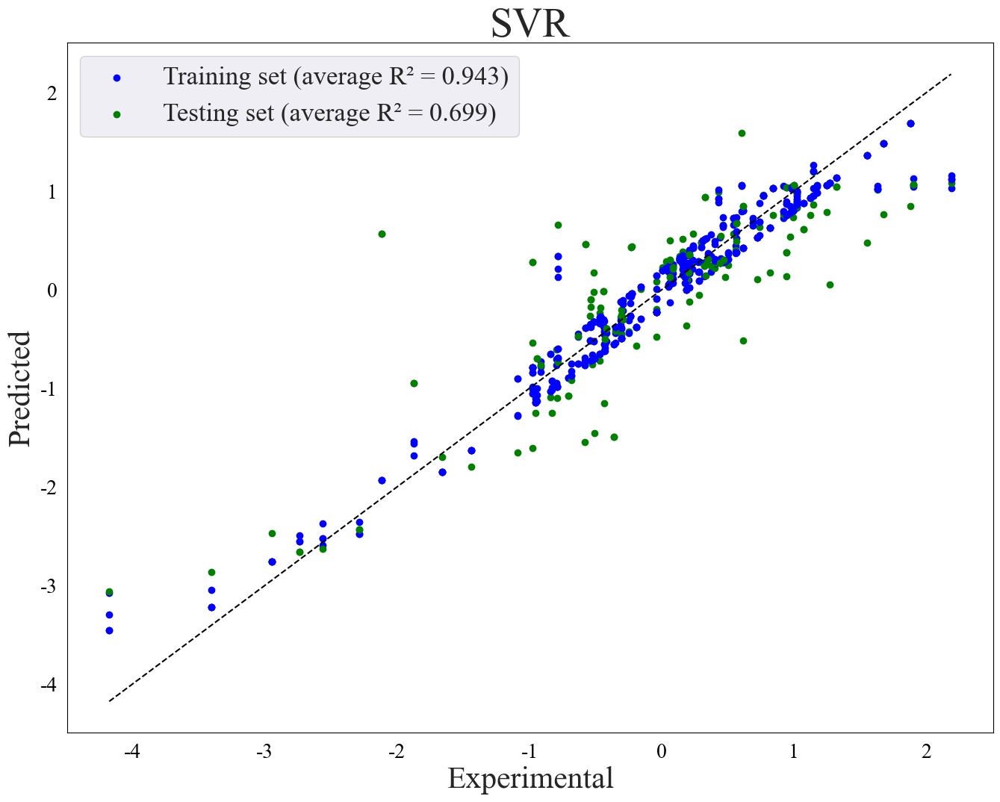

In [78]:

r2_train_SVR = []
r2_test_SVR = []
mae_train_SVR = []
mae_test_SVR = []
mse_train_SVR = []

mse_test_SVR = []
# 用于存储每个样本的预测值
predictions_SVR = np.zeros(y_new.shape).reshape(-1,1)
fold = 0
plt.figure(figsize=(16, 12), facecolor='none')
kf = KFold(n_splits=k_num, shuffle=True,random_state=32)
for idx_train, idx_test in kf.split(X_new):
    X_train, X_test = X_new.iloc[idx_train], X_new.iloc[idx_test]
    y_train, y_test = y_new[idx_train], y_new[idx_test]

    # 使用 Optuna 进行优化
    SVR_model=SVR(**study_svr.best_params)

    SVR_model.fit(X_train, y_train)
    y_test_pred_SVR= SVR_model.predict(X_test)
    y_train_pred_SVR= SVR_model.predict(X_train)
    SVR_train_r2=r2_score(y_train,y_train_pred_SVR)
    SVR_test_r2=r2_score(y_test,y_test_pred_SVR)
    SVR_train_mae=mean_absolute_error(y_train, y_train_pred_SVR)
    SVR_test_mae=mean_absolute_error(y_test, y_test_pred_SVR)
    SVR_train_mse=mean_squared_error(y_train, y_train_pred_SVR)
    SVR_test_mse=mean_squared_error(y_test, y_test_pred_SVR)

     # 将预测值保存到对应的位置
    # predictions[idx_train] = y_train_pred1.reshape(-1,1)
    predictions_SVR[idx_test] = y_test_pred_SVR.reshape(-1,1)
    r2_train_SVR.append(SVR_train_r2)
    r2_test_SVR.append(SVR_test_r2)
    mae_train_SVR.append(SVR_train_mae)
    mae_test_SVR.append(SVR_test_mae)
    mse_train_SVR.append(SVR_train_mse)
    mse_test_SVR.append(SVR_test_mse)

  # 实际值与预测值的散点图
    plt.scatter(y_train, y_train_pred_SVR, c='b')
    plt.scatter(y_test, y_test_pred_SVR ,c= 'g')
    fold += 1

plt.scatter(y_train, y_train_pred_SVR, c='b', label=f'Training set (average R² = {sum(r2_train_SVR) / len(r2_train_SVR):.3f})')
plt.scatter(y_test, y_test_pred_SVR ,c= 'g' ,label=f'Testing set (average R² = {sum(r2_test_SVR) / len(r2_test_SVR):.3f})')

# 确定对角线的起止点
min_val = min(y_new)
max_val = max(y_new)
plt.rcParams['axes.unicode_minus'] = False

# 添加对角线，表示完美预测
plt.plot([min_val, max_val], [min_val, max_val], 'k--')

# 获取当前坐标轴
ax = plt.gca()

#隐藏右边和上边的边框
ax.spines['right'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_color('black')

# 设置坐标轴刻度样式
ax.tick_params(axis='both',  # 'x', 'y', 或 'both'
               which='major',  # 'both', 'major', 或 'minor'
               color='black',  # 刻度线的颜色
               labelcolor='black',
               direction='out',
               length=6,  # 刻度线的长度
               width=5,  # 刻度线颜色
               labelsize=20  # 标签字体大小
               )  # 刻度标签的颜色

# 设置坐标轴背景颜色
ax.set_facecolor('none')
# 添加图例和标签
plt.grid(False)
plt.xlabel('Experimental',fontsize = 30)
plt.ylabel('Predicted',fontsize = 30)
plt.title('SVR',fontsize = 40)
plt.legend(fontsize = 25)
plt.savefig('完美曲线_aveg_SVR.png',dpi=1000)
# 显示图表
plt.show()


In [165]:
# Optuna 优化目标函数
def objective_EN(trial):
    #  # 选择参数
    # alpha = trial.suggest_loguniform('alpha', 1e-5, 1e1)
    # l1_ratio = trial.suggest_uniform('l1_ratio', 0, 1)
    # # 创建弹性网回归模型
    # model = ElasticNet(alpha=alpha, l1_ratio=l1_ratio, random_state=42)
     # 超参数：正则化强度 alpha
    alpha = trial.suggest_loguniform('alpha', 1e-5, 10)
    # 创建 Ridge 回归模型
    model = Lasso(alpha=alpha)
    # # 拟合模型
    kf = KFold(n_splits=k_num, shuffle=True, random_state=32)
    # scores = cross_val_score(model, X_new, y_new, cv=kf, scoring='neg_mean_squared_error')
    scores = cross_val_score(model, X_new, y_new, cv=kf, scoring='r2')
    return scores.mean()

# 创建并运行 Optuna study
study_EN = optuna.create_study(direction='maximize')
study_EN.optimize(objective_EN, n_trials=100)


[I 2025-02-22 20:28:52,220] A new study created in memory with name: no-name-2df9b0bd-b16a-4d75-9b46-0d2141cad195
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1642142041.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  alpha = trial.suggest_loguniform('alpha', 1e-5, 10)
C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.651e-02, tolerance: 1.301e-02
  model = cd_fast.enet_coordinate_descent(
C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check t

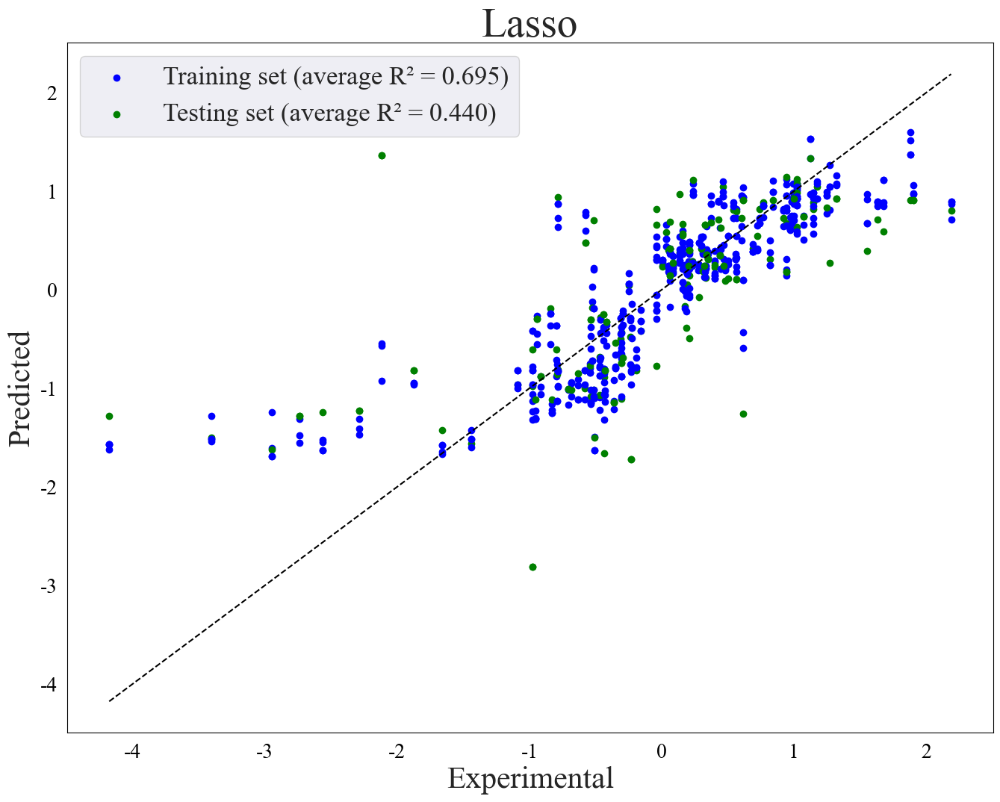

In [80]:

r2_train_EN = []
r2_test_EN = []
mae_train_EN = []
mae_test_EN = []
mse_train_EN = []
mse_test_EN = []
# 用于存储每个样本的预测值
predictions_EN = np.zeros(y_new.shape).reshape(-1,1)
plt.figure(figsize=(16, 12), facecolor='none')

kf = KFold(n_splits=k_num, shuffle=True, random_state=32)
for idx_train, idx_test in kf.split(X_new):
    X_train, X_test = X_new.iloc[idx_train], X_new.iloc[idx_test]
    y_train, y_test = y_new[idx_train], y_new[idx_test]

    # 使用 Optuna 进行优化
    # EN_model=ElasticNet(**study_EN.best_params)
    EN_model=Lasso(**study_EN.best_params)
    EN_model.fit(X_train, y_train)
    y_test_pred_EN= EN_model.predict(X_test)
    y_train_pred_EN= EN_model.predict(X_train)
    EN_train_r2=r2_score(y_train,y_train_pred_EN)
    EN_test_r2=r2_score(y_test,y_test_pred_EN)
    EN_train_mae=mean_absolute_error(y_train, y_train_pred_EN)
    EN_test_mae=mean_absolute_error(y_test, y_test_pred_EN)
    EN_train_mse=mean_squared_error(y_train, y_train_pred_EN)
    EN_test_mse=mean_squared_error(y_test, y_test_pred_EN)

   # 将预测值保存到对应的位置
    # predictions[idx_train] = y_train_pred1.reshape(-1,1)
    predictions_EN[idx_test] = y_test_pred_EN.reshape(-1,1)
    r2_train_EN.append(EN_train_r2)
    r2_test_EN.append(EN_test_r2)
    mae_train_EN.append(EN_train_mae)
    mae_test_EN.append(EN_test_mae)
    mse_train_EN.append(EN_train_mse)
    mse_test_EN.append(EN_test_mse)

    # 实际值与预测值的散点图
    plt.scatter(y_train, y_train_pred_EN, c='b')
    plt.scatter(y_test, y_test_pred_EN ,c= 'g')
    fold +=1

plt.scatter(y_train, y_train_pred_EN, c='b', label=f'Training set (average R² = {sum(r2_train_EN) / len(r2_train_EN):.3f})')
plt.scatter(y_test, y_test_pred_EN ,c= 'g' ,label=f'Testing set (average R² = {sum(r2_test_EN) / len(r2_test_EN):.3f})')

# 确定对角线的起止点
min_val = min(y_new)
max_val = max(y_new)
plt.rcParams['axes.unicode_minus'] = False

# 添加对角线，表示完美预测
plt.plot([min_val, max_val], [min_val, max_val], 'k--')

# 获取当前坐标轴
ax = plt.gca()

#隐藏右边和上边的边框
ax.spines['right'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_color('black')

# 设置坐标轴刻度样式
ax.tick_params(axis='both',       # 'x', 'y', 或 'both'
               which='major',     # 'both', 'major', 或 'minor'
               color='black',    # 刻度线的颜色
               labelcolor='black',
               direction = 'out',
                length = 6,       # 刻度线的长度
                width = 5,  # 刻度线颜色
                labelsize = 20  # 标签字体大小
               ) # 刻度标签的颜色

# 设置坐标轴背景颜色
ax.set_facecolor('none')
# 添加图例和标签
plt.grid(False)
plt.xlabel('Experimental',fontsize = 30)
plt.ylabel('Predicted',fontsize = 30)
plt.title('Lasso',fontsize = 40)
plt.legend(fontsize = 25)
plt.savefig('完美曲线_aveg_Lasso.png',dpi=1000)
# 显示图表
plt.show()

In [169]:
# 定义目标函数
def objective_gb(trial):
    # 选择超参数
    param = {
        'n_estimators': trial.suggest_int('n_estimators', 50, 500),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 0.1),
        'max_depth': trial.suggest_int('max_depth', 1, 10),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 20),
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 20),
        'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),
    }

    # 创建 GradientBoostingRegressor 模型
    gb_model = GradientBoostingRegressor(**param)
    kf = KFold(n_splits=k_num, shuffle=True, random_state=32)
    # scores = cross_val_score(gb_model, X_new, y_new, cv=kf, scoring='neg_mean_absolute_error')
    scores = cross_val_score(gb_model, X_new, y_new, cv=kf, scoring='r2')
    return scores.mean()

study_gb = optuna.create_study(direction='maximize')  # 最大化准确率
study_gb.optimize(objective_gb, n_trials=100)


[I 2025-02-22 20:29:42,056] A new study created in memory with name: no-name-dc3eace3-0020-4bba-981f-a25d23a40fdf
C:\Users\re\AppData\Local\Temp\ipykernel_28264\707868557.py:6: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 0.1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\707868557.py:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),
C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\re\.conda\envs\py310\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

<Figure size 1600x1200 with 0 Axes>

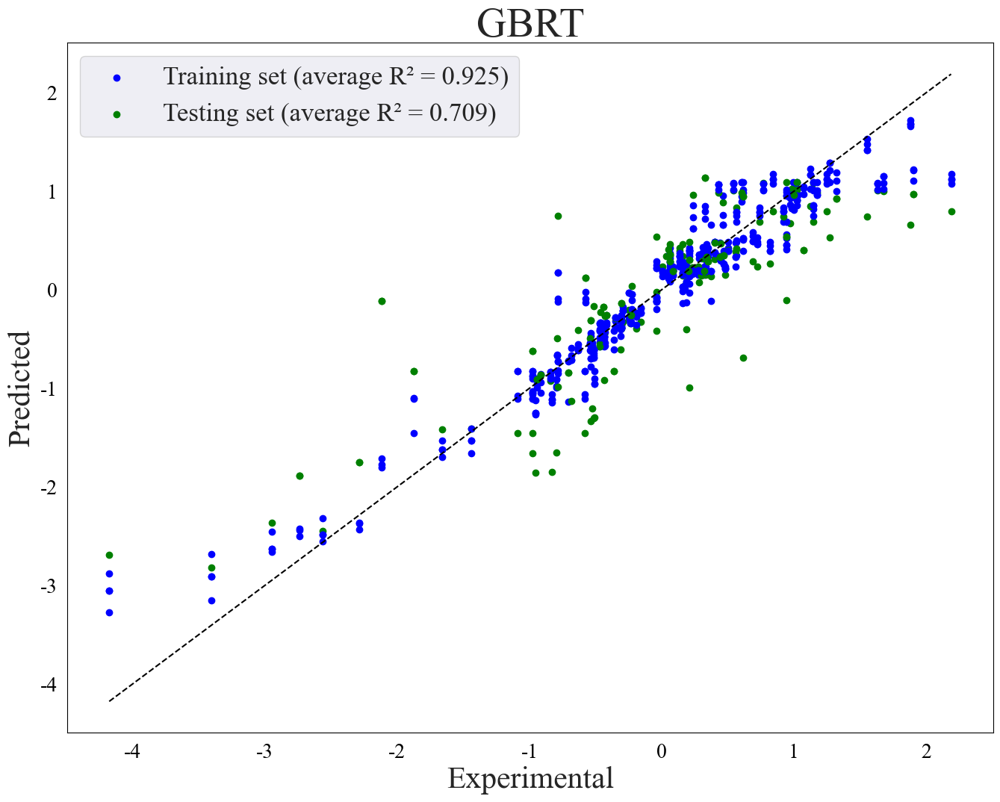

In [82]:

r2_train_gb = []
r2_test_gb = []
mae_train_gb = []
mae_test_gb = []
mse_train_gb = []
mse_test_gb = []
# 用于存储每个样本的预测值
predictions_gb = np.zeros(y_new.shape).reshape(-1,1)
plt.figure(figsize=(16, 12), facecolor='none')

# 存储所有折的SHAP值
all_shap_values = []
all_expected_values = []
all_X_val = []
shap_values_list_gb = []
fold = 0

plt.figure(figsize=(16, 12),facecolor='none')


kf = KFold(n_splits=k_num, shuffle=True, random_state=32)
for idx_train, idx_test in kf.split(X_new):
    X_train, X_test = X_new.iloc[idx_train], X_new.iloc[idx_test]
    y_train, y_test = y_new[idx_train], y_new[idx_test]

# 梯度提升回归器
    gb_model = GradientBoostingRegressor(**study_gb.best_params)

    gb_model.fit(X_train, y_train)
    y_test_pred_gb = gb_model.predict(X_test)
    y_train_pred_gb = gb_model.predict(X_train)
    gb_train_mse=mean_squared_error(y_train,y_train_pred_gb)
    gb_test_mse=mean_squared_error(y_test,y_test_pred_gb)
    gb_train_r2 = r2_score(y_train, y_train_pred_gb)
    gb_test_r2 = r2_score(y_test, y_test_pred_gb)
    gb_train_mae=mean_absolute_error(y_train, y_train_pred_gb)
    gb_test_mae=mean_absolute_error(y_test, y_test_pred_gb)

     # 将预测值保存到对应的位置
    # predictions[idx_train] = y_train_pred1.reshape(-1,1)
    predictions_gb[idx_test] = y_test_pred_gb.reshape(-1,1)
    r2_train_gb.append(gb_train_r2)
    r2_test_gb.append(gb_test_r2)
    mae_train_gb.append(gb_train_mae)
    mae_test_gb.append(gb_test_mae)
    mse_train_gb.append(gb_train_mse)
    mse_test_gb.append(gb_test_mse)



      # 计算 SHAP 值
    explainer = shap.TreeExplainer(gb_model)
    shap_values = explainer.shap_values(X_test)
    shap_values1 = explainer(X_test)
    all_X_val.append(idx_test)
    for SHAPs in shap_values:
        shap_values_list_gb.append(SHAPs)

    # 实际值与预测值的散点图
    plt.scatter(y_train, y_train_pred_gb, c='b')
    plt.scatter(y_test, y_test_pred_gb ,c= 'g')
    fold +=1

plt.scatter(y_train, y_train_pred_gb, c='b', label=f'Training set (average R² = {sum(r2_train_gb) / len(r2_train_gb):.3f})')
plt.scatter(y_test, y_test_pred_gb ,c= 'g' ,label=f'Testing set (average R² = {sum(r2_test_gb) / len(r2_test_gb):.3f})')

# 确定对角线的起止点
min_val = min(y_new)
max_val = max(y_new)
plt.rcParams['axes.unicode_minus'] = False

# 添加对角线，表示完美预测
plt.plot([min_val, max_val], [min_val, max_val], 'k--')

# 获取当前坐标轴
ax = plt.gca()

#隐藏右边和上边的边框
ax.spines['right'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_color('black')

# 设置坐标轴刻度样式
ax.tick_params(axis='both',       # 'x', 'y', 或 'both'
               which='major',     # 'both', 'major', 或 'minor'
               color='black',    # 刻度线的颜色
               labelcolor='black',
               direction = 'out',
                length = 6,       # 刻度线的长度
                width = 5,  # 刻度线颜色
                labelsize = 20  # 标签字体大小
               ) # 刻度标签的颜色

# 设置坐标轴背景颜色
ax.set_facecolor('none')
# 添加图例和标签
plt.grid(False)
plt.xlabel('Experimental',fontsize = 30)
plt.ylabel('Predicted',fontsize = 30)
plt.title('GBRT',fontsize = 40)
plt.legend(fontsize = 25)
plt.savefig('完美曲线_aveg_GB.png',dpi=1000)
# 显示图表
plt.show()


In [173]:

def object_cat_t1(trial):
    param = {
        'iterations': trial.suggest_int('iterations', 50, 500),
        'depth': trial.suggest_int('depth', 1, 12),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
        'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),
        'bootstrap_type': trial.suggest_categorical('bootstrap_type', ['Bayesian', 'Bernoulli', 'MVS']),
        'random_strength': trial.suggest_int('random_strength', 0, 100),
        'od_type': 'Iter',
        'od_wait': trial.suggest_int('od_wait', 10, 50)
    }
    # 根据bootstrap_type选择相应的参数
    if param['bootstrap_type'] == 'Bayesian':
        param['bagging_temperature'] = trial.suggest_float('bagging_temperature', 0.0, 10.0)
    elif param['bootstrap_type'] == 'Bernoulli':
        param['subsample'] = trial.suggest_float('subsample', 0.1, 1.0)

    cat_model = CatBoostRegressor(**param)

    kf = KFold(n_splits=k_num, shuffle=True,random_state=32)
    # scores = cross_val_score(xgb_model, X_new, y_new, cv=kf, scoring='neg_mean_squared_error')
    scores = cross_val_score(cat_model, X_new, y_new, cv=kf, scoring='r2')
    return scores.mean()


#t1预测
study1 = optuna.create_study(direction='maximize')
study1.optimize(object_cat_t1, n_trials=100)


[I 2025-02-22 20:31:31,069] A new study created in memory with name: no-name-ba2f4750-d39d-4ff2-8646-77fd2ea6e088
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0005701	total: 3.89ms	remaining: 439ms
1:	learn: 0.9637137	total: 4.59ms	remaining: 257ms
2:	learn: 0.9557273	total: 4.96ms	remaining: 184ms
3:	learn: 0.9201754	total: 5.37ms	remaining: 148ms
4:	learn: 0.9039800	total: 5.93ms	remaining: 129ms
5:	learn: 0.8698868	total: 6.35ms	remaining: 114ms
6:	learn: 0.8429890	total: 6.77ms	remaining: 104ms
7:	learn: 0.8265379	total: 7.21ms	remaining: 95.5ms
8:	learn: 0.7988232	total: 7.63ms	remaining: 89ms
9:	learn: 0.7736705	total: 8.07ms	remaining: 83.9ms
10:	learn: 0.7620263	total: 8.46ms	remaining: 79.2ms
11:	learn: 0.7401547	total: 8.88ms	remaining: 75.5ms
12:	learn: 0.7377646	total: 9.32ms	remaining: 72.4ms
13:	learn: 0.7215640	total: 9.8ms	remaining: 70ms
14:	learn: 0.7051409	total: 10.2ms	remaining: 67.2ms
15:	learn: 0.6869830	total: 10.6ms	remaining: 64.6ms
16:	learn: 0.6770168	total: 10.9ms	remaining: 62.3ms
17:	learn: 0.6737982	total: 11.3ms	remaining: 60.3ms
18:	learn: 0.6662928	total: 11.7ms	remaining: 58.3ms
19:	learn: 0.66

[I 2025-02-22 20:31:31,880] Trial 0 finished with value: 0.653908218868368 and parameters: {'iterations': 114, 'depth': 4, 'learning_rate': 0.1140349169361277, 'l2_leaf_reg': 3.385021039880682, 'bootstrap_type': 'Bernoulli', 'random_strength': 81, 'od_wait': 47, 'subsample': 0.1362791650534514}. Best is trial 0 with value: 0.653908218868368.


0:	learn: 0.9632501	total: 9.62ms	remaining: 1.09s
1:	learn: 0.9211980	total: 10.2ms	remaining: 571ms
2:	learn: 0.8878415	total: 10.6ms	remaining: 391ms
3:	learn: 0.8785349	total: 11ms	remaining: 303ms
4:	learn: 0.8415822	total: 11.5ms	remaining: 251ms
5:	learn: 0.8384921	total: 12.1ms	remaining: 217ms
6:	learn: 0.8080406	total: 12.4ms	remaining: 190ms
7:	learn: 0.8071357	total: 12.8ms	remaining: 169ms
8:	learn: 0.7808855	total: 13.2ms	remaining: 153ms
9:	learn: 0.7612335	total: 13.5ms	remaining: 141ms
10:	learn: 0.7594048	total: 14.2ms	remaining: 133ms
11:	learn: 0.7356067	total: 14.6ms	remaining: 124ms
12:	learn: 0.7193015	total: 14.9ms	remaining: 116ms
13:	learn: 0.7055394	total: 15.3ms	remaining: 109ms
14:	learn: 0.6950561	total: 15.6ms	remaining: 103ms
15:	learn: 0.6940091	total: 15.8ms	remaining: 96.9ms
16:	learn: 0.6850304	total: 16.2ms	remaining: 92.3ms
17:	learn: 0.6825156	total: 16.5ms	remaining: 88.2ms
18:	learn: 0.6667039	total: 16.9ms	remaining: 84.3ms
19:	learn: 0.6466550

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


27:	learn: 0.7979917	total: 38.7ms	remaining: 48.4ms
28:	learn: 0.7911268	total: 40.5ms	remaining: 47.5ms
29:	learn: 0.7856321	total: 42.1ms	remaining: 46.4ms
30:	learn: 0.7800651	total: 42.9ms	remaining: 44.3ms
31:	learn: 0.7711411	total: 44.4ms	remaining: 43ms
32:	learn: 0.7646736	total: 45.9ms	remaining: 41.7ms
33:	learn: 0.7564036	total: 47.5ms	remaining: 40.5ms
34:	learn: 0.7499284	total: 49.1ms	remaining: 39.3ms
35:	learn: 0.7404623	total: 50.8ms	remaining: 38.1ms
36:	learn: 0.7338327	total: 52.5ms	remaining: 36.9ms
37:	learn: 0.7284004	total: 54.1ms	remaining: 35.6ms
38:	learn: 0.7227708	total: 55.6ms	remaining: 34.2ms
39:	learn: 0.7154526	total: 57.1ms	remaining: 32.8ms
40:	learn: 0.7097459	total: 58.1ms	remaining: 31.2ms
41:	learn: 0.7021123	total: 59.8ms	remaining: 29.9ms
42:	learn: 0.6988004	total: 60.3ms	remaining: 28.1ms
43:	learn: 0.6937622	total: 61.1ms	remaining: 26.4ms
44:	learn: 0.6887643	total: 62.6ms	remaining: 25ms
45:	learn: 0.6823809	total: 64.2ms	remaining: 23.7

[I 2025-02-22 20:31:32,922] Trial 1 finished with value: 0.5173191259600687 and parameters: {'iterations': 63, 'depth': 9, 'learning_rate': 0.0163043938078955, 'l2_leaf_reg': 0.1091386892896542, 'bootstrap_type': 'Bayesian', 'random_strength': 32, 'od_wait': 34, 'bagging_temperature': 3.97053221738062}. Best is trial 0 with value: 0.653908218868368.


54:	learn: 0.5982226	total: 73.9ms	remaining: 10.7ms
55:	learn: 0.5947623	total: 74.9ms	remaining: 9.37ms
56:	learn: 0.5901689	total: 76.7ms	remaining: 8.07ms
57:	learn: 0.5857586	total: 78.3ms	remaining: 6.75ms
58:	learn: 0.5831792	total: 80ms	remaining: 5.42ms
59:	learn: 0.5771141	total: 81.6ms	remaining: 4.08ms
60:	learn: 0.5750389	total: 83.1ms	remaining: 2.73ms
61:	learn: 0.5724796	total: 83.8ms	remaining: 1.35ms
62:	learn: 0.5687512	total: 85.7ms	remaining: 0us
0:	learn: 1.0072291	total: 1.94ms	remaining: 120ms
1:	learn: 0.9952656	total: 3.47ms	remaining: 106ms
2:	learn: 0.9847793	total: 5.16ms	remaining: 103ms
3:	learn: 0.9743788	total: 6.71ms	remaining: 99ms
4:	learn: 0.9655718	total: 7.83ms	remaining: 90.8ms
5:	learn: 0.9567652	total: 8.63ms	remaining: 82ms
6:	learn: 0.9470495	total: 10.3ms	remaining: 82.6ms
7:	learn: 0.9399690	total: 11.1ms	remaining: 76ms
8:	learn: 0.9307121	total: 12.7ms	remaining: 76.4ms
9:	learn: 0.9207490	total: 14.4ms	remaining: 76.4ms
10:	learn: 0.9106

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


55:	learn: 1.0114242	total: 35.4ms	remaining: 263ms
56:	learn: 1.0108753	total: 36.3ms	remaining: 264ms
57:	learn: 1.0101251	total: 36.9ms	remaining: 264ms
58:	learn: 1.0091394	total: 37.5ms	remaining: 263ms
59:	learn: 1.0088242	total: 38.1ms	remaining: 262ms
60:	learn: 1.0083637	total: 38.9ms	remaining: 262ms
61:	learn: 1.0081742	total: 39.6ms	remaining: 262ms
62:	learn: 1.0078604	total: 40.3ms	remaining: 262ms
63:	learn: 1.0074980	total: 40.9ms	remaining: 261ms
64:	learn: 1.0064769	total: 41.6ms	remaining: 260ms
65:	learn: 1.0058734	total: 42.2ms	remaining: 259ms
66:	learn: 1.0053813	total: 42.7ms	remaining: 258ms
67:	learn: 1.0048663	total: 43.3ms	remaining: 257ms
68:	learn: 1.0045188	total: 43.9ms	remaining: 257ms
69:	learn: 1.0038555	total: 44.5ms	remaining: 255ms
70:	learn: 1.0030658	total: 45ms	remaining: 254ms
71:	learn: 1.0025449	total: 45.5ms	remaining: 253ms
72:	learn: 1.0024316	total: 46ms	remaining: 252ms
73:	learn: 1.0018819	total: 46.6ms	remaining: 251ms
74:	learn: 1.001

[I 2025-02-22 20:31:35,848] Trial 2 finished with value: 0.2902428364970429 and parameters: {'iterations': 472, 'depth': 6, 'learning_rate': 0.007533996358203449, 'l2_leaf_reg': 78.30096269848092, 'bootstrap_type': 'MVS', 'random_strength': 72, 'od_wait': 11}. Best is trial 0 with value: 0.653908218868368.


227:	learn: 0.8985119	total: 142ms	remaining: 151ms
228:	learn: 0.8982220	total: 143ms	remaining: 151ms
229:	learn: 0.8974878	total: 143ms	remaining: 151ms
230:	learn: 0.8967205	total: 144ms	remaining: 150ms
231:	learn: 0.8961635	total: 144ms	remaining: 149ms
232:	learn: 0.8961161	total: 145ms	remaining: 149ms
233:	learn: 0.8954973	total: 146ms	remaining: 148ms
234:	learn: 0.8949398	total: 146ms	remaining: 147ms
235:	learn: 0.8944018	total: 147ms	remaining: 147ms
236:	learn: 0.8940155	total: 147ms	remaining: 146ms
237:	learn: 0.8933812	total: 148ms	remaining: 146ms
238:	learn: 0.8927344	total: 149ms	remaining: 145ms
239:	learn: 0.8924253	total: 149ms	remaining: 144ms
240:	learn: 0.8919984	total: 150ms	remaining: 144ms
241:	learn: 0.8915586	total: 150ms	remaining: 143ms
242:	learn: 0.8910573	total: 151ms	remaining: 142ms
243:	learn: 0.8906216	total: 152ms	remaining: 142ms
244:	learn: 0.8899680	total: 152ms	remaining: 141ms
245:	learn: 0.8892682	total: 153ms	remaining: 141ms
246:	learn: 

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0447971	total: 1.15ms	remaining: 264ms
1:	learn: 1.0447570	total: 2.02ms	remaining: 231ms
2:	learn: 1.0446896	total: 2.86ms	remaining: 217ms
3:	learn: 1.0446384	total: 3.62ms	remaining: 205ms
4:	learn: 1.0445818	total: 4.32ms	remaining: 195ms
5:	learn: 1.0445290	total: 4.83ms	remaining: 181ms
6:	learn: 1.0445100	total: 5.35ms	remaining: 171ms
7:	learn: 1.0444677	total: 6.05ms	remaining: 169ms
8:	learn: 1.0444070	total: 7.02ms	remaining: 173ms
9:	learn: 1.0443890	total: 7.49ms	remaining: 166ms
10:	learn: 1.0443309	total: 8.28ms	remaining: 166ms
11:	learn: 1.0442733	total: 9.14ms	remaining: 167ms
12:	learn: 1.0442396	total: 9.52ms	remaining: 160ms
13:	learn: 1.0442176	total: 9.89ms	remaining: 153ms
14:	learn: 1.0441672	total: 10.8ms	remaining: 156ms
15:	learn: 1.0441174	total: 11.6ms	remaining: 156ms
16:	learn: 1.0440605	total: 12.4ms	remaining: 156ms
17:	learn: 1.0440408	total: 13.1ms	remaining: 155ms
18:	learn: 1.0439857	total: 13.8ms	remaining: 154ms
19:	learn: 1.0439671	t

[I 2025-02-22 20:31:37,829] Trial 3 finished with value: -0.04894921781039288 and parameters: {'iterations': 231, 'depth': 7, 'learning_rate': 0.00011079642285274552, 'l2_leaf_reg': 2.396167301840094, 'bootstrap_type': 'Bernoulli', 'random_strength': 57, 'od_wait': 48, 'subsample': 0.5622974606274007}. Best is trial 0 with value: 0.653908218868368.


212:	learn: 1.0084098	total: 206ms	remaining: 17.4ms
213:	learn: 1.0083582	total: 207ms	remaining: 16.5ms
214:	learn: 1.0083157	total: 208ms	remaining: 15.5ms
215:	learn: 1.0082612	total: 209ms	remaining: 14.5ms
216:	learn: 1.0082417	total: 210ms	remaining: 13.6ms
217:	learn: 1.0081852	total: 211ms	remaining: 12.6ms
218:	learn: 1.0081294	total: 212ms	remaining: 11.6ms
219:	learn: 1.0081011	total: 213ms	remaining: 10.6ms
220:	learn: 1.0080497	total: 213ms	remaining: 9.65ms
221:	learn: 1.0080019	total: 214ms	remaining: 8.69ms
222:	learn: 1.0079598	total: 215ms	remaining: 7.72ms
223:	learn: 1.0079306	total: 216ms	remaining: 6.76ms
224:	learn: 1.0078775	total: 217ms	remaining: 5.79ms
225:	learn: 1.0078260	total: 219ms	remaining: 4.84ms
226:	learn: 1.0077783	total: 220ms	remaining: 3.87ms
227:	learn: 1.0077246	total: 220ms	remaining: 2.9ms
228:	learn: 1.0076807	total: 221ms	remaining: 1.93ms
229:	learn: 1.0076287	total: 222ms	remaining: 966us
230:	learn: 1.0075752	total: 224ms	remaining: 0u

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


31:	learn: 1.0060382	total: 151ms	remaining: 858ms
32:	learn: 1.0045725	total: 161ms	remaining: 882ms
33:	learn: 1.0034617	total: 162ms	remaining: 860ms
34:	learn: 1.0029518	total: 163ms	remaining: 834ms
35:	learn: 1.0017834	total: 169ms	remaining: 833ms
36:	learn: 1.0015335	total: 169ms	remaining: 809ms
37:	learn: 1.0000552	total: 179ms	remaining: 829ms
38:	learn: 0.9991673	total: 180ms	remaining: 808ms
39:	learn: 0.9976922	total: 190ms	remaining: 828ms
40:	learn: 0.9966435	total: 191ms	remaining: 806ms
41:	learn: 0.9954631	total: 194ms	remaining: 793ms
42:	learn: 0.9942853	total: 196ms	remaining: 779ms
43:	learn: 0.9937457	total: 196ms	remaining: 758ms
44:	learn: 0.9922611	total: 206ms	remaining: 775ms
45:	learn: 0.9911149	total: 210ms	remaining: 766ms
46:	learn: 0.9900908	total: 216ms	remaining: 766ms
47:	learn: 0.9887409	total: 222ms	remaining: 766ms
48:	learn: 0.9872414	total: 232ms	remaining: 782ms
49:	learn: 0.9859479	total: 234ms	remaining: 766ms
50:	learn: 0.9845894	total: 237

[I 2025-02-22 20:31:46,179] Trial 4 finished with value: 0.29172827211774677 and parameters: {'iterations': 214, 'depth': 11, 'learning_rate': 0.002074290952075484, 'l2_leaf_reg': 0.19403220347169023, 'bootstrap_type': 'MVS', 'random_strength': 100, 'od_wait': 49}. Best is trial 0 with value: 0.653908218868368.


204:	learn: 0.8028226	total: 786ms	remaining: 34.5ms
205:	learn: 0.8016529	total: 794ms	remaining: 30.9ms
206:	learn: 0.8004115	total: 803ms	remaining: 27.2ms
207:	learn: 0.7994866	total: 807ms	remaining: 23.3ms
208:	learn: 0.7991134	total: 810ms	remaining: 19.4ms
209:	learn: 0.7983961	total: 810ms	remaining: 15.4ms
210:	learn: 0.7973218	total: 818ms	remaining: 11.6ms
211:	learn: 0.7963607	total: 826ms	remaining: 7.79ms
212:	learn: 0.7953447	total: 834ms	remaining: 3.92ms
213:	learn: 0.7942200	total: 842ms	remaining: 0us
0:	learn: 1.0406227	total: 1.38ms	remaining: 407ms
1:	learn: 1.0349880	total: 2.6ms	remaining: 383ms
2:	learn: 1.0254925	total: 3.7ms	remaining: 361ms
3:	learn: 1.0214355	total: 4.73ms	remaining: 345ms
4:	learn: 1.0197618	total: 5.26ms	remaining: 306ms
5:	learn: 1.0137340	total: 6.45ms	remaining: 312ms
6:	learn: 1.0060490	total: 7.47ms	remaining: 308ms
7:	learn: 1.0019699	total: 8.5ms	remaining: 306ms
8:	learn: 0.9926066	total: 9.41ms	remaining: 300ms
9:	learn: 0.98725

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


85:	learn: 0.6708872	total: 87.2ms	remaining: 213ms
86:	learn: 0.6663127	total: 87.6ms	remaining: 210ms
87:	learn: 0.6640417	total: 88.7ms	remaining: 210ms
88:	learn: 0.6619589	total: 89.9ms	remaining: 209ms
89:	learn: 0.6593303	total: 91.2ms	remaining: 209ms
90:	learn: 0.6581536	total: 92.3ms	remaining: 208ms
91:	learn: 0.6551974	total: 93.4ms	remaining: 207ms
92:	learn: 0.6525793	total: 94.1ms	remaining: 205ms
93:	learn: 0.6498304	total: 95.4ms	remaining: 205ms
94:	learn: 0.6475557	total: 96.6ms	remaining: 204ms
95:	learn: 0.6457308	total: 97.6ms	remaining: 203ms
96:	learn: 0.6436787	total: 98.6ms	remaining: 202ms
97:	learn: 0.6417562	total: 99.8ms	remaining: 202ms
98:	learn: 0.6403705	total: 101ms	remaining: 201ms
99:	learn: 0.6384842	total: 102ms	remaining: 200ms
100:	learn: 0.6365003	total: 103ms	remaining: 199ms
101:	learn: 0.6344651	total: 103ms	remaining: 197ms
102:	learn: 0.6328961	total: 105ms	remaining: 196ms
103:	learn: 0.6307851	total: 106ms	remaining: 196ms
104:	learn: 0.

[I 2025-02-22 20:31:49,059] Trial 5 finished with value: 0.6295251898220406 and parameters: {'iterations': 296, 'depth': 8, 'learning_rate': 0.07088315643448352, 'l2_leaf_reg': 51.42146216515321, 'bootstrap_type': 'MVS', 'random_strength': 39, 'od_wait': 41}. Best is trial 0 with value: 0.653908218868368.


252:	learn: 0.4280519	total: 262ms	remaining: 44.6ms
253:	learn: 0.4264959	total: 264ms	remaining: 43.6ms
254:	learn: 0.4246456	total: 265ms	remaining: 42.6ms
255:	learn: 0.4243689	total: 266ms	remaining: 41.5ms
256:	learn: 0.4239493	total: 267ms	remaining: 40.5ms
257:	learn: 0.4236637	total: 268ms	remaining: 39.4ms
258:	learn: 0.4232861	total: 268ms	remaining: 38.3ms
259:	learn: 0.4230055	total: 269ms	remaining: 37.3ms
260:	learn: 0.4218316	total: 270ms	remaining: 36.2ms
261:	learn: 0.4202734	total: 272ms	remaining: 35.3ms
262:	learn: 0.4200073	total: 272ms	remaining: 34.2ms
263:	learn: 0.4197451	total: 273ms	remaining: 33.1ms
264:	learn: 0.4193704	total: 274ms	remaining: 32ms
265:	learn: 0.4182561	total: 275ms	remaining: 31ms
266:	learn: 0.4177785	total: 276ms	remaining: 30ms
267:	learn: 0.4169543	total: 277ms	remaining: 28.9ms
268:	learn: 0.4166740	total: 278ms	remaining: 27.9ms
269:	learn: 0.4164031	total: 278ms	remaining: 26.8ms
270:	learn: 0.4151869	total: 279ms	remaining: 25.8ms

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


17:	learn: 0.9674866	total: 114ms	remaining: 2.86s
18:	learn: 0.9644943	total: 117ms	remaining: 2.78s
19:	learn: 0.9582907	total: 117ms	remaining: 2.65s
20:	learn: 0.9562573	total: 134ms	remaining: 2.87s
21:	learn: 0.9524749	total: 135ms	remaining: 2.76s
22:	learn: 0.9518372	total: 135ms	remaining: 2.64s
23:	learn: 0.9497425	total: 137ms	remaining: 2.55s
24:	learn: 0.9452759	total: 139ms	remaining: 2.47s
25:	learn: 0.9415841	total: 141ms	remaining: 2.42s
26:	learn: 0.9393467	total: 150ms	remaining: 2.46s
27:	learn: 0.9349164	total: 151ms	remaining: 2.39s
28:	learn: 0.9325623	total: 159ms	remaining: 2.43s
29:	learn: 0.9290628	total: 164ms	remaining: 2.41s
30:	learn: 0.9261763	total: 168ms	remaining: 2.38s
31:	learn: 0.9231122	total: 185ms	remaining: 2.53s
32:	learn: 0.9207143	total: 189ms	remaining: 2.5s
33:	learn: 0.9178836	total: 190ms	remaining: 2.44s
34:	learn: 0.9154715	total: 194ms	remaining: 2.42s
35:	learn: 0.9120266	total: 197ms	remaining: 2.37s
36:	learn: 0.9086790	total: 206m

[I 2025-02-22 20:32:34,669] Trial 6 finished with value: 0.5864239669063542 and parameters: {'iterations': 471, 'depth': 12, 'learning_rate': 0.06478162846088074, 'l2_leaf_reg': 96.20008742102205, 'bootstrap_type': 'Bernoulli', 'random_strength': 34, 'od_wait': 47, 'subsample': 0.25348029953165246}. Best is trial 0 with value: 0.653908218868368.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_logunifo

0:	learn: 1.0419654	total: 1.14ms	remaining: 493ms
1:	learn: 1.0380050	total: 2.36ms	remaining: 510ms
2:	learn: 1.0349815	total: 3.24ms	remaining: 466ms
3:	learn: 1.0309624	total: 4.16ms	remaining: 447ms
4:	learn: 1.0274953	total: 5.53ms	remaining: 474ms
5:	learn: 1.0236057	total: 6.38ms	remaining: 455ms
6:	learn: 1.0207804	total: 7.24ms	remaining: 442ms
7:	learn: 1.0189363	total: 7.98ms	remaining: 425ms
8:	learn: 1.0158605	total: 8.83ms	remaining: 417ms
9:	learn: 1.0155656	total: 9.11ms	remaining: 386ms
10:	learn: 1.0115140	total: 9.98ms	remaining: 384ms
11:	learn: 1.0078075	total: 10.9ms	remaining: 384ms
12:	learn: 1.0041134	total: 11.5ms	remaining: 372ms
13:	learn: 0.9994652	total: 12.4ms	remaining: 372ms
14:	learn: 0.9961134	total: 13.3ms	remaining: 370ms
15:	learn: 0.9940521	total: 14.5ms	remaining: 379ms
16:	learn: 0.9915981	total: 16ms	remaining: 391ms
17:	learn: 0.9895744	total: 17ms	remaining: 392ms
18:	learn: 0.9889248	total: 17.9ms	remaining: 390ms
19:	learn: 0.9867922	total

[I 2025-02-22 20:32:37,625] Trial 7 finished with value: 0.5801201721114132 and parameters: {'iterations': 434, 'depth': 6, 'learning_rate': 0.019340356330612082, 'l2_leaf_reg': 24.64927013269361, 'bootstrap_type': 'Bernoulli', 'random_strength': 28, 'od_wait': 22, 'subsample': 0.4697598738126132}. Best is trial 0 with value: 0.653908218868368.


363:	learn: 0.5307254	total: 269ms	remaining: 51.8ms
364:	learn: 0.5302239	total: 270ms	remaining: 51.1ms
365:	learn: 0.5298434	total: 271ms	remaining: 50.3ms
366:	learn: 0.5291125	total: 272ms	remaining: 49.6ms
367:	learn: 0.5282965	total: 272ms	remaining: 48.8ms
368:	learn: 0.5278228	total: 273ms	remaining: 48.1ms
369:	learn: 0.5271647	total: 274ms	remaining: 47.4ms
370:	learn: 0.5265939	total: 274ms	remaining: 46.6ms
371:	learn: 0.5259586	total: 275ms	remaining: 45.8ms
372:	learn: 0.5252798	total: 276ms	remaining: 45.1ms
373:	learn: 0.5246223	total: 276ms	remaining: 44.3ms
374:	learn: 0.5241607	total: 277ms	remaining: 43.6ms
375:	learn: 0.5237057	total: 278ms	remaining: 42.8ms
376:	learn: 0.5232262	total: 278ms	remaining: 42.1ms
377:	learn: 0.5224780	total: 279ms	remaining: 41.3ms
378:	learn: 0.5221592	total: 279ms	remaining: 40.6ms
379:	learn: 0.5214262	total: 280ms	remaining: 39.8ms
380:	learn: 0.5207958	total: 281ms	remaining: 39ms
381:	learn: 0.5203078	total: 281ms	remaining: 38

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


29:	learn: 0.1677236	total: 119ms	remaining: 549ms
30:	learn: 0.1589440	total: 127ms	remaining: 561ms
31:	learn: 0.1512824	total: 130ms	remaining: 551ms
32:	learn: 0.1321030	total: 136ms	remaining: 558ms
33:	learn: 0.1256619	total: 143ms	remaining: 563ms
34:	learn: 0.1120808	total: 149ms	remaining: 566ms
35:	learn: 0.1061447	total: 156ms	remaining: 571ms
36:	learn: 0.0951560	total: 163ms	remaining: 578ms
37:	learn: 0.0888812	total: 170ms	remaining: 582ms
38:	learn: 0.0775514	total: 175ms	remaining: 580ms
39:	learn: 0.0707855	total: 181ms	remaining: 580ms
40:	learn: 0.0649439	total: 186ms	remaining: 577ms
41:	learn: 0.0589766	total: 191ms	remaining: 574ms
42:	learn: 0.0539023	total: 196ms	remaining: 571ms
43:	learn: 0.0500550	total: 201ms	remaining: 567ms
44:	learn: 0.0452749	total: 207ms	remaining: 565ms
45:	learn: 0.0412222	total: 213ms	remaining: 564ms
46:	learn: 0.0383441	total: 218ms	remaining: 562ms
47:	learn: 0.0360330	total: 224ms	remaining: 561ms
48:	learn: 0.0333700	total: 230

[I 2025-02-22 20:32:45,619] Trial 8 finished with value: 0.7044898778614572 and parameters: {'iterations': 168, 'depth': 10, 'learning_rate': 0.2999581100568433, 'l2_leaf_reg': 0.6308946870771144, 'bootstrap_type': 'Bernoulli', 'random_strength': 35, 'od_wait': 42, 'subsample': 0.9622919343583286}. Best is trial 8 with value: 0.7044898778614572.


167:	learn: 0.0000953	total: 885ms	remaining: 0us
0:	learn: 0.9544881	total: 1.94ms	remaining: 472ms
1:	learn: 0.8587775	total: 3.34ms	remaining: 404ms
2:	learn: 0.7801266	total: 4.7ms	remaining: 378ms
3:	learn: 0.7108073	total: 6.11ms	remaining: 366ms
4:	learn: 0.6972081	total: 6.86ms	remaining: 328ms
5:	learn: 0.6465593	total: 8.5ms	remaining: 337ms
6:	learn: 0.6054121	total: 9.89ms	remaining: 335ms
7:	learn: 0.5795608	total: 11.3ms	remaining: 332ms
8:	learn: 0.5465762	total: 12.6ms	remaining: 329ms
9:	learn: 0.5258101	total: 13.9ms	remaining: 324ms
10:	learn: 0.4935906	total: 15ms	remaining: 318ms
11:	learn: 0.4786977	total: 16.4ms	remaining: 318ms
12:	learn: 0.4615056	total: 18ms	remaining: 320ms
13:	learn: 0.4335574	total: 19.4ms	remaining: 319ms
14:	learn: 0.4132601	total: 20.8ms	remaining: 317ms
15:	learn: 0.4007224	total: 22.2ms	remaining: 316ms
16:	learn: 0.3763103	total: 23.5ms	remaining: 314ms
17:	learn: 0.3703021	total: 24.1ms	remaining: 303ms
18:	learn: 0.3634768	total: 25

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


97:	learn: 0.0431411	total: 133ms	remaining: 198ms
98:	learn: 0.0416615	total: 135ms	remaining: 198ms
99:	learn: 0.0399351	total: 137ms	remaining: 197ms
100:	learn: 0.0378438	total: 139ms	remaining: 196ms
101:	learn: 0.0367314	total: 140ms	remaining: 195ms
102:	learn: 0.0354252	total: 142ms	remaining: 194ms
103:	learn: 0.0344972	total: 143ms	remaining: 193ms
104:	learn: 0.0336165	total: 145ms	remaining: 192ms
105:	learn: 0.0325137	total: 146ms	remaining: 190ms
106:	learn: 0.0312415	total: 148ms	remaining: 189ms
107:	learn: 0.0306613	total: 149ms	remaining: 188ms
108:	learn: 0.0296208	total: 151ms	remaining: 187ms
109:	learn: 0.0284489	total: 152ms	remaining: 186ms
110:	learn: 0.0278395	total: 154ms	remaining: 185ms
111:	learn: 0.0271828	total: 156ms	remaining: 183ms
112:	learn: 0.0265155	total: 157ms	remaining: 182ms
113:	learn: 0.0256333	total: 158ms	remaining: 181ms
114:	learn: 0.0255092	total: 160ms	remaining: 179ms
115:	learn: 0.0249921	total: 162ms	remaining: 179ms
116:	learn: 0.0

[I 2025-02-22 20:32:48,754] Trial 9 finished with value: 0.7214126819740787 and parameters: {'iterations': 244, 'depth': 8, 'learning_rate': 0.1456494844541249, 'l2_leaf_reg': 0.42376252367910416, 'bootstrap_type': 'MVS', 'random_strength': 10, 'od_wait': 43}. Best is trial 9 with value: 0.7214126819740787.


238:	learn: 0.0025497	total: 327ms	remaining: 6.83ms
239:	learn: 0.0025324	total: 328ms	remaining: 5.47ms
240:	learn: 0.0024839	total: 330ms	remaining: 4.1ms
241:	learn: 0.0024597	total: 331ms	remaining: 2.74ms
242:	learn: 0.0024171	total: 332ms	remaining: 1.37ms
243:	learn: 0.0023666	total: 334ms	remaining: 0us
0:	learn: 1.0447960	total: 19.6ms	remaining: 6.64s
1:	learn: 1.0442434	total: 19.8ms	remaining: 3.35s
2:	learn: 1.0438864	total: 20ms	remaining: 2.25s
3:	learn: 1.0437894	total: 20.2ms	remaining: 1.7s
4:	learn: 1.0436673	total: 20.4ms	remaining: 1.37s
5:	learn: 1.0431160	total: 20.6ms	remaining: 1.15s
6:	learn: 1.0429396	total: 20.8ms	remaining: 990ms
7:	learn: 1.0424146	total: 21ms	remaining: 871ms
8:	learn: 1.0418648	total: 21.2ms	remaining: 778ms
9:	learn: 1.0417943	total: 21.3ms	remaining: 703ms
10:	learn: 1.0416719	total: 21.5ms	remaining: 642ms
11:	learn: 1.0412575	total: 21.7ms	remaining: 594ms
12:	learn: 1.0408140	total: 21.9ms	remaining: 552ms
13:	learn: 1.0406381	tota

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0366582	total: 368us	remaining: 125ms
1:	learn: 1.0361382	total: 1.15ms	remaining: 194ms
2:	learn: 1.0357757	total: 1.33ms	remaining: 150ms
3:	learn: 1.0354634	total: 1.51ms	remaining: 127ms
4:	learn: 1.0350193	total: 1.67ms	remaining: 112ms
5:	learn: 1.0347971	total: 1.84ms	remaining: 102ms
6:	learn: 1.0347967	total: 1.99ms	remaining: 94.9ms
7:	learn: 1.0343537	total: 2.16ms	remaining: 89.8ms
8:	learn: 1.0341916	total: 2.34ms	remaining: 86.1ms
9:	learn: 1.0340761	total: 2.49ms	remaining: 82.3ms
10:	learn: 1.0340724	total: 2.64ms	remaining: 78.8ms
11:	learn: 1.0335559	total: 2.77ms	remaining: 75.8ms
12:	learn: 1.0334385	total: 2.94ms	remaining: 74.1ms
13:	learn: 1.0329971	total: 3.09ms	remaining: 72ms
14:	learn: 1.0326743	total: 3.24ms	remaining: 70.1ms
15:	learn: 1.0326717	total: 3.38ms	remaining: 68.5ms
16:	learn: 1.0326392	total: 3.52ms	remaining: 67ms
17:	learn: 1.0324762	total: 3.67ms	remaining: 65.7ms
18:	learn: 1.0320361	total: 3.81ms	remaining: 64.4ms
19:	learn: 1.0

[I 2025-02-22 20:32:49,749] Trial 10 finished with value: 0.07119748228609038 and parameters: {'iterations': 340, 'depth': 1, 'learning_rate': 0.0010872668102807734, 'l2_leaf_reg': 0.9646563126084143, 'bootstrap_type': 'Bayesian', 'random_strength': 1, 'od_wait': 31, 'bagging_temperature': 9.845760883580237}. Best is trial 9 with value: 0.7214126819740787.


0:	learn: 1.0177857	total: 398us	remaining: 135ms
1:	learn: 1.0175819	total: 824us	remaining: 139ms
2:	learn: 1.0174942	total: 991us	remaining: 111ms
3:	learn: 1.0171203	total: 1.17ms	remaining: 98.1ms
4:	learn: 1.0166743	total: 1.34ms	remaining: 89.8ms
5:	learn: 1.0161319	total: 1.5ms	remaining: 83.4ms
6:	learn: 1.0161311	total: 1.66ms	remaining: 78.8ms
7:	learn: 1.0155895	total: 1.82ms	remaining: 75.4ms
8:	learn: 1.0152176	total: 1.98ms	remaining: 72.8ms
9:	learn: 1.0151384	total: 2.14ms	remaining: 70.6ms
10:	learn: 1.0151251	total: 2.29ms	remaining: 68.7ms
11:	learn: 1.0150657	total: 2.51ms	remaining: 68.6ms
12:	learn: 1.0147722	total: 2.7ms	remaining: 67.9ms
13:	learn: 1.0145036	total: 2.86ms	remaining: 66.6ms
14:	learn: 1.0142174	total: 3.02ms	remaining: 65.5ms
15:	learn: 1.0141378	total: 3.19ms	remaining: 64.5ms
16:	learn: 1.0140169	total: 3.34ms	remaining: 63.5ms
17:	learn: 1.0137825	total: 3.49ms	remaining: 62.5ms
18:	learn: 1.0133321	total: 3.65ms	remaining: 61.7ms
19:	learn: 

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


10:	learn: 0.2699198	total: 68.9ms	remaining: 946ms
11:	learn: 0.2507446	total: 70.1ms	remaining: 877ms
12:	learn: 0.2426090	total: 76.8ms	remaining: 881ms
13:	learn: 0.2396080	total: 82.8ms	remaining: 876ms
14:	learn: 0.2358341	total: 85.5ms	remaining: 838ms
15:	learn: 0.2327582	total: 89.8ms	remaining: 819ms
16:	learn: 0.2321462	total: 91.5ms	remaining: 781ms
17:	learn: 0.2248822	total: 97.6ms	remaining: 781ms
18:	learn: 0.2200120	total: 102ms	remaining: 766ms
19:	learn: 0.2145265	total: 108ms	remaining: 769ms
20:	learn: 0.2042914	total: 110ms	remaining: 740ms
21:	learn: 0.1923691	total: 117ms	remaining: 742ms
22:	learn: 0.1710276	total: 123ms	remaining: 740ms
23:	learn: 0.1623491	total: 129ms	remaining: 741ms
24:	learn: 0.1481662	total: 135ms	remaining: 737ms
25:	learn: 0.1455277	total: 135ms	remaining: 707ms
26:	learn: 0.1420426	total: 138ms	remaining: 688ms
27:	learn: 0.1327222	total: 143ms	remaining: 683ms
28:	learn: 0.1137185	total: 148ms	remaining: 680ms
29:	learn: 0.1046550	to

[I 2025-02-22 20:32:58,137] Trial 11 finished with value: 0.7009754770622842 and parameters: {'iterations': 162, 'depth': 10, 'learning_rate': 0.31181396766547187, 'l2_leaf_reg': 0.4854428598596389, 'bootstrap_type': 'MVS', 'random_strength': 6, 'od_wait': 40}. Best is trial 9 with value: 0.7214126819740787.


138:	learn: 0.0001702	total: 845ms	remaining: 140ms
139:	learn: 0.0001630	total: 851ms	remaining: 134ms
140:	learn: 0.0001553	total: 858ms	remaining: 128ms
141:	learn: 0.0001550	total: 858ms	remaining: 121ms
142:	learn: 0.0001483	total: 864ms	remaining: 115ms
143:	learn: 0.0001417	total: 871ms	remaining: 109ms
144:	learn: 0.0001345	total: 876ms	remaining: 103ms
145:	learn: 0.0001343	total: 877ms	remaining: 96.1ms
146:	learn: 0.0001257	total: 883ms	remaining: 90.1ms
147:	learn: 0.0001224	total: 889ms	remaining: 84.1ms
148:	learn: 0.0001128	total: 895ms	remaining: 78ms
149:	learn: 0.0001070	total: 901ms	remaining: 72.1ms
150:	learn: 0.0001008	total: 907ms	remaining: 66ms
151:	learn: 0.0000936	total: 913ms	remaining: 60ms
152:	learn: 0.0000884	total: 919ms	remaining: 54ms
153:	learn: 0.0000861	total: 925ms	remaining: 48ms
154:	learn: 0.0000826	total: 932ms	remaining: 42.1ms
155:	learn: 0.0000788	total: 938ms	remaining: 36.1ms
156:	learn: 0.0000773	total: 942ms	remaining: 30ms
157:	learn: 

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.7934282	total: 1.84ms	remaining: 338ms
1:	learn: 0.6825157	total: 4.57ms	remaining: 416ms
2:	learn: 0.5809105	total: 6.73ms	remaining: 406ms
3:	learn: 0.5346576	total: 7.36ms	remaining: 331ms
4:	learn: 0.4967293	total: 9.56ms	remaining: 342ms
5:	learn: 0.4408701	total: 11.7ms	remaining: 346ms
6:	learn: 0.4249160	total: 13.9ms	remaining: 351ms
7:	learn: 0.4074848	total: 16ms	remaining: 351ms
8:	learn: 0.3884084	total: 18.1ms	remaining: 352ms
9:	learn: 0.3776260	total: 20.1ms	remaining: 350ms
10:	learn: 0.3317738	total: 22.3ms	remaining: 351ms
11:	learn: 0.3090923	total: 24.4ms	remaining: 350ms
12:	learn: 0.2963695	total: 25.8ms	remaining: 339ms
13:	learn: 0.2956523	total: 26.5ms	remaining: 322ms
14:	learn: 0.2686671	total: 28.6ms	remaining: 323ms
15:	learn: 0.2604237	total: 30.6ms	remaining: 322ms
16:	learn: 0.2568717	total: 31.8ms	remaining: 312ms
17:	learn: 0.2437245	total: 34.2ms	remaining: 316ms
18:	learn: 0.2313726	total: 36.4ms	remaining: 316ms
19:	learn: 0.2277464	tot

[I 2025-02-22 20:33:01,622] Trial 12 finished with value: 0.711199887065614 and parameters: {'iterations': 184, 'depth': 9, 'learning_rate': 0.3417441901690833, 'l2_leaf_reg': 0.5317690342656418, 'bootstrap_type': 'Bernoulli', 'random_strength': 13, 'od_wait': 38, 'subsample': 0.9131722054920601}. Best is trial 9 with value: 0.7214126819740787.


127:	learn: 0.0006540	total: 280ms	remaining: 122ms
128:	learn: 0.0006432	total: 282ms	remaining: 120ms
129:	learn: 0.0006293	total: 285ms	remaining: 118ms
130:	learn: 0.0006099	total: 287ms	remaining: 116ms
131:	learn: 0.0005817	total: 289ms	remaining: 114ms
132:	learn: 0.0005540	total: 291ms	remaining: 112ms
133:	learn: 0.0005285	total: 293ms	remaining: 109ms
134:	learn: 0.0005158	total: 295ms	remaining: 107ms
135:	learn: 0.0004936	total: 297ms	remaining: 105ms
136:	learn: 0.0004569	total: 300ms	remaining: 103ms
137:	learn: 0.0004331	total: 302ms	remaining: 101ms
138:	learn: 0.0004156	total: 304ms	remaining: 98.3ms
139:	learn: 0.0003957	total: 306ms	remaining: 96.1ms
140:	learn: 0.0003772	total: 308ms	remaining: 93.9ms
141:	learn: 0.0003659	total: 310ms	remaining: 91.7ms
142:	learn: 0.0003645	total: 311ms	remaining: 89.1ms
143:	learn: 0.0003522	total: 313ms	remaining: 86.9ms
144:	learn: 0.0003389	total: 315ms	remaining: 84.7ms
145:	learn: 0.0003292	total: 317ms	remaining: 82.5ms
146:

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


25:	learn: 0.5010982	total: 18.4ms	remaining: 231ms
26:	learn: 0.4908753	total: 19ms	remaining: 229ms
27:	learn: 0.4663298	total: 19.4ms	remaining: 224ms
28:	learn: 0.4531113	total: 19.7ms	remaining: 220ms
29:	learn: 0.4355410	total: 20.1ms	remaining: 216ms
30:	learn: 0.4183056	total: 20.4ms	remaining: 212ms
31:	learn: 0.4078813	total: 20.8ms	remaining: 208ms
32:	learn: 0.3960796	total: 21.2ms	remaining: 205ms
33:	learn: 0.3896147	total: 21.5ms	remaining: 201ms
34:	learn: 0.3870641	total: 21.9ms	remaining: 199ms
35:	learn: 0.3760492	total: 22.3ms	remaining: 196ms
36:	learn: 0.3685387	total: 22.7ms	remaining: 194ms
37:	learn: 0.3661983	total: 23.1ms	remaining: 191ms
38:	learn: 0.3635327	total: 23.5ms	remaining: 189ms
39:	learn: 0.3615115	total: 23.9ms	remaining: 187ms
40:	learn: 0.3561350	total: 24.3ms	remaining: 185ms
41:	learn: 0.3480314	total: 24.8ms	remaining: 183ms
42:	learn: 0.3458828	total: 25.2ms	remaining: 181ms
43:	learn: 0.3441469	total: 25.5ms	remaining: 179ms
44:	learn: 0.3

[I 2025-02-22 20:33:03,562] Trial 13 finished with value: 0.6507438675092648 and parameters: {'iterations': 352, 'depth': 4, 'learning_rate': 0.25530325332197007, 'l2_leaf_reg': 4.317219192038112, 'bootstrap_type': 'MVS', 'random_strength': 15, 'od_wait': 26}. Best is trial 9 with value: 0.7214126819740787.


35:	learn: 0.3559126	total: 18.1ms	remaining: 159ms
36:	learn: 0.3485660	total: 18.9ms	remaining: 161ms
37:	learn: 0.3436708	total: 19.4ms	remaining: 160ms
38:	learn: 0.3388142	total: 19.9ms	remaining: 160ms
39:	learn: 0.3343405	total: 20.4ms	remaining: 159ms
40:	learn: 0.3276290	total: 20.9ms	remaining: 159ms
41:	learn: 0.3195939	total: 21.4ms	remaining: 158ms
42:	learn: 0.3155134	total: 22ms	remaining: 158ms
43:	learn: 0.3111039	total: 22.5ms	remaining: 157ms
44:	learn: 0.3076571	total: 23ms	remaining: 157ms
45:	learn: 0.3045195	total: 23.5ms	remaining: 156ms
46:	learn: 0.3007328	total: 23.9ms	remaining: 155ms
47:	learn: 0.2988503	total: 24.4ms	remaining: 155ms
48:	learn: 0.2963868	total: 25ms	remaining: 154ms
49:	learn: 0.2944317	total: 25.5ms	remaining: 154ms
50:	learn: 0.2902213	total: 26ms	remaining: 153ms
51:	learn: 0.2881845	total: 26.4ms	remaining: 152ms
52:	learn: 0.2856977	total: 26.9ms	remaining: 152ms
53:	learn: 0.2851446	total: 27.4ms	remaining: 151ms
54:	learn: 0.2755167

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0238747	total: 1.5ms	remaining: 399ms
1:	learn: 1.0027998	total: 3.06ms	remaining: 404ms
2:	learn: 0.9795166	total: 4.37ms	remaining: 384ms
3:	learn: 0.9579669	total: 5.54ms	remaining: 363ms
4:	learn: 0.9534467	total: 6.19ms	remaining: 323ms
5:	learn: 0.9334204	total: 7.47ms	remaining: 324ms
6:	learn: 0.9158897	total: 8.92ms	remaining: 330ms
7:	learn: 0.9021651	total: 10.7ms	remaining: 346ms
8:	learn: 0.8849187	total: 13ms	remaining: 371ms
9:	learn: 0.8720306	total: 14.7ms	remaining: 377ms
10:	learn: 0.8542834	total: 15.9ms	remaining: 368ms
11:	learn: 0.8414015	total: 17.5ms	remaining: 369ms
12:	learn: 0.8293472	total: 19ms	remaining: 370ms
13:	learn: 0.8153787	total: 20.8ms	remaining: 374ms
14:	learn: 0.7987859	total: 22.5ms	remaining: 376ms
15:	learn: 0.7851905	total: 25ms	remaining: 391ms
16:	learn: 0.7687096	total: 27.2ms	remaining: 399ms
17:	learn: 0.7595741	total: 28.3ms	remaining: 390ms
18:	learn: 0.7482662	total: 30.1ms	remaining: 391ms
19:	learn: 0.7375556	total: 3

[I 2025-02-22 20:33:07,007] Trial 14 finished with value: 0.7285019155267447 and parameters: {'iterations': 266, 'depth': 8, 'learning_rate': 0.03232185229931889, 'l2_leaf_reg': 0.3302264739758669, 'bootstrap_type': 'Bayesian', 'random_strength': 11, 'od_wait': 36, 'bagging_temperature': 1.073803672300179}. Best is trial 14 with value: 0.7285019155267447.


189:	learn: 0.2740463	total: 230ms	remaining: 92ms
190:	learn: 0.2724372	total: 232ms	remaining: 90.9ms
191:	learn: 0.2722789	total: 233ms	remaining: 89.8ms
192:	learn: 0.2722736	total: 233ms	remaining: 88.2ms
193:	learn: 0.2712368	total: 235ms	remaining: 87ms
194:	learn: 0.2687953	total: 236ms	remaining: 85.9ms
195:	learn: 0.2677342	total: 237ms	remaining: 84.7ms
196:	learn: 0.2675624	total: 239ms	remaining: 83.6ms
197:	learn: 0.2668412	total: 240ms	remaining: 82.4ms
198:	learn: 0.2667037	total: 241ms	remaining: 81ms
199:	learn: 0.2651749	total: 242ms	remaining: 79.8ms
200:	learn: 0.2638886	total: 243ms	remaining: 78.6ms
201:	learn: 0.2632615	total: 244ms	remaining: 77.5ms
202:	learn: 0.2622740	total: 246ms	remaining: 76.3ms
203:	learn: 0.2616631	total: 247ms	remaining: 75.1ms
204:	learn: 0.2603258	total: 249ms	remaining: 74ms
205:	learn: 0.2590832	total: 250ms	remaining: 72.8ms
206:	learn: 0.2578574	total: 251ms	remaining: 71.6ms
207:	learn: 0.2557036	total: 252ms	remaining: 70.4ms
2

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


56:	learn: 0.6561586	total: 22.1ms	remaining: 89.6ms
57:	learn: 0.6524078	total: 22.8ms	remaining: 90.3ms
58:	learn: 0.6503609	total: 23.2ms	remaining: 89.9ms
59:	learn: 0.6484101	total: 23.5ms	remaining: 89.5ms
60:	learn: 0.6453526	total: 24ms	remaining: 89.2ms
61:	learn: 0.6442470	total: 24.4ms	remaining: 88.8ms
62:	learn: 0.6400796	total: 24.7ms	remaining: 88.3ms
63:	learn: 0.6363825	total: 25.1ms	remaining: 87.9ms
64:	learn: 0.6337526	total: 25.5ms	remaining: 87.6ms
65:	learn: 0.6295563	total: 25.9ms	remaining: 87.1ms
66:	learn: 0.6238140	total: 26.3ms	remaining: 86.6ms
67:	learn: 0.6208777	total: 26.6ms	remaining: 86.2ms
68:	learn: 0.6194237	total: 27ms	remaining: 85.7ms
69:	learn: 0.6174293	total: 27.4ms	remaining: 85.3ms
70:	learn: 0.6144518	total: 27.8ms	remaining: 84.8ms
71:	learn: 0.6121243	total: 28.1ms	remaining: 84.4ms
72:	learn: 0.6100785	total: 28.5ms	remaining: 84ms
73:	learn: 0.6055970	total: 28.9ms	remaining: 83.5ms
74:	learn: 0.6034137	total: 29.3ms	remaining: 83.1ms

[I 2025-02-22 20:33:08,515] Trial 15 finished with value: 0.6804612803833586 and parameters: {'iterations': 288, 'depth': 4, 'learning_rate': 0.029363439362185193, 'l2_leaf_reg': 0.2310276797068106, 'bootstrap_type': 'Bayesian', 'random_strength': 20, 'od_wait': 35, 'bagging_temperature': 0.15668369848791908}. Best is trial 14 with value: 0.7285019155267447.


14:	learn: 0.8577009	total: 8.04ms	remaining: 146ms
15:	learn: 0.8475219	total: 8.75ms	remaining: 149ms
16:	learn: 0.8433487	total: 9.15ms	remaining: 146ms
17:	learn: 0.8378869	total: 9.7ms	remaining: 146ms
18:	learn: 0.8267778	total: 10.2ms	remaining: 144ms
19:	learn: 0.8153077	total: 10.6ms	remaining: 142ms
20:	learn: 0.8080440	total: 11.1ms	remaining: 141ms
21:	learn: 0.8026326	total: 11.6ms	remaining: 140ms
22:	learn: 0.7970319	total: 12ms	remaining: 139ms
23:	learn: 0.7873166	total: 12.5ms	remaining: 137ms
24:	learn: 0.7781898	total: 12.9ms	remaining: 136ms
25:	learn: 0.7739551	total: 13.4ms	remaining: 135ms
26:	learn: 0.7727310	total: 13.9ms	remaining: 134ms
27:	learn: 0.7630647	total: 14.3ms	remaining: 133ms
28:	learn: 0.7576510	total: 14.8ms	remaining: 132ms
29:	learn: 0.7497846	total: 15.2ms	remaining: 131ms
30:	learn: 0.7484563	total: 15.6ms	remaining: 129ms
31:	learn: 0.7429285	total: 16ms	remaining: 128ms
32:	learn: 0.7365702	total: 16.5ms	remaining: 127ms
33:	learn: 0.7287

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0431007	total: 1.73ms	remaining: 658ms
1:	learn: 1.0408762	total: 3.5ms	remaining: 663ms
2:	learn: 1.0384282	total: 5.02ms	remaining: 633ms
3:	learn: 1.0370890	total: 6.54ms	remaining: 617ms
4:	learn: 1.0365868	total: 7.33ms	remaining: 551ms
5:	learn: 1.0344397	total: 8.84ms	remaining: 552ms
6:	learn: 1.0324115	total: 10.2ms	remaining: 547ms
7:	learn: 1.0313043	total: 11.6ms	remaining: 539ms
8:	learn: 1.0290802	total: 12.9ms	remaining: 533ms
9:	learn: 1.0273063	total: 14.2ms	remaining: 526ms
10:	learn: 1.0256723	total: 14.7ms	remaining: 494ms
11:	learn: 1.0238034	total: 15.9ms	remaining: 490ms
12:	learn: 1.0214825	total: 17.3ms	remaining: 489ms
13:	learn: 1.0194510	total: 19.2ms	remaining: 504ms
14:	learn: 1.0172414	total: 21.1ms	remaining: 516ms
15:	learn: 1.0150698	total: 22.9ms	remaining: 522ms
16:	learn: 1.0129809	total: 24.8ms	remaining: 532ms
17:	learn: 1.0108058	total: 26.1ms	remaining: 525ms
18:	learn: 1.0093370	total: 27.6ms	remaining: 526ms
19:	learn: 1.0073828	to

[I 2025-02-22 20:33:13,718] Trial 16 finished with value: 0.526111276741271 and parameters: {'iterations': 381, 'depth': 8, 'learning_rate': 0.0038551224719324826, 'l2_leaf_reg': 1.4699850395975929, 'bootstrap_type': 'Bayesian', 'random_strength': 54, 'od_wait': 21, 'bagging_temperature': 0.17140543755490878}. Best is trial 14 with value: 0.7285019155267447.


370:	learn: 0.5944472	total: 536ms	remaining: 14.4ms
371:	learn: 0.5938784	total: 538ms	remaining: 13ms
372:	learn: 0.5930571	total: 539ms	remaining: 11.6ms
373:	learn: 0.5921694	total: 541ms	remaining: 10.1ms
374:	learn: 0.5915591	total: 542ms	remaining: 8.67ms
375:	learn: 0.5912277	total: 542ms	remaining: 7.21ms
376:	learn: 0.5904664	total: 544ms	remaining: 5.77ms
377:	learn: 0.5901320	total: 544ms	remaining: 4.32ms
378:	learn: 0.5895724	total: 545ms	remaining: 2.88ms
379:	learn: 0.5892119	total: 547ms	remaining: 1.44ms
380:	learn: 0.5886457	total: 548ms	remaining: 0us
0:	learn: 1.0357379	total: 706us	remaining: 197ms
1:	learn: 1.0260331	total: 1.27ms	remaining: 176ms
2:	learn: 1.0142448	total: 1.86ms	remaining: 172ms
3:	learn: 1.0012942	total: 2.51ms	remaining: 173ms
4:	learn: 0.9936415	total: 3.13ms	remaining: 172ms
5:	learn: 0.9816565	total: 3.78ms	remaining: 173ms
6:	learn: 0.9725684	total: 4.35ms	remaining: 170ms
7:	learn: 0.9649606	total: 4.95ms	remaining: 168ms
8:	learn: 0.957

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


181:	learn: 0.4604937	total: 104ms	remaining: 56.2ms
182:	learn: 0.4596579	total: 105ms	remaining: 55.8ms
183:	learn: 0.4585167	total: 106ms	remaining: 55.3ms
184:	learn: 0.4582231	total: 107ms	remaining: 54.7ms
185:	learn: 0.4562540	total: 107ms	remaining: 54.2ms
186:	learn: 0.4554039	total: 108ms	remaining: 53.6ms
187:	learn: 0.4546511	total: 108ms	remaining: 53ms
188:	learn: 0.4537753	total: 109ms	remaining: 52.5ms
189:	learn: 0.4525965	total: 110ms	remaining: 51.9ms
190:	learn: 0.4507886	total: 110ms	remaining: 51.4ms
191:	learn: 0.4500700	total: 111ms	remaining: 50.8ms
192:	learn: 0.4493331	total: 111ms	remaining: 50.2ms
193:	learn: 0.4478983	total: 112ms	remaining: 49.7ms
194:	learn: 0.4472071	total: 113ms	remaining: 49.1ms
195:	learn: 0.4455804	total: 113ms	remaining: 48.5ms
196:	learn: 0.4449821	total: 114ms	remaining: 47.9ms
197:	learn: 0.4433791	total: 114ms	remaining: 47.4ms
198:	learn: 0.4427933	total: 115ms	remaining: 46.8ms
199:	learn: 0.4413882	total: 116ms	remaining: 46

[I 2025-02-22 20:33:15,732] Trial 17 finished with value: 0.6217769561833153 and parameters: {'iterations': 280, 'depth': 5, 'learning_rate': 0.03570705573664916, 'l2_leaf_reg': 11.729825156712238, 'bootstrap_type': 'Bayesian', 'random_strength': 1, 'od_wait': 29, 'bagging_temperature': 4.232026559391076}. Best is trial 14 with value: 0.7285019155267447.


34:	learn: 0.7626828	total: 16.2ms	remaining: 113ms
35:	learn: 0.7576870	total: 17.7ms	remaining: 120ms
36:	learn: 0.7552646	total: 18.4ms	remaining: 121ms
37:	learn: 0.7495826	total: 20.5ms	remaining: 131ms
38:	learn: 0.7437855	total: 21.6ms	remaining: 133ms
39:	learn: 0.7424557	total: 22.1ms	remaining: 133ms
40:	learn: 0.7371893	total: 22.9ms	remaining: 134ms
41:	learn: 0.7333150	total: 23.8ms	remaining: 135ms
42:	learn: 0.7282946	total: 24.6ms	remaining: 135ms
43:	learn: 0.7222484	total: 25.1ms	remaining: 135ms
44:	learn: 0.7174038	total: 25.9ms	remaining: 135ms
45:	learn: 0.7125694	total: 26.4ms	remaining: 134ms
46:	learn: 0.7087067	total: 26.9ms	remaining: 133ms
47:	learn: 0.7054884	total: 27.4ms	remaining: 132ms
48:	learn: 0.6993024	total: 27.9ms	remaining: 131ms
49:	learn: 0.6938614	total: 28.5ms	remaining: 131ms
50:	learn: 0.6895952	total: 29ms	remaining: 130ms
51:	learn: 0.6862849	total: 29.8ms	remaining: 131ms
52:	learn: 0.6818801	total: 30.4ms	remaining: 130ms
53:	learn: 0.6

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0448521	total: 360us	remaining: 85.8ms
1:	learn: 1.0447537	total: 792us	remaining: 93.9ms
2:	learn: 1.0447503	total: 955us	remaining: 75.2ms
3:	learn: 1.0447343	total: 1.13ms	remaining: 66.3ms
4:	learn: 1.0446824	total: 1.28ms	remaining: 60ms
5:	learn: 1.0446364	total: 1.45ms	remaining: 56.3ms
6:	learn: 1.0446232	total: 1.61ms	remaining: 53.2ms
7:	learn: 1.0445872	total: 1.77ms	remaining: 51ms
8:	learn: 1.0445750	total: 1.96ms	remaining: 50ms
9:	learn: 1.0445695	total: 2.2ms	remaining: 50.5ms
10:	learn: 1.0445584	total: 2.38ms	remaining: 49.4ms
11:	learn: 1.0445220	total: 2.6ms	remaining: 49.3ms
12:	learn: 1.0445198	total: 2.8ms	remaining: 48.7ms
13:	learn: 1.0444709	total: 3ms	remaining: 48.3ms
14:	learn: 1.0444682	total: 3.17ms	remaining: 47.4ms
15:	learn: 1.0444658	total: 3.38ms	remaining: 47.1ms
16:	learn: 1.0444597	total: 3.63ms	remaining: 47.4ms
17:	learn: 1.0444550	total: 3.83ms	remaining: 47ms
18:	learn: 1.0444423	total: 4.04ms	remaining: 46.8ms
19:	learn: 1.0443153

[I 2025-02-22 20:33:16,597] Trial 18 finished with value: -0.054662989107611554 and parameters: {'iterations': 239, 'depth': 1, 'learning_rate': 0.0003041647753761071, 'l2_leaf_reg': 0.2927922935639462, 'bootstrap_type': 'MVS', 'random_strength': 45, 'od_wait': 44}. Best is trial 14 with value: 0.7285019155267447.


25:	learn: 0.9736244	total: 7.35ms	remaining: 60.2ms
26:	learn: 0.9735627	total: 7.8ms	remaining: 61.3ms
27:	learn: 0.9735584	total: 8.08ms	remaining: 60.9ms
28:	learn: 0.9735309	total: 8.32ms	remaining: 60.3ms
29:	learn: 0.9735143	total: 8.51ms	remaining: 59.3ms
30:	learn: 0.9735027	total: 8.82ms	remaining: 59.2ms
31:	learn: 0.9734962	total: 9.08ms	remaining: 58.7ms
32:	learn: 0.9734848	total: 9.29ms	remaining: 58ms
33:	learn: 0.9734201	total: 9.55ms	remaining: 57.6ms
34:	learn: 0.9734005	total: 9.81ms	remaining: 57.2ms
35:	learn: 0.9733735	total: 9.99ms	remaining: 56.3ms
36:	learn: 0.9733702	total: 10.2ms	remaining: 55.7ms
37:	learn: 0.9733525	total: 10.4ms	remaining: 54.8ms
38:	learn: 0.9733487	total: 10.6ms	remaining: 54.1ms
39:	learn: 0.9733481	total: 10.8ms	remaining: 53.6ms
40:	learn: 0.9733433	total: 11ms	remaining: 53.2ms
41:	learn: 0.9733353	total: 11.2ms	remaining: 52.5ms
42:	learn: 0.9732732	total: 11.6ms	remaining: 52.9ms
43:	learn: 0.9732665	total: 11.9ms	remaining: 52.5m

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0395130	total: 1.34ms	remaining: 146ms
1:	learn: 1.0348208	total: 2.6ms	remaining: 140ms
2:	learn: 1.0290096	total: 3.71ms	remaining: 132ms
3:	learn: 1.0224955	total: 4.86ms	remaining: 129ms
4:	learn: 1.0164907	total: 6.19ms	remaining: 130ms
5:	learn: 1.0099033	total: 7.55ms	remaining: 131ms
6:	learn: 1.0036471	total: 8.65ms	remaining: 127ms
7:	learn: 0.9973429	total: 9.7ms	remaining: 124ms
8:	learn: 0.9928813	total: 10.8ms	remaining: 121ms
9:	learn: 0.9867731	total: 11.9ms	remaining: 119ms
10:	learn: 0.9814523	total: 13ms	remaining: 117ms
11:	learn: 0.9749709	total: 14.1ms	remaining: 115ms
12:	learn: 0.9699169	total: 15.2ms	remaining: 113ms
13:	learn: 0.9643862	total: 16.2ms	remaining: 111ms
14:	learn: 0.9590196	total: 17.3ms	remaining: 110ms
15:	learn: 0.9544152	total: 18.3ms	remaining: 108ms
16:	learn: 0.9500435	total: 19.4ms	remaining: 106ms
17:	learn: 0.9456087	total: 20.5ms	remaining: 105ms
18:	learn: 0.9410988	total: 21.6ms	remaining: 103ms
19:	learn: 0.9350246	total

[I 2025-02-22 20:33:18,038] Trial 19 finished with value: 0.5010918091190423 and parameters: {'iterations': 110, 'depth': 7, 'learning_rate': 0.009134150286909129, 'l2_leaf_reg': 0.12171309760343425, 'bootstrap_type': 'Bayesian', 'random_strength': 20, 'od_wait': 37, 'bagging_temperature': 7.685035082538269}. Best is trial 14 with value: 0.7285019155267447.


43:	learn: 0.8057347	total: 62ms	remaining: 93.1ms
44:	learn: 0.8015966	total: 64ms	remaining: 92.4ms
45:	learn: 0.7983849	total: 64.7ms	remaining: 90ms
46:	learn: 0.7942670	total: 65.9ms	remaining: 88.3ms
47:	learn: 0.7892854	total: 67ms	remaining: 86.5ms
48:	learn: 0.7851624	total: 68.6ms	remaining: 85.4ms
49:	learn: 0.7819416	total: 69.9ms	remaining: 83.9ms
50:	learn: 0.7796443	total: 71ms	remaining: 82.1ms
51:	learn: 0.7746487	total: 72ms	remaining: 80.4ms
52:	learn: 0.7706504	total: 73.4ms	remaining: 78.9ms
53:	learn: 0.7663579	total: 74.6ms	remaining: 77.3ms
54:	learn: 0.7624333	total: 75.7ms	remaining: 75.7ms
55:	learn: 0.7588297	total: 76.7ms	remaining: 74ms
56:	learn: 0.7553997	total: 78.9ms	remaining: 73.3ms
57:	learn: 0.7517112	total: 80.1ms	remaining: 71.8ms
58:	learn: 0.7487352	total: 81.3ms	remaining: 70.3ms
59:	learn: 0.7451924	total: 82.6ms	remaining: 68.8ms
60:	learn: 0.7422584	total: 83.8ms	remaining: 67.3ms
61:	learn: 0.7391323	total: 85ms	remaining: 65.8ms
62:	learn

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


6:	learn: 0.8264077	total: 49ms	remaining: 2.37s
7:	learn: 0.7972336	total: 49.5ms	remaining: 2.09s
8:	learn: 0.7741412	total: 60.1ms	remaining: 2.24s
9:	learn: 0.7537902	total: 70.6ms	remaining: 2.37s
10:	learn: 0.7344886	total: 77.3ms	remaining: 2.35s
11:	learn: 0.7148134	total: 88.2ms	remaining: 2.45s
12:	learn: 0.6937593	total: 92ms	remaining: 2.35s
13:	learn: 0.6781201	total: 95ms	remaining: 2.25s
14:	learn: 0.6664356	total: 96.6ms	remaining: 2.12s
15:	learn: 0.6492566	total: 100ms	remaining: 2.06s
16:	learn: 0.6337686	total: 107ms	remaining: 2.06s
17:	learn: 0.6208891	total: 113ms	remaining: 2.06s
18:	learn: 0.6099860	total: 135ms	remaining: 2.31s
19:	learn: 0.6010902	total: 136ms	remaining: 2.21s
20:	learn: 0.5905526	total: 141ms	remaining: 2.18s
21:	learn: 0.5802942	total: 148ms	remaining: 2.17s
22:	learn: 0.5660854	total: 154ms	remaining: 2.16s
23:	learn: 0.5647920	total: 155ms	remaining: 2.08s
24:	learn: 0.5555568	total: 160ms	remaining: 2.05s
25:	learn: 0.5464793	total: 172m

[I 2025-02-22 20:34:08,976] Trial 20 finished with value: 0.7193754741163719 and parameters: {'iterations': 345, 'depth': 12, 'learning_rate': 0.11649777016872415, 'l2_leaf_reg': 7.333193131450147, 'bootstrap_type': 'MVS', 'random_strength': 62, 'od_wait': 14}. Best is trial 14 with value: 0.7285019155267447.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0266819	total: 7.13ms	remaining: 2.33s
1:	learn: 1.0037518	total: 14.2ms	remaining: 2.32s
2:	learn: 0.9718141	total: 14.6ms	remaining: 1.58s
3:	learn: 0.9496001	total: 17.4ms	remaining: 1.41s
4:	learn: 0.9294897	total: 39ms	remaining: 2.52s
5:	learn: 0.9136459	total: 46.3ms	remaining: 2.49s
6:	learn: 0.8964643	total: 52.9ms	remaining: 2.42s
7:	learn: 0.8664376	total: 53.2ms	remaining: 2.13s
8:	learn: 0.8473390	total: 65.6ms	remaining: 2.33s
9:	learn: 0.8348556	total: 80.1ms	remaining: 2.54s
10:	learn: 0.8229102	total: 86.6ms	remaining: 2.49s
11:	learn: 0.8050772	total: 97ms	remaining: 2.55s
12:	learn: 0.7897786	total: 99.9ms	remaining: 2.42s
13:	learn: 0.7736909	total: 103ms	remaining: 2.3s
14:	learn: 0.7628871	total: 104ms	remaining: 2.17s
15:	learn: 0.7464842	total: 105ms	remaining: 2.05s
16:	learn: 0.7326098	total: 112ms	remaining: 2.06s
17:	learn: 0.7221788	total: 120ms	remaining: 2.06s
18:	learn: 0.7123702	total: 144ms	remaining: 2.35s
19:	learn: 0.7019483	total: 146ms

[I 2025-02-22 20:34:46,899] Trial 21 finished with value: 0.709200448815597 and parameters: {'iterations': 328, 'depth': 12, 'learning_rate': 0.11819910692939348, 'l2_leaf_reg': 18.504365149286727, 'bootstrap_type': 'MVS', 'random_strength': 64, 'od_wait': 10}. Best is trial 14 with value: 0.7285019155267447.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0068336	total: 7.57ms	remaining: 2.99s
1:	learn: 0.9677164	total: 15.3ms	remaining: 3.02s
2:	learn: 0.9285326	total: 15.7ms	remaining: 2.05s
3:	learn: 0.8920503	total: 19.2ms	remaining: 1.88s
4:	learn: 0.8569401	total: 27.7ms	remaining: 2.17s
5:	learn: 0.8244995	total: 35.7ms	remaining: 2.32s
6:	learn: 0.7946943	total: 39.1ms	remaining: 2.17s
7:	learn: 0.7702642	total: 46.8ms	remaining: 2.27s
8:	learn: 0.7470703	total: 52.9ms	remaining: 2.27s
9:	learn: 0.7242835	total: 60.5ms	remaining: 2.33s
10:	learn: 0.7015074	total: 68.4ms	remaining: 2.39s
11:	learn: 0.6785947	total: 75.7ms	remaining: 2.42s
12:	learn: 0.6527779	total: 83.2ms	remaining: 2.45s
13:	learn: 0.6338236	total: 90.9ms	remaining: 2.48s
14:	learn: 0.6182111	total: 93ms	remaining: 2.36s
15:	learn: 0.6006667	total: 101ms	remaining: 2.39s
16:	learn: 0.5840168	total: 108ms	remaining: 2.41s
17:	learn: 0.5709925	total: 111ms	remaining: 2.33s
18:	learn: 0.5544613	total: 119ms	remaining: 2.36s
19:	learn: 0.5493143	total: 

[I 2025-02-22 20:35:08,698] Trial 22 finished with value: 0.720255450091053 and parameters: {'iterations': 396, 'depth': 10, 'learning_rate': 0.12898058652616953, 'l2_leaf_reg': 6.4338859714817405, 'bootstrap_type': 'MVS', 'random_strength': 80, 'od_wait': 14}. Best is trial 14 with value: 0.7285019155267447.


383:	learn: 0.0278904	total: 2.45s	remaining: 76.6ms
384:	learn: 0.0277537	total: 2.46s	remaining: 70.2ms
385:	learn: 0.0275814	total: 2.46s	remaining: 63.8ms
386:	learn: 0.0273722	total: 2.47s	remaining: 57.4ms
387:	learn: 0.0270997	total: 2.48s	remaining: 51.1ms
388:	learn: 0.0269924	total: 2.48s	remaining: 44.7ms
389:	learn: 0.0267362	total: 2.49s	remaining: 38.3ms
390:	learn: 0.0265538	total: 2.5s	remaining: 31.9ms
391:	learn: 0.0262998	total: 2.5s	remaining: 25.5ms
392:	learn: 0.0261540	total: 2.51s	remaining: 19.2ms
393:	learn: 0.0260002	total: 2.52s	remaining: 12.8ms
394:	learn: 0.0259517	total: 2.52s	remaining: 6.39ms
395:	learn: 0.0259016	total: 2.53s	remaining: 0us
0:	learn: 1.0202739	total: 2.93ms	remaining: 1.18s
1:	learn: 0.9935504	total: 5.16ms	remaining: 1.03s
2:	learn: 0.9729207	total: 7.32ms	remaining: 976ms
3:	learn: 0.9496556	total: 9.39ms	remaining: 937ms
4:	learn: 0.9280631	total: 10.8ms	remaining: 862ms
5:	learn: 0.9051678	total: 13ms	remaining: 862ms
6:	learn: 0.

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


8:	learn: 0.8476178	total: 18.8ms	remaining: 822ms
9:	learn: 0.8327395	total: 19.8ms	remaining: 777ms
10:	learn: 0.8171362	total: 20.8ms	remaining: 742ms
11:	learn: 0.7973838	total: 23ms	remaining: 750ms
12:	learn: 0.7857300	total: 24.1ms	remaining: 722ms
13:	learn: 0.7706022	total: 25.1ms	remaining: 698ms
14:	learn: 0.7597104	total: 26.2ms	remaining: 677ms
15:	learn: 0.7440062	total: 28.6ms	remaining: 692ms
16:	learn: 0.7324210	total: 30.9ms	remaining: 703ms
17:	learn: 0.7175838	total: 33.2ms	remaining: 711ms
18:	learn: 0.7057229	total: 35.5ms	remaining: 717ms
19:	learn: 0.6947763	total: 37.7ms	remaining: 723ms
20:	learn: 0.6782642	total: 40.1ms	remaining: 730ms
21:	learn: 0.6638286	total: 43ms	remaining: 745ms
22:	learn: 0.6534630	total: 45.4ms	remaining: 750ms
23:	learn: 0.6487916	total: 46.9ms	remaining: 740ms
24:	learn: 0.6366557	total: 49.2ms	remaining: 743ms
25:	learn: 0.6256721	total: 51.4ms	remaining: 745ms
26:	learn: 0.6167058	total: 53.6ms	remaining: 746ms
27:	learn: 0.60595

[I 2025-02-22 20:35:15,756] Trial 23 finished with value: 0.7361990509559082 and parameters: {'iterations': 403, 'depth': 9, 'learning_rate': 0.047252869672916455, 'l2_leaf_reg': 1.4987195221501202, 'bootstrap_type': 'MVS', 'random_strength': 92, 'od_wait': 16}. Best is trial 23 with value: 0.7361990509559082.


395:	learn: 0.0558299	total: 847ms	remaining: 15ms
396:	learn: 0.0552971	total: 849ms	remaining: 12.8ms
397:	learn: 0.0551465	total: 851ms	remaining: 10.7ms
398:	learn: 0.0547281	total: 854ms	remaining: 8.56ms
399:	learn: 0.0545147	total: 856ms	remaining: 6.42ms
400:	learn: 0.0539275	total: 858ms	remaining: 4.28ms
401:	learn: 0.0535340	total: 860ms	remaining: 2.14ms
402:	learn: 0.0530231	total: 862ms	remaining: 0us
0:	learn: 1.0252039	total: 1.99ms	remaining: 524ms
1:	learn: 1.0008680	total: 3.75ms	remaining: 492ms
2:	learn: 0.9750605	total: 5.28ms	remaining: 460ms
3:	learn: 0.9736368	total: 5.7ms	remaining: 370ms
4:	learn: 0.9495208	total: 7.07ms	remaining: 366ms
5:	learn: 0.9275819	total: 8.17ms	remaining: 351ms
6:	learn: 0.9116035	total: 8.73ms	remaining: 321ms
7:	learn: 0.8903832	total: 10.1ms	remaining: 323ms
8:	learn: 0.8826827	total: 10.7ms	remaining: 304ms
9:	learn: 0.8639031	total: 12.3ms	remaining: 311ms
10:	learn: 0.8425322	total: 13.6ms	remaining: 312ms
11:	learn: 0.8249011

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


77:	learn: 0.4109687	total: 100ms	remaining: 239ms
78:	learn: 0.4085718	total: 102ms	remaining: 239ms
79:	learn: 0.4079996	total: 102ms	remaining: 235ms
80:	learn: 0.4061420	total: 104ms	remaining: 235ms
81:	learn: 0.4049997	total: 106ms	remaining: 234ms
82:	learn: 0.4013316	total: 107ms	remaining: 233ms
83:	learn: 0.4006995	total: 108ms	remaining: 231ms
84:	learn: 0.3992394	total: 109ms	remaining: 230ms
85:	learn: 0.3960722	total: 111ms	remaining: 229ms
86:	learn: 0.3954305	total: 111ms	remaining: 227ms
87:	learn: 0.3934442	total: 113ms	remaining: 226ms
88:	learn: 0.3892884	total: 114ms	remaining: 224ms
89:	learn: 0.3869529	total: 115ms	remaining: 223ms
90:	learn: 0.3849973	total: 117ms	remaining: 222ms
91:	learn: 0.3821257	total: 118ms	remaining: 220ms
92:	learn: 0.3795165	total: 119ms	remaining: 219ms
93:	learn: 0.3772962	total: 120ms	remaining: 218ms
94:	learn: 0.3736276	total: 122ms	remaining: 216ms
95:	learn: 0.3728947	total: 123ms	remaining: 215ms
96:	learn: 0.3726351	total: 123

[I 2025-02-22 20:35:19,323] Trial 24 finished with value: 0.7188127169269412 and parameters: {'iterations': 264, 'depth': 8, 'learning_rate': 0.04281999668285223, 'l2_leaf_reg': 1.3921064880990466, 'bootstrap_type': 'MVS', 'random_strength': 92, 'od_wait': 20}. Best is trial 23 with value: 0.7361990509559082.


255:	learn: 0.2077484	total: 380ms	remaining: 11.9ms
256:	learn: 0.2069834	total: 381ms	remaining: 10.4ms
257:	learn: 0.2055787	total: 383ms	remaining: 8.91ms
258:	learn: 0.2035772	total: 385ms	remaining: 7.43ms
259:	learn: 0.2025989	total: 386ms	remaining: 5.94ms
260:	learn: 0.2005343	total: 388ms	remaining: 4.46ms
261:	learn: 0.1994340	total: 389ms	remaining: 2.97ms
262:	learn: 0.1988125	total: 391ms	remaining: 1.49ms
263:	learn: 0.1976065	total: 392ms	remaining: 0us
0:	learn: 1.0326894	total: 2.21ms	remaining: 930ms
1:	learn: 1.0207628	total: 4.38ms	remaining: 919ms
2:	learn: 1.0098191	total: 6.42ms	remaining: 894ms
3:	learn: 0.9992411	total: 8.38ms	remaining: 874ms
4:	learn: 0.9893191	total: 9.88ms	remaining: 822ms
5:	learn: 0.9785653	total: 12ms	remaining: 833ms
6:	learn: 0.9670091	total: 13.4ms	remaining: 794ms
7:	learn: 0.9561774	total: 16ms	remaining: 824ms
8:	learn: 0.9473535	total: 17.3ms	remaining: 792ms
9:	learn: 0.9396314	total: 17.9ms	remaining: 737ms
10:	learn: 0.9311013

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


61:	learn: 0.6139579	total: 124ms	remaining: 717ms
62:	learn: 0.6126649	total: 125ms	remaining: 710ms
63:	learn: 0.6096865	total: 128ms	remaining: 712ms
64:	learn: 0.6045526	total: 130ms	remaining: 713ms
65:	learn: 0.6026247	total: 133ms	remaining: 713ms
66:	learn: 0.5995133	total: 135ms	remaining: 712ms
67:	learn: 0.5968280	total: 136ms	remaining: 703ms
68:	learn: 0.5921176	total: 138ms	remaining: 703ms
69:	learn: 0.5902310	total: 141ms	remaining: 706ms
70:	learn: 0.5854258	total: 143ms	remaining: 707ms
71:	learn: 0.5810166	total: 145ms	remaining: 702ms
72:	learn: 0.5778803	total: 147ms	remaining: 701ms
73:	learn: 0.5754881	total: 148ms	remaining: 696ms
74:	learn: 0.5704800	total: 151ms	remaining: 695ms
75:	learn: 0.5665680	total: 152ms	remaining: 690ms
76:	learn: 0.5644939	total: 152ms	remaining: 681ms
77:	learn: 0.5619138	total: 156ms	remaining: 685ms
78:	learn: 0.5597127	total: 157ms	remaining: 678ms
79:	learn: 0.5585129	total: 157ms	remaining: 671ms
80:	learn: 0.5566596	total: 159

[I 2025-02-22 20:35:26,486] Trial 25 finished with value: 0.7026884438024844 and parameters: {'iterations': 421, 'depth': 9, 'learning_rate': 0.018695125930731776, 'l2_leaf_reg': 0.8996214807998371, 'bootstrap_type': 'Bayesian', 'random_strength': 46, 'od_wait': 26, 'bagging_temperature': 2.56867800510628}. Best is trial 23 with value: 0.7361990509559082.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.sugges

0:	learn: 1.0125131	total: 1.15ms	remaining: 235ms
1:	learn: 0.9848964	total: 2.37ms	remaining: 241ms
2:	learn: 0.9542465	total: 3.17ms	remaining: 214ms
3:	learn: 0.9264311	total: 3.98ms	remaining: 201ms
4:	learn: 0.8948180	total: 4.87ms	remaining: 196ms
5:	learn: 0.8689112	total: 5.52ms	remaining: 184ms
6:	learn: 0.8439261	total: 6.39ms	remaining: 182ms
7:	learn: 0.8176107	total: 7.33ms	remaining: 182ms
8:	learn: 0.8086900	total: 7.82ms	remaining: 171ms
9:	learn: 0.7801457	total: 8.63ms	remaining: 169ms
10:	learn: 0.7594941	total: 9.45ms	remaining: 168ms
11:	learn: 0.7460981	total: 9.9ms	remaining: 160ms
12:	learn: 0.7268567	total: 10.7ms	remaining: 159ms
13:	learn: 0.7080301	total: 11.5ms	remaining: 158ms
14:	learn: 0.6891787	total: 12.4ms	remaining: 157ms
15:	learn: 0.6742307	total: 13.1ms	remaining: 156ms
16:	learn: 0.6637572	total: 13.7ms	remaining: 153ms
17:	learn: 0.6533741	total: 14.6ms	remaining: 153ms
18:	learn: 0.6397661	total: 15.4ms	remaining: 152ms
19:	learn: 0.6204147	to

[I 2025-02-22 20:35:28,656] Trial 26 finished with value: 0.7318771995985978 and parameters: {'iterations': 206, 'depth': 7, 'learning_rate': 0.05859681992896141, 'l2_leaf_reg': 0.3899012048308876, 'bootstrap_type': 'MVS', 'random_strength': 26, 'od_wait': 31}. Best is trial 23 with value: 0.7361990509559082.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0400408	total: 710us	remaining: 130ms
1:	learn: 1.0338244	total: 1.67ms	remaining: 152ms
2:	learn: 1.0282571	total: 2.16ms	remaining: 130ms
3:	learn: 1.0229517	total: 2.65ms	remaining: 119ms
4:	learn: 1.0209194	total: 3.15ms	remaining: 113ms
5:	learn: 1.0159291	total: 3.6ms	remaining: 107ms
6:	learn: 1.0106811	total: 4.06ms	remaining: 103ms
7:	learn: 1.0043203	total: 4.54ms	remaining: 99.8ms
8:	learn: 1.0002639	total: 5ms	remaining: 97.2ms
9:	learn: 0.9980513	total: 5.45ms	remaining: 94.9ms
10:	learn: 0.9958085	total: 5.91ms	remaining: 92.9ms
11:	learn: 0.9920382	total: 6.45ms	remaining: 92.5ms
12:	learn: 0.9881371	total: 7.17ms	remaining: 94.4ms
13:	learn: 0.9826798	total: 7.81ms	remaining: 94.8ms
14:	learn: 0.9787219	total: 8.39ms	remaining: 94.6ms
15:	learn: 0.9736001	total: 8.93ms	remaining: 93.7ms
16:	learn: 0.9686419	total: 9.44ms	remaining: 92.8ms
17:	learn: 0.9638131	total: 10.1ms	remaining: 92.9ms
18:	learn: 0.9600309	total: 10.6ms	remaining: 92.1ms
19:	learn: 0.95

[I 2025-02-22 20:35:29,925] Trial 27 finished with value: 0.555855428690887 and parameters: {'iterations': 184, 'depth': 5, 'learning_rate': 0.011375783470485947, 'l2_leaf_reg': 1.6939893987380001, 'bootstrap_type': 'Bayesian', 'random_strength': 27, 'od_wait': 32, 'bagging_temperature': 6.480211286313667}. Best is trial 23 with value: 0.7361990509559082.


0:	learn: 1.0137634	total: 748us	remaining: 137ms
1:	learn: 1.0086439	total: 1.58ms	remaining: 144ms
2:	learn: 1.0027729	total: 2.08ms	remaining: 125ms
3:	learn: 0.9963488	total: 2.59ms	remaining: 116ms
4:	learn: 0.9911166	total: 3.08ms	remaining: 110ms
5:	learn: 0.9871186	total: 3.53ms	remaining: 105ms
6:	learn: 0.9824853	total: 4ms	remaining: 101ms
7:	learn: 0.9764225	total: 4.46ms	remaining: 98.1ms
8:	learn: 0.9716036	total: 5.01ms	remaining: 97.4ms
9:	learn: 0.9685400	total: 5.5ms	remaining: 95.6ms
10:	learn: 0.9646404	total: 5.99ms	remaining: 94.2ms
11:	learn: 0.9621367	total: 6.53ms	remaining: 93.6ms
12:	learn: 0.9581695	total: 7.01ms	remaining: 92.2ms
13:	learn: 0.9532448	total: 7.49ms	remaining: 91ms
14:	learn: 0.9496750	total: 7.97ms	remaining: 89.8ms
15:	learn: 0.9453918	total: 8.53ms	remaining: 89.5ms
16:	learn: 0.9447836	total: 9.04ms	remaining: 88.8ms
17:	learn: 0.9390830	total: 9.58ms	remaining: 88.4ms
18:	learn: 0.9349751	total: 10.1ms	remaining: 88.1ms
19:	learn: 0.9304

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


9:	learn: 1.0235110	total: 9.9ms	remaining: 294ms
10:	learn: 1.0213103	total: 11ms	remaining: 296ms
11:	learn: 1.0198533	total: 11.6ms	remaining: 285ms
12:	learn: 1.0175272	total: 12.4ms	remaining: 281ms
13:	learn: 1.0152215	total: 13.4ms	remaining: 280ms
14:	learn: 1.0128754	total: 14.3ms	remaining: 278ms
15:	learn: 1.0108026	total: 15.2ms	remaining: 276ms
16:	learn: 1.0090354	total: 15.8ms	remaining: 270ms
17:	learn: 1.0072567	total: 16.7ms	remaining: 268ms
18:	learn: 1.0050262	total: 17.5ms	remaining: 265ms
19:	learn: 1.0027188	total: 18.3ms	remaining: 263ms
20:	learn: 1.0012865	total: 18.9ms	remaining: 258ms
21:	learn: 0.9994493	total: 19.8ms	remaining: 256ms
22:	learn: 0.9984439	total: 20.6ms	remaining: 254ms
23:	learn: 0.9959905	total: 21.5ms	remaining: 253ms
24:	learn: 0.9935836	total: 22.3ms	remaining: 252ms
25:	learn: 0.9921468	total: 23ms	remaining: 248ms
26:	learn: 0.9899270	total: 24.1ms	remaining: 249ms
27:	learn: 0.9879849	total: 25.3ms	remaining: 252ms
28:	learn: 0.98633

[I 2025-02-22 20:35:32,773] Trial 28 finished with value: 0.5090074604038082 and parameters: {'iterations': 307, 'depth': 7, 'learning_rate': 0.003717464498506274, 'l2_leaf_reg': 0.32176923116372, 'bootstrap_type': 'MVS', 'random_strength': 23, 'od_wait': 27}. Best is trial 23 with value: 0.7361990509559082.


296:	learn: 0.6281834	total: 253ms	remaining: 8.52ms
297:	learn: 0.6271441	total: 254ms	remaining: 7.67ms
298:	learn: 0.6264785	total: 255ms	remaining: 6.82ms
299:	learn: 0.6257339	total: 256ms	remaining: 5.97ms
300:	learn: 0.6249249	total: 257ms	remaining: 5.11ms
301:	learn: 0.6243357	total: 257ms	remaining: 4.26ms
302:	learn: 0.6236910	total: 258ms	remaining: 3.41ms
303:	learn: 0.6230305	total: 259ms	remaining: 2.56ms
304:	learn: 0.6221075	total: 260ms	remaining: 1.71ms
305:	learn: 0.6214214	total: 261ms	remaining: 851us
306:	learn: 0.6207632	total: 261ms	remaining: 0us
0:	learn: 1.0347873	total: 425us	remaining: 45.1ms
1:	learn: 1.0310116	total: 706us	remaining: 37.1ms
2:	learn: 1.0269893	total: 963us	remaining: 33.4ms
3:	learn: 1.0036165	total: 1.21ms	remaining: 31.1ms
4:	learn: 1.0002351	total: 1.46ms	remaining: 29.8ms
5:	learn: 0.9971742	total: 1.7ms	remaining: 28.6ms
6:	learn: 0.9884531	total: 1.94ms	remaining: 27.7ms
7:	learn: 0.9868614	total: 2.18ms	remaining: 27ms
8:	learn: 0

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9476538	total: 495us	remaining: 52.5ms
1:	learn: 0.9457087	total: 1.12ms	remaining: 58.9ms
2:	learn: 0.9185018	total: 1.42ms	remaining: 49.3ms
3:	learn: 0.9047062	total: 1.67ms	remaining: 42.9ms
4:	learn: 0.9029493	total: 1.93ms	remaining: 39.3ms
5:	learn: 0.9006334	total: 2.28ms	remaining: 38.4ms
6:	learn: 0.8941783	total: 2.58ms	remaining: 36.9ms
7:	learn: 0.8924442	total: 2.83ms	remaining: 35ms
8:	learn: 0.8912671	total: 3.13ms	remaining: 34ms
9:	learn: 0.8864499	total: 3.42ms	remaining: 33.2ms
10:	learn: 0.8851417	total: 3.69ms	remaining: 32.2ms
11:	learn: 0.8842795	total: 3.97ms	remaining: 31.4ms
12:	learn: 0.8626305	total: 4.21ms	remaining: 30.5ms
13:	learn: 0.8608766	total: 4.64ms	remaining: 30.8ms
14:	learn: 0.8547841	total: 4.9ms	remaining: 30ms
15:	learn: 0.8394991	total: 5.18ms	remaining: 29.5ms
16:	learn: 0.8215318	total: 5.44ms	remaining: 28.8ms
17:	learn: 0.8183888	total: 5.76ms	remaining: 28.5ms
18:	learn: 0.8026260	total: 6.16ms	remaining: 28.5ms
19:	learn: 

[I 2025-02-22 20:35:33,391] Trial 29 finished with value: 0.5014169007007341 and parameters: {'iterations': 107, 'depth': 2, 'learning_rate': 0.06731412180876006, 'l2_leaf_reg': 2.7587621483805096, 'bootstrap_type': 'Bayesian', 'random_strength': 88, 'od_wait': 17, 'bagging_temperature': 2.139675164630458}. Best is trial 23 with value: 0.7361990509559082.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.sugges

0:	learn: 1.0206252	total: 954us	remaining: 140ms
1:	learn: 0.9951285	total: 2.13ms	remaining: 156ms
2:	learn: 0.9728596	total: 2.81ms	remaining: 136ms
3:	learn: 0.9632634	total: 3.5ms	remaining: 126ms
4:	learn: 0.9403742	total: 4.14ms	remaining: 118ms
5:	learn: 0.9163893	total: 4.84ms	remaining: 114ms
6:	learn: 0.9034141	total: 5.39ms	remaining: 109ms
7:	learn: 0.8895763	total: 5.79ms	remaining: 101ms
8:	learn: 0.8819281	total: 6.38ms	remaining: 98.6ms
9:	learn: 0.8628426	total: 7.11ms	remaining: 98.1ms
10:	learn: 0.8514577	total: 7.57ms	remaining: 94.3ms
11:	learn: 0.8389499	total: 8.27ms	remaining: 93.7ms
12:	learn: 0.8187209	total: 8.9ms	remaining: 92.4ms
13:	learn: 0.8029973	total: 9.53ms	remaining: 91.3ms
14:	learn: 0.7844070	total: 10.2ms	remaining: 90.8ms
15:	learn: 0.7632991	total: 10.9ms	remaining: 89.7ms
16:	learn: 0.7554453	total: 11.6ms	remaining: 89.4ms
17:	learn: 0.7393853	total: 12.3ms	remaining: 89ms
18:	learn: 0.7263449	total: 13ms	remaining: 88ms
19:	learn: 0.7154900

[I 2025-02-22 20:35:34,589] Trial 30 finished with value: 0.6810789686820664 and parameters: {'iterations': 148, 'depth': 6, 'learning_rate': 0.04314265334188741, 'l2_leaf_reg': 0.1615167145256493, 'bootstrap_type': 'MVS', 'random_strength': 73, 'od_wait': 24}. Best is trial 23 with value: 0.7361990509559082.


9:	learn: 0.8271162	total: 7.46ms	remaining: 103ms
10:	learn: 0.8160780	total: 8.24ms	remaining: 103ms
11:	learn: 0.8041032	total: 9ms	remaining: 102ms
12:	learn: 0.7863261	total: 9.72ms	remaining: 101ms
13:	learn: 0.7695748	total: 10.4ms	remaining: 99.5ms
14:	learn: 0.7483947	total: 11ms	remaining: 97.6ms
15:	learn: 0.7290073	total: 11.6ms	remaining: 95.7ms
16:	learn: 0.7203364	total: 12.3ms	remaining: 94.6ms
17:	learn: 0.7061754	total: 12.9ms	remaining: 93.1ms
18:	learn: 0.6946001	total: 13.5ms	remaining: 91.9ms
19:	learn: 0.6797449	total: 14.2ms	remaining: 90.7ms
20:	learn: 0.6667257	total: 14.8ms	remaining: 89.4ms
21:	learn: 0.6628596	total: 15.4ms	remaining: 88.4ms
22:	learn: 0.6505571	total: 16.1ms	remaining: 87.4ms
23:	learn: 0.6412895	total: 16.7ms	remaining: 86.3ms
24:	learn: 0.6366065	total: 17.4ms	remaining: 85.4ms
25:	learn: 0.6298778	total: 18ms	remaining: 84.5ms
26:	learn: 0.6226002	total: 18.7ms	remaining: 83.6ms
27:	learn: 0.6165720	total: 19.3ms	remaining: 82.8ms
28:	l

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


24:	learn: 0.2862531	total: 30ms	remaining: 227ms
25:	learn: 0.2797180	total: 31ms	remaining: 224ms
26:	learn: 0.2741881	total: 32.3ms	remaining: 224ms
27:	learn: 0.2728329	total: 33.7ms	remaining: 224ms
28:	learn: 0.2698450	total: 35.1ms	remaining: 224ms
29:	learn: 0.2569018	total: 36.3ms	remaining: 223ms
30:	learn: 0.2493359	total: 37.6ms	remaining: 222ms
31:	learn: 0.2480572	total: 38.4ms	remaining: 218ms
32:	learn: 0.2478719	total: 38.9ms	remaining: 213ms
33:	learn: 0.2475320	total: 40.1ms	remaining: 212ms
34:	learn: 0.2410839	total: 41.3ms	remaining: 211ms
35:	learn: 0.2381802	total: 42.5ms	remaining: 210ms
36:	learn: 0.2366000	total: 43.7ms	remaining: 209ms
37:	learn: 0.2316346	total: 44.8ms	remaining: 207ms
38:	learn: 0.2274026	total: 46ms	remaining: 206ms
39:	learn: 0.2247533	total: 47.1ms	remaining: 205ms
40:	learn: 0.2146191	total: 48.3ms	remaining: 204ms
41:	learn: 0.2086938	total: 49.5ms	remaining: 203ms
42:	learn: 0.2006028	total: 50.7ms	remaining: 202ms
43:	learn: 0.19644

[I 2025-02-22 20:35:37,648] Trial 31 finished with value: 0.7102299655195823 and parameters: {'iterations': 214, 'depth': 8, 'learning_rate': 0.1797600924648766, 'l2_leaf_reg': 0.4010635994177367, 'bootstrap_type': 'MVS', 'random_strength': 11, 'od_wait': 45}. Best is trial 23 with value: 0.7361990509559082.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9992131	total: 2.64ms	remaining: 653ms
1:	learn: 0.9556383	total: 5.03ms	remaining: 618ms
2:	learn: 0.9164107	total: 7.01ms	remaining: 573ms
3:	learn: 0.8822513	total: 9ms	remaining: 549ms
4:	learn: 0.8521623	total: 10.2ms	remaining: 498ms
5:	learn: 0.8208882	total: 12.4ms	remaining: 501ms
6:	learn: 0.7921920	total: 14.3ms	remaining: 493ms
7:	learn: 0.7624585	total: 16.6ms	remaining: 499ms
8:	learn: 0.7365358	total: 18.9ms	remaining: 502ms
9:	learn: 0.7224504	total: 19.7ms	remaining: 469ms
10:	learn: 0.7042419	total: 20.8ms	remaining: 449ms
11:	learn: 0.6795552	total: 23.8ms	remaining: 467ms
12:	learn: 0.6572343	total: 26.5ms	remaining: 479ms
13:	learn: 0.6400528	total: 28.7ms	remaining: 479ms
14:	learn: 0.6220032	total: 32.2ms	remaining: 500ms
15:	learn: 0.6014557	total: 35.3ms	remaining: 512ms
16:	learn: 0.5896041	total: 40.6ms	remaining: 552ms
17:	learn: 0.5795433	total: 42.5ms	remaining: 543ms
18:	learn: 0.5694249	total: 44.8ms	remaining: 540ms
19:	learn: 0.5525187	tota

[I 2025-02-22 20:35:42,016] Trial 32 finished with value: 0.7219450453309144 and parameters: {'iterations': 248, 'depth': 9, 'learning_rate': 0.07080037269010987, 'l2_leaf_reg': 0.9214125833138775, 'bootstrap_type': 'MVS', 'random_strength': 10, 'od_wait': 34}. Best is trial 23 with value: 0.7361990509559082.


181:	learn: 0.0761436	total: 308ms	remaining: 112ms
182:	learn: 0.0744723	total: 310ms	remaining: 110ms
183:	learn: 0.0736467	total: 312ms	remaining: 109ms
184:	learn: 0.0726625	total: 314ms	remaining: 107ms
185:	learn: 0.0718854	total: 316ms	remaining: 105ms
186:	learn: 0.0702583	total: 318ms	remaining: 104ms
187:	learn: 0.0695663	total: 320ms	remaining: 102ms
188:	learn: 0.0684092	total: 322ms	remaining: 100ms
189:	learn: 0.0671661	total: 324ms	remaining: 98.9ms
190:	learn: 0.0660234	total: 326ms	remaining: 97.3ms
191:	learn: 0.0653781	total: 328ms	remaining: 95.6ms
192:	learn: 0.0640545	total: 330ms	remaining: 94ms
193:	learn: 0.0635565	total: 332ms	remaining: 92.3ms
194:	learn: 0.0628933	total: 333ms	remaining: 90.6ms
195:	learn: 0.0625907	total: 335ms	remaining: 88.9ms
196:	learn: 0.0623329	total: 337ms	remaining: 87.3ms
197:	learn: 0.0610493	total: 339ms	remaining: 85.6ms
198:	learn: 0.0598492	total: 341ms	remaining: 83.9ms
199:	learn: 0.0587782	total: 343ms	remaining: 82.2ms
200

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0282575	total: 2.45ms	remaining: 653ms
1:	learn: 1.0120177	total: 4.52ms	remaining: 601ms
2:	learn: 0.9964830	total: 6.37ms	remaining: 563ms
3:	learn: 0.9822412	total: 8.24ms	remaining: 544ms
4:	learn: 0.9689590	total: 9.56ms	remaining: 503ms
5:	learn: 0.9546475	total: 11.7ms	remaining: 511ms
6:	learn: 0.9410890	total: 13.1ms	remaining: 488ms
7:	learn: 0.9268173	total: 15.3ms	remaining: 499ms
8:	learn: 0.9153035	total: 16.6ms	remaining: 478ms
9:	learn: 0.9053806	total: 17.5ms	remaining: 450ms
10:	learn: 0.8946709	total: 18.4ms	remaining: 431ms
11:	learn: 0.8809989	total: 20.4ms	remaining: 435ms
12:	learn: 0.8724084	total: 21.3ms	remaining: 417ms
13:	learn: 0.8617885	total: 22.2ms	remaining: 402ms
14:	learn: 0.8514675	total: 24ms	remaining: 405ms
15:	learn: 0.8387057	total: 26ms	remaining: 409ms
16:	learn: 0.8294121	total: 27.9ms	remaining: 412ms
17:	learn: 0.8207139	total: 29.3ms	remaining: 407ms
18:	learn: 0.8122764	total: 31.6ms	remaining: 414ms
19:	learn: 0.8015733	total

[I 2025-02-22 20:35:46,713] Trial 33 finished with value: 0.7215428916843656 and parameters: {'iterations': 268, 'depth': 9, 'learning_rate': 0.025884508056725816, 'l2_leaf_reg': 0.9584175581821912, 'bootstrap_type': 'MVS', 'random_strength': 17, 'od_wait': 34}. Best is trial 23 with value: 0.7361990509559082.


243:	learn: 0.2816872	total: 469ms	remaining: 46.1ms
244:	learn: 0.2811229	total: 471ms	remaining: 44.2ms
245:	learn: 0.2796479	total: 473ms	remaining: 42.3ms
246:	learn: 0.2796363	total: 473ms	remaining: 40.2ms
247:	learn: 0.2793547	total: 475ms	remaining: 38.3ms
248:	learn: 0.2791145	total: 477ms	remaining: 36.4ms
249:	learn: 0.2777122	total: 479ms	remaining: 34.5ms
250:	learn: 0.2776615	total: 480ms	remaining: 32.5ms
251:	learn: 0.2769271	total: 482ms	remaining: 30.6ms
252:	learn: 0.2758738	total: 485ms	remaining: 28.7ms
253:	learn: 0.2758699	total: 485ms	remaining: 26.7ms
254:	learn: 0.2754223	total: 488ms	remaining: 24.9ms
255:	learn: 0.2745463	total: 489ms	remaining: 22.9ms
256:	learn: 0.2734724	total: 491ms	remaining: 21ms
257:	learn: 0.2723273	total: 493ms	remaining: 19.1ms
258:	learn: 0.2716456	total: 495ms	remaining: 17.2ms
259:	learn: 0.2706355	total: 497ms	remaining: 15.3ms
260:	learn: 0.2690790	total: 500ms	remaining: 13.4ms
261:	learn: 0.2682452	total: 501ms	remaining: 11

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


13:	learn: 0.6288418	total: 104ms	remaining: 1.42s
14:	learn: 0.6107165	total: 118ms	remaining: 1.49s
15:	learn: 0.6034329	total: 119ms	remaining: 1.41s
16:	learn: 0.5916649	total: 122ms	remaining: 1.35s
17:	learn: 0.5739010	total: 134ms	remaining: 1.39s
18:	learn: 0.5507825	total: 137ms	remaining: 1.34s
19:	learn: 0.5434255	total: 137ms	remaining: 1.27s
20:	learn: 0.5252363	total: 145ms	remaining: 1.27s
21:	learn: 0.5174121	total: 148ms	remaining: 1.23s
22:	learn: 0.5084193	total: 149ms	remaining: 1.18s
23:	learn: 0.4981379	total: 156ms	remaining: 1.18s
24:	learn: 0.4825982	total: 168ms	remaining: 1.21s
25:	learn: 0.4765636	total: 171ms	remaining: 1.18s
26:	learn: 0.4709984	total: 172ms	remaining: 1.14s
27:	learn: 0.4568251	total: 183ms	remaining: 1.16s
28:	learn: 0.4495882	total: 185ms	remaining: 1.12s
29:	learn: 0.4432008	total: 191ms	remaining: 1.11s
30:	learn: 0.4368452	total: 198ms	remaining: 1.11s
31:	learn: 0.4248743	total: 205ms	remaining: 1.11s
32:	learn: 0.4106362	total: 211

[I 2025-02-22 20:36:03,151] Trial 34 finished with value: 0.7146535048687328 and parameters: {'iterations': 205, 'depth': 11, 'learning_rate': 0.07263357953843377, 'l2_leaf_reg': 0.7754486440104054, 'bootstrap_type': 'MVS', 'random_strength': 6, 'od_wait': 29}. Best is trial 23 with value: 0.7361990509559082.


193:	learn: 0.0307302	total: 1.86s	remaining: 105ms
194:	learn: 0.0301937	total: 1.87s	remaining: 96ms
195:	learn: 0.0295385	total: 1.88s	remaining: 86.5ms
196:	learn: 0.0289161	total: 1.9s	remaining: 77ms
197:	learn: 0.0283725	total: 1.91s	remaining: 67.6ms
198:	learn: 0.0278162	total: 1.93s	remaining: 58.1ms
199:	learn: 0.0274135	total: 1.94s	remaining: 48.5ms
200:	learn: 0.0271551	total: 1.95s	remaining: 38.8ms
201:	learn: 0.0266709	total: 1.96s	remaining: 29.2ms
202:	learn: 0.0263014	total: 1.98s	remaining: 19.5ms
203:	learn: 0.0258795	total: 1.99s	remaining: 9.75ms
204:	learn: 0.0253290	total: 2s	remaining: 0us


C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0379911	total: 1.49ms	remaining: 194ms
1:	learn: 1.0313635	total: 3.13ms	remaining: 202ms
2:	learn: 1.0235600	total: 4.14ms	remaining: 177ms
3:	learn: 1.0164542	total: 5.17ms	remaining: 164ms
4:	learn: 1.0087635	total: 6.37ms	remaining: 160ms
5:	learn: 1.0016927	total: 7.23ms	remaining: 151ms
6:	learn: 0.9943342	total: 8.37ms	remaining: 148ms
7:	learn: 0.9863428	total: 9.33ms	remaining: 143ms
8:	learn: 0.9831141	total: 9.88ms	remaining: 134ms
9:	learn: 0.9759183	total: 11.1ms	remaining: 134ms
10:	learn: 0.9683938	total: 12.2ms	remaining: 133ms
11:	learn: 0.9633628	total: 12.8ms	remaining: 127ms
12:	learn: 0.9560839	total: 13.7ms	remaining: 125ms
13:	learn: 0.9489833	total: 14.7ms	remaining: 123ms
14:	learn: 0.9420877	total: 15.7ms	remaining: 122ms
15:	learn: 0.9358700	total: 16.8ms	remaining: 121ms
16:	learn: 0.9301079	total: 17.6ms	remaining: 118ms
17:	learn: 0.9246752	total: 18.6ms	remaining: 117ms
18:	learn: 0.9180701	total: 19.7ms	remaining: 116ms
19:	learn: 0.9120675	t

[I 2025-02-22 20:36:04,581] Trial 35 finished with value: 0.5807001881507261 and parameters: {'iterations': 131, 'depth': 7, 'learning_rate': 0.015812240266153837, 'l2_leaf_reg': 2.0694579656657677, 'bootstrap_type': 'MVS', 'random_strength': 28, 'od_wait': 34}. Best is trial 23 with value: 0.7361990509559082.


36:	learn: 0.7953162	total: 32.7ms	remaining: 83ms
37:	learn: 0.7911386	total: 34.3ms	remaining: 83.9ms
38:	learn: 0.7867379	total: 35.2ms	remaining: 83.1ms
39:	learn: 0.7821729	total: 36.1ms	remaining: 82.1ms
40:	learn: 0.7766482	total: 37.1ms	remaining: 81.4ms
41:	learn: 0.7739237	total: 37.8ms	remaining: 80.1ms
42:	learn: 0.7686311	total: 38.8ms	remaining: 79.3ms
43:	learn: 0.7637386	total: 39.6ms	remaining: 78.3ms
44:	learn: 0.7592073	total: 40.5ms	remaining: 77.4ms
45:	learn: 0.7539156	total: 41.3ms	remaining: 76.4ms
46:	learn: 0.7489387	total: 42.2ms	remaining: 75.4ms
47:	learn: 0.7457324	total: 43.3ms	remaining: 74.9ms
48:	learn: 0.7415975	total: 44.3ms	remaining: 74.1ms
49:	learn: 0.7372261	total: 45.2ms	remaining: 73.3ms
50:	learn: 0.7329968	total: 46.2ms	remaining: 72.4ms
51:	learn: 0.7290552	total: 47.1ms	remaining: 71.5ms
52:	learn: 0.7249252	total: 48.2ms	remaining: 70.9ms
53:	learn: 0.7210438	total: 49.1ms	remaining: 70ms
54:	learn: 0.7171743	total: 49.9ms	remaining: 69ms

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


17:	learn: 1.0076207	total: 55.3ms	remaining: 1.48s
18:	learn: 1.0048469	total: 59.2ms	remaining: 1.5s
19:	learn: 1.0032774	total: 60ms	remaining: 1.44s
20:	learn: 1.0011041	total: 60.4ms	remaining: 1.38s
21:	learn: 0.9989463	total: 65.5ms	remaining: 1.42s
22:	learn: 0.9964995	total: 68.1ms	remaining: 1.41s
23:	learn: 0.9947318	total: 73.9ms	remaining: 1.46s
24:	learn: 0.9923372	total: 79.9ms	remaining: 1.52s
25:	learn: 0.9901998	total: 85.9ms	remaining: 1.56s
26:	learn: 0.9879363	total: 91.6ms	remaining: 1.6s
27:	learn: 0.9856119	total: 95.5ms	remaining: 1.61s
28:	learn: 0.9830739	total: 101ms	remaining: 1.64s
29:	learn: 0.9817201	total: 103ms	remaining: 1.61s
30:	learn: 0.9791562	total: 109ms	remaining: 1.64s
31:	learn: 0.9769029	total: 114ms	remaining: 1.67s
32:	learn: 0.9745275	total: 120ms	remaining: 1.7s
33:	learn: 0.9716634	total: 124ms	remaining: 1.7s
34:	learn: 0.9691700	total: 127ms	remaining: 1.68s
35:	learn: 0.9668113	total: 132ms	remaining: 1.71s
36:	learn: 0.9644643	total

[I 2025-02-22 20:36:23,488] Trial 36 finished with value: 0.6030245336281347 and parameters: {'iterations': 500, 'depth': 10, 'learning_rate': 0.006099698892115341, 'l2_leaf_reg': 4.174805743317323, 'bootstrap_type': 'MVS', 'random_strength': 41, 'od_wait': 38}. Best is trial 23 with value: 0.7361990509559082.


499:	learn: 0.4782230	total: 2.2s	remaining: 0us
0:	learn: 1.0106793	total: 5.75ms	remaining: 466ms
1:	learn: 0.9759214	total: 10.8ms	remaining: 432ms
2:	learn: 0.9461881	total: 14.3ms	remaining: 377ms
3:	learn: 0.9159905	total: 17.3ms	remaining: 338ms
4:	learn: 0.8843128	total: 26.7ms	remaining: 411ms
5:	learn: 0.8540512	total: 36.7ms	remaining: 465ms
6:	learn: 0.8285137	total: 40.1ms	remaining: 430ms
7:	learn: 0.8052091	total: 43.7ms	remaining: 404ms
8:	learn: 0.7848643	total: 45.6ms	remaining: 370ms
9:	learn: 0.7634587	total: 55.2ms	remaining: 398ms
10:	learn: 0.7387418	total: 61.1ms	remaining: 394ms
11:	learn: 0.7269256	total: 61.3ms	remaining: 358ms
12:	learn: 0.7042283	total: 66.6ms	remaining: 354ms
13:	learn: 0.6839115	total: 76.8ms	remaining: 373ms
14:	learn: 0.6655597	total: 81ms	remaining: 362ms
15:	learn: 0.6450431	total: 86.8ms	remaining: 358ms
16:	learn: 0.6296956	total: 90.8ms	remaining: 347ms
17:	learn: 0.6178695	total: 94.4ms	remaining: 336ms


C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


18:	learn: 0.5999294	total: 106ms	remaining: 352ms
19:	learn: 0.5880909	total: 107ms	remaining: 332ms
20:	learn: 0.5751723	total: 110ms	remaining: 319ms
21:	learn: 0.5598907	total: 116ms	remaining: 316ms
22:	learn: 0.5482169	total: 118ms	remaining: 304ms
23:	learn: 0.5387134	total: 122ms	remaining: 295ms
24:	learn: 0.5300465	total: 128ms	remaining: 292ms
25:	learn: 0.5195983	total: 134ms	remaining: 288ms
26:	learn: 0.5114808	total: 144ms	remaining: 293ms
27:	learn: 0.4991222	total: 155ms	remaining: 298ms
28:	learn: 0.4896272	total: 159ms	remaining: 290ms
29:	learn: 0.4810154	total: 163ms	remaining: 283ms
30:	learn: 0.4676554	total: 167ms	remaining: 275ms
31:	learn: 0.4602247	total: 173ms	remaining: 270ms
32:	learn: 0.4546845	total: 176ms	remaining: 261ms
33:	learn: 0.4434330	total: 181ms	remaining: 256ms
34:	learn: 0.4371575	total: 185ms	remaining: 249ms
35:	learn: 0.4295547	total: 196ms	remaining: 251ms
36:	learn: 0.4250886	total: 207ms	remaining: 252ms
37:	learn: 0.4170652	total: 211

[I 2025-02-22 20:36:28,266] Trial 37 finished with value: 0.6856451444074966 and parameters: {'iterations': 82, 'depth': 11, 'learning_rate': 0.059363413999090085, 'l2_leaf_reg': 1.2745236420120023, 'bootstrap_type': 'Bayesian', 'random_strength': 5, 'od_wait': 36, 'bagging_temperature': 2.0314026164320276}. Best is trial 23 with value: 0.7361990509559082.


73:	learn: 0.2940396	total: 466ms	remaining: 50.4ms
74:	learn: 0.2898488	total: 472ms	remaining: 44.1ms
75:	learn: 0.2875507	total: 483ms	remaining: 38.1ms
76:	learn: 0.2850665	total: 489ms	remaining: 31.7ms
77:	learn: 0.2841358	total: 499ms	remaining: 25.6ms
78:	learn: 0.2819842	total: 500ms	remaining: 19ms
79:	learn: 0.2802004	total: 503ms	remaining: 12.6ms
80:	learn: 0.2786094	total: 504ms	remaining: 6.22ms
81:	learn: 0.2766172	total: 515ms	remaining: 0us
0:	learn: 0.9790035	total: 1.43ms	remaining: 370ms
1:	learn: 0.9472274	total: 3.28ms	remaining: 423ms
2:	learn: 0.9028481	total: 5.33ms	remaining: 456ms
3:	learn: 0.8690574	total: 5.81ms	remaining: 372ms
4:	learn: 0.8471581	total: 7.34ms	remaining: 374ms
5:	learn: 0.8171801	total: 7.98ms	remaining: 338ms
6:	learn: 0.7811526	total: 10.1ms	remaining: 365ms
7:	learn: 0.7625906	total: 11.8ms	remaining: 371ms
8:	learn: 0.7348475	total: 13.6ms	remaining: 379ms
9:	learn: 0.7181976	total: 14.1ms	remaining: 352ms
10:	learn: 0.6847487	total:

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


50:	learn: 0.3843043	total: 84.3ms	remaining: 346ms
51:	learn: 0.3820534	total: 87.4ms	remaining: 350ms
52:	learn: 0.3804264	total: 89.7ms	remaining: 350ms
53:	learn: 0.3746904	total: 91.8ms	remaining: 350ms
54:	learn: 0.3716113	total: 93.9ms	remaining: 350ms
55:	learn: 0.3696693	total: 95.9ms	remaining: 349ms
56:	learn: 0.3681282	total: 97.3ms	remaining: 347ms
57:	learn: 0.3570758	total: 99.5ms	remaining: 346ms
58:	learn: 0.3568765	total: 100ms	remaining: 342ms
59:	learn: 0.3563482	total: 101ms	remaining: 337ms
60:	learn: 0.3443383	total: 103ms	remaining: 337ms
61:	learn: 0.3406877	total: 105ms	remaining: 337ms
62:	learn: 0.3383447	total: 107ms	remaining: 335ms
63:	learn: 0.3382135	total: 108ms	remaining: 330ms
64:	learn: 0.3374574	total: 109ms	remaining: 326ms
65:	learn: 0.3352291	total: 111ms	remaining: 326ms
66:	learn: 0.3331316	total: 113ms	remaining: 326ms
67:	learn: 0.3246058	total: 115ms	remaining: 325ms
68:	learn: 0.3243471	total: 117ms	remaining: 325ms
69:	learn: 0.3205225	to

[I 2025-02-22 20:36:33,105] Trial 38 finished with value: 0.7229193929990047 and parameters: {'iterations': 260, 'depth': 9, 'learning_rate': 0.08039769758458247, 'l2_leaf_reg': 0.13794462888799253, 'bootstrap_type': 'Bernoulli', 'random_strength': 100, 'od_wait': 32, 'subsample': 0.6286057475143654}. Best is trial 23 with value: 0.7361990509559082.


197:	learn: 0.0471727	total: 413ms	remaining: 129ms
198:	learn: 0.0462861	total: 416ms	remaining: 128ms
199:	learn: 0.0459693	total: 419ms	remaining: 126ms
200:	learn: 0.0453552	total: 423ms	remaining: 124ms
201:	learn: 0.0446373	total: 427ms	remaining: 123ms
202:	learn: 0.0436277	total: 431ms	remaining: 121ms
203:	learn: 0.0433621	total: 435ms	remaining: 119ms
204:	learn: 0.0420473	total: 441ms	remaining: 118ms
205:	learn: 0.0414162	total: 444ms	remaining: 116ms
206:	learn: 0.0402158	total: 446ms	remaining: 114ms
207:	learn: 0.0394895	total: 449ms	remaining: 112ms
208:	learn: 0.0389802	total: 451ms	remaining: 110ms
209:	learn: 0.0382593	total: 454ms	remaining: 108ms
210:	learn: 0.0378211	total: 456ms	remaining: 106ms
211:	learn: 0.0373072	total: 459ms	remaining: 104ms
212:	learn: 0.0365915	total: 461ms	remaining: 102ms
213:	learn: 0.0360212	total: 463ms	remaining: 99.5ms
214:	learn: 0.0356662	total: 465ms	remaining: 97.4ms
215:	learn: 0.0350791	total: 468ms	remaining: 95.3ms
216:	lear

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9347441	total: 1.22ms	remaining: 378ms
1:	learn: 0.8438594	total: 2.35ms	remaining: 363ms
2:	learn: 0.7740546	total: 3.35ms	remaining: 344ms
3:	learn: 0.7277908	total: 4.38ms	remaining: 336ms
4:	learn: 0.6641898	total: 5.21ms	remaining: 319ms
5:	learn: 0.6134728	total: 6.16ms	remaining: 313ms
6:	learn: 0.5743565	total: 6.99ms	remaining: 304ms
7:	learn: 0.5595388	total: 7.87ms	remaining: 298ms
8:	learn: 0.5396956	total: 8.81ms	remaining: 296ms
9:	learn: 0.5388822	total: 9.16ms	remaining: 276ms
10:	learn: 0.5045617	total: 10.1ms	remaining: 276ms
11:	learn: 0.4708148	total: 10.9ms	remaining: 271ms
12:	learn: 0.4609161	total: 11.5ms	remaining: 263ms
13:	learn: 0.4451980	total: 12.4ms	remaining: 264ms
14:	learn: 0.4251336	total: 13.3ms	remaining: 263ms
15:	learn: 0.4089362	total: 14.1ms	remaining: 260ms
16:	learn: 0.4030095	total: 15.4ms	remaining: 266ms
17:	learn: 0.3880575	total: 16.2ms	remaining: 264ms
18:	learn: 0.3838782	total: 17.1ms	remaining: 263ms
19:	learn: 0.3708810	t

[I 2025-02-22 20:36:35,820] Trial 39 finished with value: 0.6598124581393229 and parameters: {'iterations': 311, 'depth': 6, 'learning_rate': 0.18094302211700516, 'l2_leaf_reg': 0.1048336563249569, 'bootstrap_type': 'Bernoulli', 'random_strength': 98, 'od_wait': 32, 'subsample': 0.6855998975040626}. Best is trial 23 with value: 0.7361990509559082.


241:	learn: 0.0096651	total: 204ms	remaining: 58.1ms
242:	learn: 0.0095860	total: 218ms	remaining: 61ms
243:	learn: 0.0095283	total: 219ms	remaining: 60.1ms
244:	learn: 0.0093602	total: 220ms	remaining: 59.2ms
245:	learn: 0.0093141	total: 221ms	remaining: 58.3ms
246:	learn: 0.0092203	total: 222ms	remaining: 57.4ms
247:	learn: 0.0091596	total: 222ms	remaining: 56.5ms
248:	learn: 0.0090618	total: 223ms	remaining: 55.6ms
249:	learn: 0.0089819	total: 224ms	remaining: 54.7ms
250:	learn: 0.0089520	total: 225ms	remaining: 53.8ms
251:	learn: 0.0088922	total: 226ms	remaining: 52.8ms
252:	learn: 0.0088707	total: 227ms	remaining: 51.9ms
253:	learn: 0.0088002	total: 227ms	remaining: 51ms
254:	learn: 0.0086871	total: 228ms	remaining: 50.1ms
255:	learn: 0.0086653	total: 229ms	remaining: 49.2ms
256:	learn: 0.0084294	total: 230ms	remaining: 48.3ms
257:	learn: 0.0083482	total: 231ms	remaining: 47.4ms
258:	learn: 0.0083145	total: 232ms	remaining: 46.5ms
259:	learn: 0.0082245	total: 233ms	remaining: 45.6

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


21:	learn: 0.8983224	total: 32.5ms	remaining: 523ms
22:	learn: 0.8932401	total: 34.4ms	remaining: 527ms
23:	learn: 0.8876296	total: 35.9ms	remaining: 527ms
24:	learn: 0.8851232	total: 37ms	remaining: 519ms
25:	learn: 0.8794469	total: 38.6ms	remaining: 520ms
26:	learn: 0.8732079	total: 40ms	remaining: 517ms
27:	learn: 0.8671588	total: 41.8ms	remaining: 520ms
28:	learn: 0.8614903	total: 43.3ms	remaining: 518ms
29:	learn: 0.8557757	total: 44.9ms	remaining: 518ms
30:	learn: 0.8510639	total: 46ms	remaining: 512ms
31:	learn: 0.8445481	total: 47.4ms	remaining: 510ms
32:	learn: 0.8409052	total: 48.4ms	remaining: 503ms
33:	learn: 0.8351340	total: 50.3ms	remaining: 505ms
34:	learn: 0.8316367	total: 51.9ms	remaining: 506ms
35:	learn: 0.8253753	total: 53.5ms	remaining: 505ms
36:	learn: 0.8220708	total: 55ms	remaining: 504ms
37:	learn: 0.8217123	total: 55.5ms	remaining: 493ms
38:	learn: 0.8162471	total: 56.8ms	remaining: 491ms
39:	learn: 0.8126620	total: 58.1ms	remaining: 488ms
40:	learn: 0.8065964

[I 2025-02-22 20:36:40,888] Trial 40 finished with value: 0.6866690119831189 and parameters: {'iterations': 376, 'depth': 8, 'learning_rate': 0.012385894128810889, 'l2_leaf_reg': 0.18343205862404016, 'bootstrap_type': 'Bernoulli', 'random_strength': 85, 'od_wait': 40, 'subsample': 0.7348301285832394}. Best is trial 23 with value: 0.7361990509559082.


334:	learn: 0.3476433	total: 502ms	remaining: 61.5ms
335:	learn: 0.3469399	total: 504ms	remaining: 60.1ms
336:	learn: 0.3459038	total: 506ms	remaining: 58.6ms
337:	learn: 0.3450753	total: 508ms	remaining: 57.1ms
338:	learn: 0.3447759	total: 509ms	remaining: 55.5ms
339:	learn: 0.3441894	total: 511ms	remaining: 54.1ms
340:	learn: 0.3440438	total: 512ms	remaining: 52.6ms
341:	learn: 0.3438529	total: 514ms	remaining: 51.1ms
342:	learn: 0.3427634	total: 515ms	remaining: 49.6ms
343:	learn: 0.3425313	total: 516ms	remaining: 48ms
344:	learn: 0.3424327	total: 533ms	remaining: 47.9ms
345:	learn: 0.3422297	total: 534ms	remaining: 46.3ms
346:	learn: 0.3421253	total: 535ms	remaining: 44.7ms
347:	learn: 0.3411355	total: 536ms	remaining: 43.2ms
348:	learn: 0.3410530	total: 538ms	remaining: 41.6ms
349:	learn: 0.3402134	total: 539ms	remaining: 40.1ms
350:	learn: 0.3402025	total: 540ms	remaining: 38.5ms
351:	learn: 0.3396808	total: 541ms	remaining: 36.9ms
352:	learn: 0.3396499	total: 541ms	remaining: 35

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


8:	learn: 0.7249501	total: 30.8ms	remaining: 818ms
9:	learn: 0.7080398	total: 32.3ms	remaining: 768ms
10:	learn: 0.6745071	total: 35ms	remaining: 753ms
11:	learn: 0.6589155	total: 36.1ms	remaining: 709ms
12:	learn: 0.6485464	total: 36.4ms	remaining: 658ms
13:	learn: 0.6257033	total: 39.8ms	remaining: 665ms
14:	learn: 0.6070859	total: 42.9ms	remaining: 666ms
15:	learn: 0.5907216	total: 46.2ms	remaining: 670ms
16:	learn: 0.5816085	total: 49.6ms	remaining: 674ms
17:	learn: 0.5695725	total: 52.4ms	remaining: 669ms
18:	learn: 0.5539334	total: 56ms	remaining: 675ms
19:	learn: 0.5463986	total: 56.8ms	remaining: 648ms
20:	learn: 0.5301118	total: 60.2ms	remaining: 651ms
21:	learn: 0.5210359	total: 62.9ms	remaining: 646ms
22:	learn: 0.5122686	total: 66ms	remaining: 645ms
23:	learn: 0.5094996	total: 66.5ms	remaining: 621ms
24:	learn: 0.4954077	total: 69ms	remaining: 616ms
25:	learn: 0.4885722	total: 70.4ms	remaining: 601ms
26:	learn: 0.4804883	total: 72ms	remaining: 589ms
27:	learn: 0.4766628	tot

[I 2025-02-22 20:36:45,997] Trial 41 finished with value: 0.7118321136609037 and parameters: {'iterations': 248, 'depth': 9, 'learning_rate': 0.08659512224917922, 'l2_leaf_reg': 0.29521387053998766, 'bootstrap_type': 'Bernoulli', 'random_strength': 96, 'od_wait': 33, 'subsample': 0.3950004070072695}. Best is trial 23 with value: 0.7361990509559082.


203:	learn: 0.0539563	total: 452ms	remaining: 97.6ms
204:	learn: 0.0536033	total: 455ms	remaining: 95.4ms
205:	learn: 0.0530645	total: 457ms	remaining: 93.2ms
206:	learn: 0.0524425	total: 460ms	remaining: 91ms
207:	learn: 0.0515551	total: 462ms	remaining: 88.8ms
208:	learn: 0.0512842	total: 464ms	remaining: 86.6ms
209:	learn: 0.0505382	total: 466ms	remaining: 84.4ms
210:	learn: 0.0499481	total: 469ms	remaining: 82.2ms
211:	learn: 0.0492088	total: 471ms	remaining: 79.9ms
212:	learn: 0.0484555	total: 473ms	remaining: 77.7ms
213:	learn: 0.0479485	total: 475ms	remaining: 75.5ms
214:	learn: 0.0476036	total: 477ms	remaining: 73.3ms
215:	learn: 0.0462859	total: 480ms	remaining: 71ms
216:	learn: 0.0453052	total: 482ms	remaining: 68.8ms
217:	learn: 0.0449540	total: 484ms	remaining: 66.6ms
218:	learn: 0.0443147	total: 486ms	remaining: 64.3ms
219:	learn: 0.0439594	total: 488ms	remaining: 62.1ms
220:	learn: 0.0434398	total: 490ms	remaining: 59.9ms
221:	learn: 0.0428228	total: 492ms	remaining: 57.6

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


4:	learn: 0.9739334	total: 5.87ms	remaining: 245ms
5:	learn: 0.9618617	total: 6.8ms	remaining: 236ms
6:	learn: 0.9574651	total: 7.47ms	remaining: 221ms
7:	learn: 0.9492824	total: 8.14ms	remaining: 210ms
8:	learn: 0.9417755	total: 9.01ms	remaining: 205ms
9:	learn: 0.9281878	total: 9.94ms	remaining: 203ms
10:	learn: 0.9161254	total: 10.9ms	remaining: 201ms
11:	learn: 0.9068261	total: 11.8ms	remaining: 199ms
12:	learn: 0.8949302	total: 12.6ms	remaining: 195ms
13:	learn: 0.8873062	total: 13.5ms	remaining: 193ms
14:	learn: 0.8744248	total: 14.5ms	remaining: 192ms
15:	learn: 0.8639792	total: 15.3ms	remaining: 189ms
16:	learn: 0.8534227	total: 16.3ms	remaining: 189ms
17:	learn: 0.8445347	total: 17ms	remaining: 185ms
18:	learn: 0.8358946	total: 17.9ms	remaining: 183ms
19:	learn: 0.8244723	total: 19ms	remaining: 185ms
20:	learn: 0.8163994	total: 19.4ms	remaining: 179ms
21:	learn: 0.8057685	total: 20.3ms	remaining: 177ms
22:	learn: 0.8011435	total: 20.9ms	remaining: 173ms
23:	learn: 0.7917351	to

[I 2025-02-22 20:36:48,396] Trial 42 finished with value: 0.6605176891219317 and parameters: {'iterations': 214, 'depth': 7, 'learning_rate': 0.02491573826285705, 'l2_leaf_reg': 0.5937125381839146, 'bootstrap_type': 'Bernoulli', 'random_strength': 80, 'od_wait': 30, 'subsample': 0.7635851906246676}. Best is trial 23 with value: 0.7361990509559082.


85:	learn: 0.5085485	total: 101ms	remaining: 150ms
86:	learn: 0.5061539	total: 102ms	remaining: 149ms
87:	learn: 0.5035454	total: 103ms	remaining: 148ms
88:	learn: 0.5027401	total: 104ms	remaining: 146ms
89:	learn: 0.5000699	total: 105ms	remaining: 145ms
90:	learn: 0.4985563	total: 106ms	remaining: 144ms
91:	learn: 0.4966014	total: 108ms	remaining: 143ms
92:	learn: 0.4945286	total: 108ms	remaining: 141ms
93:	learn: 0.4903513	total: 109ms	remaining: 140ms
94:	learn: 0.4880586	total: 111ms	remaining: 138ms
95:	learn: 0.4870220	total: 111ms	remaining: 137ms
96:	learn: 0.4857926	total: 112ms	remaining: 135ms
97:	learn: 0.4834830	total: 113ms	remaining: 134ms
98:	learn: 0.4828664	total: 114ms	remaining: 133ms
99:	learn: 0.4823962	total: 116ms	remaining: 132ms
100:	learn: 0.4812889	total: 117ms	remaining: 131ms
101:	learn: 0.4790169	total: 118ms	remaining: 129ms
102:	learn: 0.4776257	total: 119ms	remaining: 128ms
103:	learn: 0.4762125	total: 120ms	remaining: 127ms
104:	learn: 0.4748450	total

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9998641	total: 1.81ms	remaining: 466ms
1:	learn: 0.9774826	total: 5.01ms	remaining: 644ms
2:	learn: 0.9458422	total: 7.28ms	remaining: 621ms
3:	learn: 0.9207861	total: 7.91ms	remaining: 504ms
4:	learn: 0.9042499	total: 10.3ms	remaining: 521ms
5:	learn: 0.8806929	total: 11ms	remaining: 464ms
6:	learn: 0.8524525	total: 13.6ms	remaining: 491ms
7:	learn: 0.8443489	total: 14.5ms	remaining: 454ms
8:	learn: 0.8146164	total: 16.8ms	remaining: 466ms
9:	learn: 0.7915523	total: 19ms	remaining: 474ms
10:	learn: 0.7659442	total: 21.2ms	remaining: 477ms
11:	learn: 0.7402431	total: 23.7ms	remaining: 488ms
12:	learn: 0.7210891	total: 26.2ms	remaining: 496ms
13:	learn: 0.6944951	total: 28.5ms	remaining: 499ms
14:	learn: 0.6779489	total: 30.8ms	remaining: 500ms
15:	learn: 0.6659466	total: 33.3ms	remaining: 506ms
16:	learn: 0.6520589	total: 36ms	remaining: 513ms
17:	learn: 0.6351966	total: 38.2ms	remaining: 512ms
18:	learn: 0.6199517	total: 40.4ms	remaining: 511ms
19:	learn: 0.6075906	total: 

[I 2025-02-22 20:36:53,665] Trial 43 finished with value: 0.7177087196267995 and parameters: {'iterations': 259, 'depth': 9, 'learning_rate': 0.05486050163765491, 'l2_leaf_reg': 0.1432851419899013, 'bootstrap_type': 'Bernoulli', 'random_strength': 100, 'od_wait': 27, 'subsample': 0.5830292515653029}. Best is trial 23 with value: 0.7361990509559082.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_logun

0:	learn: 0.9841822	total: 7.69ms	remaining: 1.75s
1:	learn: 0.9395249	total: 16.6ms	remaining: 1.88s
2:	learn: 0.9090001	total: 16.9ms	remaining: 1.27s
3:	learn: 0.8667139	total: 20.7ms	remaining: 1.16s
4:	learn: 0.8130181	total: 28.6ms	remaining: 1.28s
5:	learn: 0.7697555	total: 36.4ms	remaining: 1.35s
6:	learn: 0.7370776	total: 39.4ms	remaining: 1.24s
7:	learn: 0.6995857	total: 46.4ms	remaining: 1.28s
8:	learn: 0.6723344	total: 51.7ms	remaining: 1.26s
9:	learn: 0.6352196	total: 58.1ms	remaining: 1.27s
10:	learn: 0.6004970	total: 64.7ms	remaining: 1.27s
11:	learn: 0.5769675	total: 71.5ms	remaining: 1.29s
12:	learn: 0.5484661	total: 78.6ms	remaining: 1.3s
13:	learn: 0.5260313	total: 85.9ms	remaining: 1.31s
14:	learn: 0.5071439	total: 87.7ms	remaining: 1.25s
15:	learn: 0.4900220	total: 95ms	remaining: 1.26s
16:	learn: 0.4735206	total: 102ms	remaining: 1.26s
17:	learn: 0.4617787	total: 105ms	remaining: 1.22s
18:	learn: 0.4423006	total: 112ms	remaining: 1.23s
19:	learn: 0.4385726	total: 

[I 2025-02-22 20:37:04,428] Trial 44 finished with value: 0.7288463480464196 and parameters: {'iterations': 228, 'depth': 10, 'learning_rate': 0.08974861068474403, 'l2_leaf_reg': 0.21343252053276782, 'bootstrap_type': 'MVS', 'random_strength': 92, 'od_wait': 24}. Best is trial 23 with value: 0.7361990509559082.


195:	learn: 0.0170444	total: 1.09s	remaining: 178ms
196:	learn: 0.0166516	total: 1.09s	remaining: 172ms
197:	learn: 0.0162770	total: 1.1s	remaining: 167ms
198:	learn: 0.0158719	total: 1.11s	remaining: 161ms
199:	learn: 0.0158535	total: 1.11s	remaining: 155ms
200:	learn: 0.0154777	total: 1.11s	remaining: 149ms
201:	learn: 0.0154201	total: 1.11s	remaining: 143ms
202:	learn: 0.0149734	total: 1.12s	remaining: 138ms
203:	learn: 0.0149315	total: 1.12s	remaining: 132ms
204:	learn: 0.0145874	total: 1.13s	remaining: 126ms
205:	learn: 0.0142354	total: 1.13s	remaining: 121ms
206:	learn: 0.0139075	total: 1.14s	remaining: 116ms
207:	learn: 0.0136678	total: 1.14s	remaining: 110ms
208:	learn: 0.0135275	total: 1.15s	remaining: 104ms
209:	learn: 0.0131674	total: 1.15s	remaining: 98.8ms
210:	learn: 0.0128777	total: 1.16s	remaining: 93.3ms
211:	learn: 0.0126422	total: 1.16s	remaining: 87.9ms
212:	learn: 0.0126313	total: 1.16s	remaining: 82ms
213:	learn: 0.0123587	total: 1.17s	remaining: 76.6ms
214:	learn

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9713311	total: 2.89ms	remaining: 571ms
1:	learn: 0.9361672	total: 10.6ms	remaining: 1.04s
2:	learn: 0.8923680	total: 13.4ms	remaining: 877ms
3:	learn: 0.8555599	total: 14.1ms	remaining: 686ms
4:	learn: 0.8295728	total: 21.9ms	remaining: 850ms
5:	learn: 0.8110465	total: 22.7ms	remaining: 731ms
6:	learn: 0.7687050	total: 30.3ms	remaining: 832ms
7:	learn: 0.7373171	total: 37.6ms	remaining: 899ms
8:	learn: 0.6957594	total: 44.5ms	remaining: 940ms
9:	learn: 0.6568573	total: 51.3ms	remaining: 970ms
10:	learn: 0.6170897	total: 56.3ms	remaining: 961ms
11:	learn: 0.5974021	total: 63.7ms	remaining: 992ms
12:	learn: 0.5697240	total: 71.6ms	remaining: 1.02s
13:	learn: 0.5401253	total: 78.9ms	remaining: 1.04s
14:	learn: 0.5310438	total: 79.5ms	remaining: 975ms
15:	learn: 0.5184670	total: 84.5ms	remaining: 966ms
16:	learn: 0.5069440	total: 92.7ms	remaining: 993ms
17:	learn: 0.4999278	total: 96.1ms	remaining: 967ms
18:	learn: 0.4910634	total: 99.1ms	remaining: 938ms
19:	learn: 0.4792152	t

[I 2025-02-22 20:37:13,089] Trial 45 finished with value: 0.7266218686483972 and parameters: {'iterations': 199, 'depth': 10, 'learning_rate': 0.0912577632245, 'l2_leaf_reg': 0.2041378360536371, 'bootstrap_type': 'Bernoulli', 'random_strength': 93, 'od_wait': 19, 'subsample': 0.3522866887498086}. Best is trial 23 with value: 0.7361990509559082.


169:	learn: 0.0692989	total: 881ms	remaining: 150ms
170:	learn: 0.0686391	total: 887ms	remaining: 145ms
171:	learn: 0.0676752	total: 893ms	remaining: 140ms
172:	learn: 0.0665796	total: 899ms	remaining: 135ms
173:	learn: 0.0662611	total: 903ms	remaining: 130ms
174:	learn: 0.0655467	total: 909ms	remaining: 125ms
175:	learn: 0.0645253	total: 915ms	remaining: 120ms
176:	learn: 0.0635686	total: 921ms	remaining: 115ms
177:	learn: 0.0625627	total: 927ms	remaining: 109ms
178:	learn: 0.0621022	total: 933ms	remaining: 104ms
179:	learn: 0.0616868	total: 939ms	remaining: 99.1ms
180:	learn: 0.0607944	total: 945ms	remaining: 94ms
181:	learn: 0.0597082	total: 951ms	remaining: 88.9ms
182:	learn: 0.0588936	total: 958ms	remaining: 83.7ms
183:	learn: 0.0585917	total: 963ms	remaining: 78.5ms
184:	learn: 0.0575233	total: 969ms	remaining: 73.3ms
185:	learn: 0.0568896	total: 975ms	remaining: 68.1ms
186:	learn: 0.0559785	total: 981ms	remaining: 62.9ms
187:	learn: 0.0553693	total: 987ms	remaining: 57.7ms
188:	

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9049117	total: 8.2ms	remaining: 1.51s
1:	learn: 0.8145344	total: 17.4ms	remaining: 1.59s
2:	learn: 0.7628032	total: 17.8ms	remaining: 1.08s
3:	learn: 0.6956678	total: 21.5ms	remaining: 971ms
4:	learn: 0.6067178	total: 34.5ms	remaining: 1.24s
5:	learn: 0.5549626	total: 40.3ms	remaining: 1.2s
6:	learn: 0.5307771	total: 41.5ms	remaining: 1.05s
7:	learn: 0.4912971	total: 54.9ms	remaining: 1.22s
8:	learn: 0.4660630	total: 68.8ms	remaining: 1.35s
9:	learn: 0.4454467	total: 70.6ms	remaining: 1.23s
10:	learn: 0.4145636	total: 76.8ms	remaining: 1.21s
11:	learn: 0.4042305	total: 89.9ms	remaining: 1.3s
12:	learn: 0.3961535	total: 93.1ms	remaining: 1.23s
13:	learn: 0.3841637	total: 97.6ms	remaining: 1.19s
14:	learn: 0.3766342	total: 99.5ms	remaining: 1.13s
15:	learn: 0.3706487	total: 102ms	remaining: 1.08s
16:	learn: 0.3600055	total: 111ms	remaining: 1.09s
17:	learn: 0.3504300	total: 118ms	remaining: 1.1s
18:	learn: 0.3474458	total: 134ms	remaining: 1.17s
19:	learn: 0.3385867	total: 14

[I 2025-02-22 20:37:28,133] Trial 46 finished with value: 0.7086711434673483 and parameters: {'iterations': 185, 'depth': 11, 'learning_rate': 0.21217613541096347, 'l2_leaf_reg': 0.22340847519015775, 'bootstrap_type': 'MVS', 'random_strength': 92, 'od_wait': 18}. Best is trial 23 with value: 0.7361990509559082.


182:	learn: 0.0001076	total: 1.58s	remaining: 17.3ms
183:	learn: 0.0001045	total: 1.59s	remaining: 8.65ms
184:	learn: 0.0001006	total: 1.6s	remaining: 0us
0:	learn: 1.0123377	total: 3.06ms	remaining: 680ms
1:	learn: 0.9957431	total: 8.45ms	remaining: 934ms
2:	learn: 0.9743043	total: 10.4ms	remaining: 760ms
3:	learn: 0.9548482	total: 10.8ms	remaining: 591ms
4:	learn: 0.9409627	total: 15.6ms	remaining: 679ms
5:	learn: 0.9298101	total: 16.1ms	remaining: 581ms
6:	learn: 0.9061030	total: 21.8ms	remaining: 671ms
7:	learn: 0.8874225	total: 27.5ms	remaining: 738ms
8:	learn: 0.8630665	total: 33.1ms	remaining: 787ms
9:	learn: 0.8391908	total: 42.4ms	remaining: 903ms
10:	learn: 0.8148232	total: 48.6ms	remaining: 936ms
11:	learn: 0.7987787	total: 56.5ms	remaining: 994ms
12:	learn: 0.7783336	total: 64.8ms	remaining: 1.05s
13:	learn: 0.7566657	total: 72.2ms	remaining: 1.08s
14:	learn: 0.7465916	total: 72.8ms	remaining: 1.01s
15:	learn: 0.7337545	total: 77.5ms	remaining: 1s


C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


16:	learn: 0.7208056	total: 84.2ms	remaining: 1.02s
17:	learn: 0.7101054	total: 87.2ms	remaining: 993ms
18:	learn: 0.6998553	total: 89.8ms	remaining: 964ms
19:	learn: 0.6871082	total: 91.1ms	remaining: 924ms
20:	learn: 0.6781626	total: 92ms	remaining: 885ms
21:	learn: 0.6592711	total: 98.4ms	remaining: 899ms
22:	learn: 0.6483013	total: 104ms	remaining: 909ms
23:	learn: 0.6385963	total: 106ms	remaining: 880ms
24:	learn: 0.6312760	total: 110ms	remaining: 871ms
25:	learn: 0.6230846	total: 111ms	remaining: 841ms
26:	learn: 0.6099237	total: 114ms	remaining: 824ms
27:	learn: 0.6011515	total: 120ms	remaining: 832ms
28:	learn: 0.5926868	total: 126ms	remaining: 842ms
29:	learn: 0.5866244	total: 128ms	remaining: 821ms
30:	learn: 0.5819627	total: 129ms	remaining: 800ms
31:	learn: 0.5714237	total: 136ms	remaining: 811ms
32:	learn: 0.5625245	total: 143ms	remaining: 824ms
33:	learn: 0.5539623	total: 150ms	remaining: 832ms
34:	learn: 0.5477435	total: 151ms	remaining: 810ms
35:	learn: 0.5412906	total:

[I 2025-02-22 20:37:36,351] Trial 47 finished with value: 0.7142008533886606 and parameters: {'iterations': 223, 'depth': 10, 'learning_rate': 0.041119914417595355, 'l2_leaf_reg': 0.3090790905314981, 'bootstrap_type': 'Bernoulli', 'random_strength': 85, 'od_wait': 23, 'subsample': 0.3355542102143707}. Best is trial 23 with value: 0.7361990509559082.


192:	learn: 0.2383560	total: 797ms	remaining: 124ms
193:	learn: 0.2368511	total: 803ms	remaining: 120ms
194:	learn: 0.2364043	total: 806ms	remaining: 116ms
195:	learn: 0.2362047	total: 808ms	remaining: 111ms
196:	learn: 0.2358730	total: 815ms	remaining: 108ms
197:	learn: 0.2357597	total: 820ms	remaining: 104ms
198:	learn: 0.2355851	total: 826ms	remaining: 99.7ms
199:	learn: 0.2353157	total: 832ms	remaining: 95.7ms
200:	learn: 0.2346968	total: 838ms	remaining: 91.8ms
201:	learn: 0.2346508	total: 840ms	remaining: 87.4ms
202:	learn: 0.2345895	total: 841ms	remaining: 82.8ms
203:	learn: 0.2336790	total: 847ms	remaining: 78.9ms
204:	learn: 0.2331461	total: 853ms	remaining: 74.9ms
205:	learn: 0.2321071	total: 859ms	remaining: 70.9ms
206:	learn: 0.2316952	total: 865ms	remaining: 66.9ms
207:	learn: 0.2299859	total: 871ms	remaining: 62.8ms
208:	learn: 0.2286517	total: 878ms	remaining: 58.8ms
209:	learn: 0.2275102	total: 883ms	remaining: 54.7ms
210:	learn: 0.2260262	total: 889ms	remaining: 50.6ms

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9676353	total: 9.44ms	remaining: 1.88s
1:	learn: 0.9065764	total: 15ms	remaining: 1.49s
2:	learn: 0.8748418	total: 15.3ms	remaining: 1.01s
3:	learn: 0.8215747	total: 20.7ms	remaining: 1.02s
4:	learn: 0.7743252	total: 25.9ms	remaining: 1.01s
5:	learn: 0.7241855	total: 32ms	remaining: 1.03s
6:	learn: 0.6795842	total: 34.6ms	remaining: 953ms
7:	learn: 0.6553953	total: 35.6ms	remaining: 854ms
8:	learn: 0.6323325	total: 38.3ms	remaining: 813ms
9:	learn: 0.6222333	total: 40ms	remaining: 761ms
10:	learn: 0.6083224	total: 42.8ms	remaining: 735ms
11:	learn: 0.5756820	total: 45.4ms	remaining: 712ms
12:	learn: 0.5474908	total: 51.9ms	remaining: 746ms
13:	learn: 0.5303311	total: 52.9ms	remaining: 703ms
14:	learn: 0.5134209	total: 59.3ms	remaining: 732ms
15:	learn: 0.4956827	total: 60.9ms	remaining: 701ms
16:	learn: 0.4797835	total: 67.3ms	remaining: 725ms
17:	learn: 0.4664117	total: 73.9ms	remaining: 747ms
18:	learn: 0.4628596	total: 74.2ms	remaining: 707ms
19:	learn: 0.4577936	total: 

[I 2025-02-22 20:37:45,769] Trial 48 finished with value: 0.7155545944825823 and parameters: {'iterations': 200, 'depth': 10, 'learning_rate': 0.09892456535738466, 'l2_leaf_reg': 0.22933041688078817, 'bootstrap_type': 'Bayesian', 'random_strength': 68, 'od_wait': 13, 'bagging_temperature': 5.476219803810862}. Best is trial 23 with value: 0.7361990509559082.


199:	learn: 0.0293010	total: 1.08s	remaining: 0us
0:	learn: 1.0439936	total: 9.12ms	remaining: 1.4s
1:	learn: 1.0432881	total: 14.1ms	remaining: 1.08s
2:	learn: 1.0427366	total: 14.4ms	remaining: 731ms
3:	learn: 1.0419502	total: 16.7ms	remaining: 630ms
4:	learn: 1.0409525	total: 26.7ms	remaining: 802ms
5:	learn: 1.0400793	total: 30.4ms	remaining: 755ms
6:	learn: 1.0393278	total: 40.9ms	remaining: 864ms
7:	learn: 1.0386237	total: 41.5ms	remaining: 763ms
8:	learn: 1.0377498	total: 51.8ms	remaining: 840ms
9:	learn: 1.0370318	total: 54.5ms	remaining: 790ms
10:	learn: 1.0361420	total: 60.5ms	remaining: 791ms
11:	learn: 1.0353268	total: 71.2ms	remaining: 849ms
12:	learn: 1.0344631	total: 73.9ms	remaining: 807ms
13:	learn: 1.0337734	total: 78.1ms	remaining: 786ms
14:	learn: 1.0332549	total: 79.1ms	remaining: 738ms
15:	learn: 1.0324387	total: 80.7ms	remaining: 701ms
16:	learn: 1.0316050	total: 86.5ms	remaining: 702ms
17:	learn: 1.0307123	total: 92.2ms	remaining: 702ms
18:	learn: 1.0299224	tota

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


20:	learn: 1.0284218	total: 124ms	remaining: 792ms
21:	learn: 1.0277096	total: 135ms	remaining: 817ms
22:	learn: 1.0268092	total: 138ms	remaining: 791ms
23:	learn: 1.0266656	total: 138ms	remaining: 755ms
24:	learn: 1.0261919	total: 139ms	remaining: 724ms
25:	learn: 1.0253433	total: 145ms	remaining: 720ms
26:	learn: 1.0244907	total: 155ms	remaining: 736ms
27:	learn: 1.0235378	total: 166ms	remaining: 752ms
28:	learn: 1.0228096	total: 172ms	remaining: 747ms
29:	learn: 1.0221058	total: 173ms	remaining: 720ms
30:	learn: 1.0217341	total: 174ms	remaining: 694ms
31:	learn: 1.0208703	total: 184ms	remaining: 706ms
32:	learn: 1.0199745	total: 188ms	remaining: 694ms
33:	learn: 1.0189757	total: 198ms	remaining: 706ms
34:	learn: 1.0184229	total: 210ms	remaining: 720ms
35:	learn: 1.0176872	total: 214ms	remaining: 708ms
36:	learn: 1.0169058	total: 219ms	remaining: 697ms
37:	learn: 1.0161078	total: 221ms	remaining: 681ms
38:	learn: 1.0152887	total: 224ms	remaining: 667ms
39:	learn: 1.0146179	total: 228

[I 2025-02-22 20:37:53,405] Trial 49 finished with value: 0.12093403124536001 and parameters: {'iterations': 155, 'depth': 11, 'learning_rate': 0.0013258592474911194, 'l2_leaf_reg': 0.4057647183003087, 'bootstrap_type': 'MVS', 'random_strength': 75, 'od_wait': 19}. Best is trial 23 with value: 0.7361990509559082.


137:	learn: 0.9191846	total: 762ms	remaining: 93.8ms
138:	learn: 0.9186113	total: 766ms	remaining: 88.2ms
139:	learn: 0.9178473	total: 768ms	remaining: 82.3ms
140:	learn: 0.9169400	total: 779ms	remaining: 77.4ms
141:	learn: 0.9163805	total: 780ms	remaining: 71.4ms
142:	learn: 0.9157524	total: 782ms	remaining: 65.6ms
143:	learn: 0.9149708	total: 784ms	remaining: 59.9ms
144:	learn: 0.9141728	total: 787ms	remaining: 54.3ms
145:	learn: 0.9133242	total: 791ms	remaining: 48.7ms
146:	learn: 0.9125501	total: 797ms	remaining: 43.4ms
147:	learn: 0.9120883	total: 798ms	remaining: 37.7ms
148:	learn: 0.9113182	total: 807ms	remaining: 32.5ms
149:	learn: 0.9104803	total: 814ms	remaining: 27.1ms
150:	learn: 0.9096669	total: 824ms	remaining: 21.8ms
151:	learn: 0.9091157	total: 825ms	remaining: 16.3ms
152:	learn: 0.9086202	total: 836ms	remaining: 10.9ms
153:	learn: 0.9078671	total: 848ms	remaining: 5.51ms
154:	learn: 0.9072146	total: 850ms	remaining: 0us
0:	learn: 1.0282422	total: 2.09ms	remaining: 480m

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


11:	learn: 0.8584965	total: 17.9ms	remaining: 327ms
12:	learn: 0.8468516	total: 18.7ms	remaining: 314ms
13:	learn: 0.8368441	total: 19.5ms	remaining: 302ms
14:	learn: 0.8241211	total: 21.1ms	remaining: 304ms
15:	learn: 0.8092581	total: 23.1ms	remaining: 310ms
16:	learn: 0.7994098	total: 24.6ms	remaining: 309ms
17:	learn: 0.7909543	total: 25.6ms	remaining: 303ms
18:	learn: 0.7802908	total: 27.1ms	remaining: 303ms
19:	learn: 0.7711875	total: 28.7ms	remaining: 302ms
20:	learn: 0.7597789	total: 30.3ms	remaining: 303ms
21:	learn: 0.7489302	total: 32.2ms	remaining: 306ms
22:	learn: 0.7402179	total: 34ms	remaining: 308ms
23:	learn: 0.7281644	total: 35.6ms	remaining: 307ms
24:	learn: 0.7163118	total: 37.1ms	remaining: 306ms
25:	learn: 0.7085568	total: 38.6ms	remaining: 305ms
26:	learn: 0.7012949	total: 39.5ms	remaining: 299ms
27:	learn: 0.6891759	total: 42.1ms	remaining: 305ms
28:	learn: 0.6790010	total: 43.6ms	remaining: 304ms
29:	learn: 0.6731271	total: 45ms	remaining: 302ms
30:	learn: 0.663

[I 2025-02-22 20:37:56,406] Trial 50 finished with value: 0.6929392258879787 and parameters: {'iterations': 231, 'depth': 8, 'learning_rate': 0.03159585271557776, 'l2_leaf_reg': 0.6651724020135472, 'bootstrap_type': 'MVS', 'random_strength': 93, 'od_wait': 17}. Best is trial 23 with value: 0.7361990509559082.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0041877	total: 1.88ms	remaining: 543ms
1:	learn: 0.9838333	total: 4.4ms	remaining: 632ms
2:	learn: 0.9549933	total: 6.61ms	remaining: 630ms
3:	learn: 0.9319771	total: 7.31ms	remaining: 521ms
4:	learn: 0.9167294	total: 9.65ms	remaining: 548ms
5:	learn: 0.8948354	total: 10.5ms	remaining: 497ms
6:	learn: 0.8685813	total: 12.7ms	remaining: 513ms
7:	learn: 0.8546357	total: 14.9ms	remaining: 523ms
8:	learn: 0.8326028	total: 17ms	remaining: 530ms
9:	learn: 0.8190671	total: 17.6ms	remaining: 492ms
10:	learn: 0.7926997	total: 20.1ms	remaining: 507ms
11:	learn: 0.7785345	total: 21.1ms	remaining: 487ms
12:	learn: 0.7679935	total: 21.4ms	remaining: 453ms
13:	learn: 0.7486429	total: 23.6ms	remaining: 464ms
14:	learn: 0.7311398	total: 25.7ms	remaining: 470ms
15:	learn: 0.7148807	total: 27.9ms	remaining: 475ms
16:	learn: 0.7036762	total: 30.3ms	remaining: 485ms
17:	learn: 0.6904272	total: 32.5ms	remaining: 489ms
18:	learn: 0.6744423	total: 34.7ms	remaining: 494ms
19:	learn: 0.6599467	tota

[I 2025-02-22 20:38:01,481] Trial 51 finished with value: 0.7234473877360524 and parameters: {'iterations': 289, 'depth': 9, 'learning_rate': 0.0495457207773907, 'l2_leaf_reg': 0.14177304728697304, 'bootstrap_type': 'Bernoulli', 'random_strength': 86, 'od_wait': 24, 'subsample': 0.2221273799037478}. Best is trial 23 with value: 0.7361990509559082.


214:	learn: 0.2074518	total: 401ms	remaining: 138ms
215:	learn: 0.2058351	total: 404ms	remaining: 136ms
216:	learn: 0.2051566	total: 406ms	remaining: 135ms
217:	learn: 0.2049887	total: 408ms	remaining: 133ms
218:	learn: 0.2043104	total: 410ms	remaining: 131ms
219:	learn: 0.2014215	total: 413ms	remaining: 129ms
220:	learn: 0.1986197	total: 415ms	remaining: 128ms
221:	learn: 0.1979066	total: 417ms	remaining: 126ms
222:	learn: 0.1958679	total: 420ms	remaining: 124ms
223:	learn: 0.1933799	total: 422ms	remaining: 122ms
224:	learn: 0.1927873	total: 424ms	remaining: 121ms
225:	learn: 0.1917172	total: 426ms	remaining: 119ms
226:	learn: 0.1904081	total: 428ms	remaining: 117ms
227:	learn: 0.1894849	total: 430ms	remaining: 115ms
228:	learn: 0.1880811	total: 433ms	remaining: 113ms
229:	learn: 0.1875069	total: 435ms	remaining: 112ms
230:	learn: 0.1849482	total: 437ms	remaining: 110ms
231:	learn: 0.1817496	total: 439ms	remaining: 108ms
232:	learn: 0.1803261	total: 441ms	remaining: 106ms
233:	learn: 

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0037481	total: 3.14ms	remaining: 889ms
1:	learn: 0.9831349	total: 9.35ms	remaining: 1.32s
2:	learn: 0.9568878	total: 11.7ms	remaining: 1.09s
3:	learn: 0.9335015	total: 12.2ms	remaining: 855ms
4:	learn: 0.9167358	total: 18.2ms	remaining: 1.01s
5:	learn: 0.9036775	total: 18.7ms	remaining: 869ms
6:	learn: 0.8750056	total: 25.3ms	remaining: 1s
7:	learn: 0.8527522	total: 31.5ms	remaining: 1.09s
8:	learn: 0.8235756	total: 38.5ms	remaining: 1.18s
9:	learn: 0.7951901	total: 45.1ms	remaining: 1.23s
10:	learn: 0.7663097	total: 49.4ms	remaining: 1.23s
11:	learn: 0.7484858	total: 55.8ms	remaining: 1.26s
12:	learn: 0.7250487	total: 62.2ms	remaining: 1.3s
13:	learn: 0.7005240	total: 68.8ms	remaining: 1.33s
14:	learn: 0.6899857	total: 69.4ms	remaining: 1.25s
15:	learn: 0.6762528	total: 73.8ms	remaining: 1.24s
16:	learn: 0.6626954	total: 80.2ms	remaining: 1.26s
17:	learn: 0.6513953	total: 83.1ms	remaining: 1.23s
18:	learn: 0.6409277	total: 86.3ms	remaining: 1.2s
19:	learn: 0.6276300	total:

[I 2025-02-22 20:38:12,357] Trial 52 finished with value: 0.7285899969881942 and parameters: {'iterations': 284, 'depth': 10, 'learning_rate': 0.05073993087818732, 'l2_leaf_reg': 0.1972640278562681, 'bootstrap_type': 'Bernoulli', 'random_strength': 84, 'od_wait': 24, 'subsample': 0.140111166024256}. Best is trial 23 with value: 0.7361990509559082.


270:	learn: 0.1591558	total: 1.22s	remaining: 58.3ms
271:	learn: 0.1585853	total: 1.22s	remaining: 53.9ms
272:	learn: 0.1583884	total: 1.23s	remaining: 49.5ms
273:	learn: 0.1561239	total: 1.23s	remaining: 45ms
274:	learn: 0.1559572	total: 1.24s	remaining: 40.6ms
275:	learn: 0.1549995	total: 1.25s	remaining: 36.1ms
276:	learn: 0.1548472	total: 1.25s	remaining: 31.6ms
277:	learn: 0.1547078	total: 1.26s	remaining: 27.2ms
278:	learn: 0.1536289	total: 1.26s	remaining: 22.6ms
279:	learn: 0.1533570	total: 1.26s	remaining: 18ms
280:	learn: 0.1524422	total: 1.27s	remaining: 13.5ms
281:	learn: 0.1522316	total: 1.27s	remaining: 9.03ms
282:	learn: 0.1519091	total: 1.28s	remaining: 4.52ms
283:	learn: 0.1514677	total: 1.28s	remaining: 0us
0:	learn: 1.0276629	total: 3.35ms	remaining: 597ms
1:	learn: 1.0187479	total: 9.97ms	remaining: 882ms
2:	learn: 1.0072233	total: 12.7ms	remaining: 742ms
3:	learn: 0.9965327	total: 13.2ms	remaining: 579ms
4:	learn: 0.9915436	total: 13.8ms	remaining: 479ms
5:	learn: 

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


9:	learn: 0.9251563	total: 56.9ms	remaining: 961ms
10:	learn: 0.9104674	total: 61.4ms	remaining: 937ms
11:	learn: 0.9001379	total: 67.4ms	remaining: 938ms
12:	learn: 0.8870459	total: 74.4ms	remaining: 950ms
13:	learn: 0.8733575	total: 82.1ms	remaining: 968ms
14:	learn: 0.8662230	total: 82.9ms	remaining: 906ms
15:	learn: 0.8571032	total: 87.2ms	remaining: 888ms
16:	learn: 0.8476841	total: 94.1ms	remaining: 897ms
17:	learn: 0.8411818	total: 97.4ms	remaining: 871ms
18:	learn: 0.8332754	total: 101ms	remaining: 848ms
19:	learn: 0.8238186	total: 102ms	remaining: 809ms
20:	learn: 0.8176247	total: 103ms	remaining: 774ms
21:	learn: 0.8069754	total: 110ms	remaining: 786ms
22:	learn: 0.7985726	total: 117ms	remaining: 793ms
23:	learn: 0.7905115	total: 119ms	remaining: 769ms
24:	learn: 0.7841546	total: 124ms	remaining: 761ms
25:	learn: 0.7769714	total: 125ms	remaining: 734ms
26:	learn: 0.7671787	total: 128ms	remaining: 720ms
27:	learn: 0.7591960	total: 134ms	remaining: 725ms
28:	learn: 0.7518687	to

[I 2025-02-22 20:38:18,744] Trial 53 finished with value: 0.6814208138565934 and parameters: {'iterations': 179, 'depth': 10, 'learning_rate': 0.021135043628426768, 'l2_leaf_reg': 0.19108450687789383, 'bootstrap_type': 'Bernoulli', 'random_strength': 89, 'od_wait': 16, 'subsample': 0.10082484348930881}. Best is trial 23 with value: 0.7361990509559082.


175:	learn: 0.3337117	total: 718ms	remaining: 12.2ms
176:	learn: 0.3329181	total: 724ms	remaining: 8.18ms
177:	learn: 0.3326130	total: 730ms	remaining: 4.1ms
178:	learn: 0.3316546	total: 734ms	remaining: 0us
0:	learn: 0.9123735	total: 2.6ms	remaining: 1.22s
1:	learn: 0.8542817	total: 8.29ms	remaining: 1.93s
2:	learn: 0.7837340	total: 10.7ms	remaining: 1.66s
3:	learn: 0.7311006	total: 11.3ms	remaining: 1.31s
4:	learn: 0.7059171	total: 11.8ms	remaining: 1.09s
5:	learn: 0.6492575	total: 17.4ms	remaining: 1.34s
6:	learn: 0.6051675	total: 27.9ms	remaining: 1.83s
7:	learn: 0.5776031	total: 38.1ms	remaining: 2.19s
8:	learn: 0.5436988	total: 49.1ms	remaining: 2.5s
9:	learn: 0.5286203	total: 50.1ms	remaining: 2.29s
10:	learn: 0.4933656	total: 62.3ms	remaining: 2.59s
11:	learn: 0.4631959	total: 65.1ms	remaining: 2.47s
12:	learn: 0.4496349	total: 65.7ms	remaining: 2.3s
13:	learn: 0.4254846	total: 77.8ms	remaining: 2.52s
14:	learn: 0.4156740	total: 81.9ms	remaining: 2.47s
15:	learn: 0.4028270	tota

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


19:	learn: 0.3464265	total: 119ms	remaining: 2.66s
20:	learn: 0.3456855	total: 120ms	remaining: 2.56s
21:	learn: 0.3449664	total: 121ms	remaining: 2.46s
22:	learn: 0.3442042	total: 122ms	remaining: 2.36s
23:	learn: 0.3429774	total: 124ms	remaining: 2.29s
24:	learn: 0.3388377	total: 125ms	remaining: 2.21s
25:	learn: 0.3310819	total: 129ms	remaining: 2.19s
26:	learn: 0.3291291	total: 130ms	remaining: 2.13s
27:	learn: 0.3130092	total: 137ms	remaining: 2.15s
28:	learn: 0.3025072	total: 147ms	remaining: 2.23s
29:	learn: 0.2986191	total: 153ms	remaining: 2.23s
30:	learn: 0.2945532	total: 157ms	remaining: 2.21s
31:	learn: 0.2848190	total: 160ms	remaining: 2.18s
32:	learn: 0.2838808	total: 164ms	remaining: 2.16s
33:	learn: 0.2827796	total: 168ms	remaining: 2.14s
34:	learn: 0.2827168	total: 168ms	remaining: 2.08s
35:	learn: 0.2809499	total: 170ms	remaining: 2.04s
36:	learn: 0.2776052	total: 185ms	remaining: 2.15s
37:	learn: 0.2739915	total: 189ms	remaining: 2.13s
38:	learn: 0.2686300	total: 193

[I 2025-02-22 20:38:59,565] Trial 54 finished with value: 0.7252657818873823 and parameters: {'iterations': 468, 'depth': 11, 'learning_rate': 0.17562321885916576, 'l2_leaf_reg': 0.46836150281083255, 'bootstrap_type': 'Bernoulli', 'random_strength': 76, 'od_wait': 21, 'subsample': 0.2764445968492135}. Best is trial 23 with value: 0.7361990509559082.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_logu

0:	learn: 0.7546894	total: 3.31ms	remaining: 1.07s
1:	learn: 0.6615209	total: 10.3ms	remaining: 1.67s
2:	learn: 0.5671415	total: 13.2ms	remaining: 1.42s
3:	learn: 0.5210929	total: 13.9ms	remaining: 1.12s
4:	learn: 0.4814700	total: 20.4ms	remaining: 1.31s
5:	learn: 0.4718328	total: 21.1ms	remaining: 1.13s
6:	learn: 0.4166006	total: 28.1ms	remaining: 1.28s
7:	learn: 0.3892520	total: 34.9ms	remaining: 1.39s
8:	learn: 0.3561211	total: 41.7ms	remaining: 1.47s
9:	learn: 0.3243014	total: 47.9ms	remaining: 1.51s
10:	learn: 0.2867015	total: 52.3ms	remaining: 1.5s
11:	learn: 0.2844250	total: 58.6ms	remaining: 1.53s
12:	learn: 0.2760793	total: 64.7ms	remaining: 1.56s
13:	learn: 0.2562579	total: 70.8ms	remaining: 1.58s
14:	learn: 0.2561401	total: 71.4ms	remaining: 1.48s
15:	learn: 0.2506634	total: 75.4ms	remaining: 1.46s
16:	learn: 0.2489060	total: 81.5ms	remaining: 1.48s
17:	learn: 0.2429428	total: 84.5ms	remaining: 1.45s
18:	learn: 0.2377581	total: 87.2ms	remaining: 1.41s
19:	learn: 0.2316395	to

[I 2025-02-22 20:39:18,025] Trial 55 finished with value: 0.7046331982735096 and parameters: {'iterations': 326, 'depth': 10, 'learning_rate': 0.3861897572633352, 'l2_leaf_reg': 0.34331642759071695, 'bootstrap_type': 'Bernoulli', 'random_strength': 83, 'od_wait': 15, 'subsample': 0.4566163722317462}. Best is trial 23 with value: 0.7361990509559082.


314:	learn: 0.0000044	total: 2s	remaining: 69.9ms
315:	learn: 0.0000043	total: 2.01s	remaining: 63.6ms
316:	learn: 0.0000041	total: 2.01s	remaining: 57.2ms
317:	learn: 0.0000040	total: 2.02s	remaining: 50.8ms
318:	learn: 0.0000039	total: 2.03s	remaining: 44.5ms
319:	learn: 0.0000038	total: 2.03s	remaining: 38.1ms
320:	learn: 0.0000037	total: 2.04s	remaining: 31.8ms
321:	learn: 0.0000035	total: 2.05s	remaining: 25.4ms
322:	learn: 0.0000035	total: 2.05s	remaining: 19.1ms
323:	learn: 0.0000034	total: 2.07s	remaining: 12.8ms
324:	learn: 0.0000033	total: 2.07s	remaining: 6.38ms
325:	learn: 0.0000029	total: 2.08s	remaining: 0us
0:	learn: 0.9637029	total: 7.11ms	remaining: 1.65s
1:	learn: 0.8962300	total: 18.3ms	remaining: 2.11s


C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


2:	learn: 0.8554071	total: 22.2ms	remaining: 1.7s
3:	learn: 0.8018314	total: 34.1ms	remaining: 1.95s
4:	learn: 0.7560794	total: 38.2ms	remaining: 1.74s
5:	learn: 0.7204724	total: 39.2ms	remaining: 1.48s
6:	learn: 0.6858221	total: 45.5ms	remaining: 1.47s
7:	learn: 0.6434106	total: 51.8ms	remaining: 1.46s
8:	learn: 0.6104458	total: 58ms	remaining: 1.44s
9:	learn: 0.5770536	total: 69.4ms	remaining: 1.55s
10:	learn: 0.5596966	total: 69.9ms	remaining: 1.41s
11:	learn: 0.5366528	total: 74.1ms	remaining: 1.36s
12:	learn: 0.5133424	total: 96ms	remaining: 1.62s
13:	learn: 0.4967174	total: 103ms	remaining: 1.61s
14:	learn: 0.4779152	total: 109ms	remaining: 1.58s
15:	learn: 0.4613903	total: 121ms	remaining: 1.64s
16:	learn: 0.4415579	total: 140ms	remaining: 1.78s
17:	learn: 0.4268232	total: 144ms	remaining: 1.72s
18:	learn: 0.4144607	total: 150ms	remaining: 1.69s
19:	learn: 0.4057994	total: 172ms	remaining: 1.83s
20:	learn: 0.3998263	total: 176ms	remaining: 1.78s
21:	learn: 0.3927806	total: 180ms

[I 2025-02-22 20:39:48,916] Trial 56 finished with value: 0.7197325915769868 and parameters: {'iterations': 233, 'depth': 12, 'learning_rate': 0.10553249602041263, 'l2_leaf_reg': 0.2415558190730086, 'bootstrap_type': 'Bayesian', 'random_strength': 78, 'od_wait': 25, 'bagging_temperature': 8.409716773723915}. Best is trial 23 with value: 0.7361990509559082.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.sugge

0:	learn: 1.0447517	total: 1.72ms	remaining: 760ms
1:	learn: 1.0447053	total: 3.56ms	remaining: 782ms
2:	learn: 1.0446250	total: 4.89ms	remaining: 716ms
3:	learn: 1.0445295	total: 6.32ms	remaining: 692ms
4:	learn: 1.0444669	total: 7.79ms	remaining: 681ms
5:	learn: 1.0443898	total: 8.53ms	remaining: 620ms
6:	learn: 1.0443072	total: 10ms	remaining: 624ms
7:	learn: 1.0442378	total: 11.6ms	remaining: 631ms
8:	learn: 1.0441921	total: 13ms	remaining: 624ms
9:	learn: 1.0441077	total: 14.3ms	remaining: 619ms
10:	learn: 1.0440314	total: 15.7ms	remaining: 617ms
11:	learn: 1.0439465	total: 17.2ms	remaining: 615ms
12:	learn: 1.0438584	total: 18.5ms	remaining: 611ms
13:	learn: 1.0438274	total: 19.5ms	remaining: 595ms
14:	learn: 1.0437297	total: 20.8ms	remaining: 591ms
15:	learn: 1.0436362	total: 22.3ms	remaining: 593ms
16:	learn: 1.0435665	total: 23.7ms	remaining: 593ms
17:	learn: 1.0434692	total: 25.5ms	remaining: 600ms
18:	learn: 1.0433796	total: 27.4ms	remaining: 610ms
19:	learn: 1.0433059	total

[I 2025-02-22 20:39:54,735] Trial 57 finished with value: -0.009672593546323993 and parameters: {'iterations': 442, 'depth': 8, 'learning_rate': 0.0001420120616858417, 'l2_leaf_reg': 0.5536413785337881, 'bootstrap_type': 'Bernoulli', 'random_strength': 96, 'od_wait': 21, 'subsample': 0.1781499514452603}. Best is trial 23 with value: 0.7361990509559082.


434:	learn: 0.9863654	total: 655ms	remaining: 10.5ms
435:	learn: 0.9862810	total: 657ms	remaining: 9.04ms
436:	learn: 0.9862182	total: 659ms	remaining: 7.54ms
437:	learn: 0.9861567	total: 660ms	remaining: 6.02ms
438:	learn: 0.9860619	total: 661ms	remaining: 4.52ms
439:	learn: 0.9860293	total: 662ms	remaining: 3.01ms
440:	learn: 0.9859454	total: 663ms	remaining: 1.5ms
441:	learn: 0.9858748	total: 664ms	remaining: 0us
0:	learn: 1.0300170	total: 871us	remaining: 170ms
1:	learn: 1.0248894	total: 1.53ms	remaining: 149ms
2:	learn: 1.0093925	total: 2.14ms	remaining: 138ms
3:	learn: 0.9962004	total: 2.73ms	remaining: 131ms
4:	learn: 0.9887617	total: 3.28ms	remaining: 125ms
5:	learn: 0.9750869	total: 3.81ms	remaining: 121ms
6:	learn: 0.9599318	total: 4.34ms	remaining: 117ms
7:	learn: 0.9439137	total: 4.96ms	remaining: 117ms
8:	learn: 0.9342011	total: 5.47ms	remaining: 114ms
9:	learn: 0.9263724	total: 6.13ms	remaining: 114ms
10:	learn: 0.9220886	total: 6.76ms	remaining: 114ms
11:	learn: 0.915474

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


159:	learn: 0.4415451	total: 94.6ms	remaining: 21.3ms
160:	learn: 0.4410313	total: 95.5ms	remaining: 20.8ms
161:	learn: 0.4400407	total: 96.2ms	remaining: 20.2ms
162:	learn: 0.4387520	total: 96.8ms	remaining: 19.6ms
163:	learn: 0.4376100	total: 97.6ms	remaining: 19ms
164:	learn: 0.4370708	total: 98.3ms	remaining: 18.5ms
165:	learn: 0.4361190	total: 99ms	remaining: 17.9ms
166:	learn: 0.4347823	total: 99.6ms	remaining: 17.3ms
167:	learn: 0.4333350	total: 100ms	remaining: 16.7ms
168:	learn: 0.4325921	total: 101ms	remaining: 16.1ms
169:	learn: 0.4308143	total: 102ms	remaining: 15.6ms
170:	learn: 0.4295544	total: 103ms	remaining: 15ms
171:	learn: 0.4292541	total: 103ms	remaining: 14.4ms
172:	learn: 0.4283198	total: 104ms	remaining: 13.8ms
173:	learn: 0.4280033	total: 105ms	remaining: 13.2ms
174:	learn: 0.4272129	total: 105ms	remaining: 12.6ms
175:	learn: 0.4257799	total: 106ms	remaining: 12.1ms
176:	learn: 0.4245889	total: 107ms	remaining: 11.5ms
177:	learn: 0.4241051	total: 107ms	remaining

[I 2025-02-22 20:39:56,265] Trial 58 finished with value: 0.6468378300259898 and parameters: {'iterations': 196, 'depth': 5, 'learning_rate': 0.029465260969508758, 'l2_leaf_reg': 0.2585106479731359, 'bootstrap_type': 'MVS', 'random_strength': 52, 'od_wait': 28}. Best is trial 23 with value: 0.7361990509559082.


120:	learn: 0.4626211	total: 64.1ms	remaining: 39.7ms
121:	learn: 0.4623465	total: 64.7ms	remaining: 39.2ms
122:	learn: 0.4615914	total: 65.2ms	remaining: 38.7ms
123:	learn: 0.4605461	total: 65.9ms	remaining: 38.2ms
124:	learn: 0.4600187	total: 66.4ms	remaining: 37.7ms
125:	learn: 0.4596130	total: 66.9ms	remaining: 37.1ms
126:	learn: 0.4584132	total: 67.3ms	remaining: 36.6ms
127:	learn: 0.4571590	total: 67.9ms	remaining: 36.1ms
128:	learn: 0.4569318	total: 68.3ms	remaining: 35.5ms
129:	learn: 0.4567448	total: 68.7ms	remaining: 34.9ms
130:	learn: 0.4559894	total: 69.2ms	remaining: 34.3ms
131:	learn: 0.4553060	total: 69.7ms	remaining: 33.8ms
132:	learn: 0.4548763	total: 70.2ms	remaining: 33.3ms
133:	learn: 0.4527400	total: 70.7ms	remaining: 32.7ms
134:	learn: 0.4523550	total: 71.2ms	remaining: 32.2ms
135:	learn: 0.4513247	total: 71.8ms	remaining: 31.7ms
136:	learn: 0.4507752	total: 72.4ms	remaining: 31.2ms
137:	learn: 0.4490033	total: 72.9ms	remaining: 30.7ms
138:	learn: 0.4485766	total:

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


63:	learn: 0.6700272	total: 68.8ms	remaining: 321ms
64:	learn: 0.6661339	total: 70.3ms	remaining: 323ms
65:	learn: 0.6610237	total: 71.6ms	remaining: 322ms
66:	learn: 0.6583116	total: 72.3ms	remaining: 319ms
67:	learn: 0.6545891	total: 73.3ms	remaining: 318ms
68:	learn: 0.6514734	total: 74.3ms	remaining: 316ms
69:	learn: 0.6477303	total: 75.4ms	remaining: 315ms
70:	learn: 0.6436326	total: 76.5ms	remaining: 315ms
71:	learn: 0.6398427	total: 77.5ms	remaining: 313ms
72:	learn: 0.6358137	total: 78.5ms	remaining: 312ms
73:	learn: 0.6320179	total: 79.5ms	remaining: 311ms
74:	learn: 0.6266050	total: 80.6ms	remaining: 309ms
75:	learn: 0.6223999	total: 81.7ms	remaining: 308ms
76:	learn: 0.6194160	total: 82.8ms	remaining: 307ms
77:	learn: 0.6159678	total: 83.7ms	remaining: 306ms
78:	learn: 0.6112079	total: 84.8ms	remaining: 305ms
79:	learn: 0.6083064	total: 85.8ms	remaining: 303ms
80:	learn: 0.6034978	total: 86.8ms	remaining: 302ms
81:	learn: 0.6009120	total: 87.8ms	remaining: 301ms
82:	learn: 0

[I 2025-02-22 20:40:00,166] Trial 59 finished with value: 0.691394579250187 and parameters: {'iterations': 363, 'depth': 7, 'learning_rate': 0.015782399656188946, 'l2_leaf_reg': 0.1002342666288176, 'bootstrap_type': 'Bayesian', 'random_strength': 69, 'od_wait': 22, 'bagging_temperature': 1.046031287647462}. Best is trial 23 with value: 0.7361990509559082.


328:	learn: 0.3412130	total: 389ms	remaining: 40.2ms
329:	learn: 0.3406693	total: 391ms	remaining: 39.1ms
330:	learn: 0.3405945	total: 392ms	remaining: 37.9ms
331:	learn: 0.3394444	total: 393ms	remaining: 36.7ms
332:	learn: 0.3390472	total: 395ms	remaining: 35.5ms
333:	learn: 0.3388384	total: 396ms	remaining: 34.4ms
334:	learn: 0.3382591	total: 397ms	remaining: 33.2ms
335:	learn: 0.3380349	total: 398ms	remaining: 32ms
336:	learn: 0.3374061	total: 399ms	remaining: 30.8ms
337:	learn: 0.3369006	total: 400ms	remaining: 29.6ms
338:	learn: 0.3360400	total: 401ms	remaining: 28.4ms
339:	learn: 0.3356747	total: 402ms	remaining: 27.2ms
340:	learn: 0.3354841	total: 404ms	remaining: 26ms
341:	learn: 0.3352898	total: 405ms	remaining: 24.8ms
342:	learn: 0.3343909	total: 406ms	remaining: 23.7ms
343:	learn: 0.3342682	total: 407ms	remaining: 22.5ms
344:	learn: 0.3335453	total: 408ms	remaining: 21.3ms
345:	learn: 0.3334177	total: 409ms	remaining: 20.1ms
346:	learn: 0.3331713	total: 410ms	remaining: 18.9

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


9:	learn: 0.4056558	total: 73ms	remaining: 2.84s
10:	learn: 0.3967917	total: 76.3ms	remaining: 2.69s
11:	learn: 0.3688656	total: 89ms	remaining: 2.87s
12:	learn: 0.3652473	total: 92.5ms	remaining: 2.75s
13:	learn: 0.3545941	total: 95.4ms	remaining: 2.62s
14:	learn: 0.3480151	total: 100ms	remaining: 2.56s
15:	learn: 0.3432417	total: 101ms	remaining: 2.41s
16:	learn: 0.3413905	total: 103ms	remaining: 2.31s
17:	learn: 0.3269212	total: 115ms	remaining: 2.44s
18:	learn: 0.3093840	total: 127ms	remaining: 2.55s
19:	learn: 0.2919133	total: 138ms	remaining: 2.62s
20:	learn: 0.2889842	total: 150ms	remaining: 2.71s
21:	learn: 0.2783290	total: 153ms	remaining: 2.63s
22:	learn: 0.2620508	total: 160ms	remaining: 2.62s
23:	learn: 0.2455396	total: 165ms	remaining: 2.58s
24:	learn: 0.2440967	total: 170ms	remaining: 2.55s
25:	learn: 0.2435256	total: 173ms	remaining: 2.48s
26:	learn: 0.2428731	total: 185ms	remaining: 2.55s
27:	learn: 0.2346151	total: 190ms	remaining: 2.51s
28:	learn: 0.2274628	total: 201

[I 2025-02-22 20:40:38,595] Trial 60 finished with value: 0.6982516048201126 and parameters: {'iterations': 399, 'depth': 11, 'learning_rate': 0.24232696406343984, 'l2_leaf_reg': 0.17711390000913682, 'bootstrap_type': 'MVS', 'random_strength': 34, 'od_wait': 12}. Best is trial 23 with value: 0.7361990509559082.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9342455	total: 2.88ms	remaining: 1.23s
1:	learn: 0.8839251	total: 9.11ms	remaining: 1.94s
2:	learn: 0.8217503	total: 12.1ms	remaining: 1.71s
3:	learn: 0.7730835	total: 12.8ms	remaining: 1.35s
4:	learn: 0.7499739	total: 13.4ms	remaining: 1.13s
5:	learn: 0.6962226	total: 19.7ms	remaining: 1.39s
6:	learn: 0.6527025	total: 31.9ms	remaining: 1.92s
7:	learn: 0.6240587	total: 44.3ms	remaining: 2.32s
8:	learn: 0.5893786	total: 56.8ms	remaining: 2.64s
9:	learn: 0.5724561	total: 57.9ms	remaining: 2.42s
10:	learn: 0.5367454	total: 70.5ms	remaining: 2.67s
11:	learn: 0.5055122	total: 73.6ms	remaining: 2.55s
12:	learn: 0.4906255	total: 74.3ms	remaining: 2.37s
13:	learn: 0.4646464	total: 86.3ms	remaining: 2.55s
14:	learn: 0.4518180	total: 90.9ms	remaining: 2.5s
15:	learn: 0.4376560	total: 97.3ms	remaining: 2.51s
16:	learn: 0.4178095	total: 110ms	remaining: 2.66s
17:	learn: 0.3949922	total: 123ms	remaining: 2.81s
18:	learn: 0.3834185	total: 129ms	remaining: 2.77s
19:	learn: 0.3772545	total

[I 2025-02-22 20:41:18,923] Trial 61 finished with value: 0.7335471988285979 and parameters: {'iterations': 428, 'depth': 11, 'learning_rate': 0.14596029038062427, 'l2_leaf_reg': 0.4619632020023177, 'bootstrap_type': 'Bernoulli', 'random_strength': 90, 'od_wait': 19, 'subsample': 0.2979156221866204}. Best is trial 23 with value: 0.7361990509559082.


416:	learn: 0.0023928	total: 4.29s	remaining: 113ms
417:	learn: 0.0023903	total: 4.3s	remaining: 103ms
418:	learn: 0.0023893	total: 4.3s	remaining: 92.5ms
419:	learn: 0.0023828	total: 4.32s	remaining: 82.2ms
420:	learn: 0.0023717	total: 4.32s	remaining: 71.8ms
421:	learn: 0.0023706	total: 4.33s	remaining: 61.6ms
422:	learn: 0.0023431	total: 4.34s	remaining: 51.3ms
423:	learn: 0.0023337	total: 4.35s	remaining: 41ms
424:	learn: 0.0023260	total: 4.36s	remaining: 30.8ms
425:	learn: 0.0023154	total: 4.37s	remaining: 20.5ms
426:	learn: 0.0023014	total: 4.38s	remaining: 10.3ms
427:	learn: 0.0022928	total: 4.38s	remaining: 0us


C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9338358	total: 3.83ms	remaining: 1.71s
1:	learn: 0.8834908	total: 9.97ms	remaining: 2.22s
2:	learn: 0.8217005	total: 12.6ms	remaining: 1.87s
3:	learn: 0.7733948	total: 13.2ms	remaining: 1.46s
4:	learn: 0.7399603	total: 19.2ms	remaining: 1.7s
5:	learn: 0.7188607	total: 19.8ms	remaining: 1.46s
6:	learn: 0.6691515	total: 25.4ms	remaining: 1.6s
7:	learn: 0.6340580	total: 30.8ms	remaining: 1.69s
8:	learn: 0.5870932	total: 37.2ms	remaining: 1.82s
9:	learn: 0.5447941	total: 42.8ms	remaining: 1.87s
10:	learn: 0.5004162	total: 46.5ms	remaining: 1.85s
11:	learn: 0.4843231	total: 52ms	remaining: 1.89s
12:	learn: 0.4592840	total: 56.9ms	remaining: 1.9s
13:	learn: 0.4300588	total: 62ms	remaining: 1.92s
14:	learn: 0.4248054	total: 62.6ms	remaining: 1.81s
15:	learn: 0.4162759	total: 66ms	remaining: 1.78s
16:	learn: 0.4091563	total: 70.9ms	remaining: 1.8s
17:	learn: 0.4047461	total: 73.1ms	remaining: 1.75s
18:	learn: 0.3976008	total: 75.5ms	remaining: 1.71s
19:	learn: 0.3885144	total: 76.4

[I 2025-02-22 20:41:44,036] Trial 62 finished with value: 0.7334341015269126 and parameters: {'iterations': 448, 'depth': 10, 'learning_rate': 0.1438733628707899, 'l2_leaf_reg': 0.3756872078673572, 'bootstrap_type': 'Bernoulli', 'random_strength': 92, 'od_wait': 19, 'subsample': 0.3283588860352883}. Best is trial 23 with value: 0.7361990509559082.


438:	learn: 0.0014201	total: 2.92s	remaining: 59.8ms
439:	learn: 0.0013837	total: 2.92s	remaining: 53.1ms
440:	learn: 0.0013757	total: 2.93s	remaining: 46.5ms
441:	learn: 0.0013623	total: 2.94s	remaining: 39.9ms
442:	learn: 0.0013598	total: 2.94s	remaining: 33.2ms
443:	learn: 0.0013404	total: 2.95s	remaining: 26.6ms
444:	learn: 0.0013306	total: 2.96s	remaining: 19.9ms
445:	learn: 0.0012960	total: 2.97s	remaining: 13.3ms
446:	learn: 0.0012932	total: 2.97s	remaining: 6.65ms
447:	learn: 0.0012733	total: 2.98s	remaining: 0us


C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9366867	total: 3.36ms	remaining: 1.56s
1:	learn: 0.8874081	total: 9.91ms	remaining: 2.3s
2:	learn: 0.8267993	total: 12.8ms	remaining: 1.97s
3:	learn: 0.7791328	total: 13.4ms	remaining: 1.54s
4:	learn: 0.7564059	total: 13.9ms	remaining: 1.28s
5:	learn: 0.7027555	total: 20.1ms	remaining: 1.54s
6:	learn: 0.6590161	total: 32.9ms	remaining: 2.16s
7:	learn: 0.6302126	total: 45.9ms	remaining: 2.63s
8:	learn: 0.5954012	total: 58.6ms	remaining: 2.97s
9:	learn: 0.5781847	total: 59.9ms	remaining: 2.73s
10:	learn: 0.5421848	total: 72.5ms	remaining: 3s
11:	learn: 0.5105806	total: 76.3ms	remaining: 2.88s
12:	learn: 0.4956513	total: 76.8ms	remaining: 2.68s
13:	learn: 0.4693092	total: 89.3ms	remaining: 2.88s
14:	learn: 0.4561094	total: 94.5ms	remaining: 2.84s
15:	learn: 0.4417186	total: 102ms	remaining: 2.87s
16:	learn: 0.4215510	total: 115ms	remaining: 3.05s
17:	learn: 0.3985789	total: 129ms	remaining: 3.2s
18:	learn: 0.3867513	total: 134ms	remaining: 3.15s
19:	learn: 0.3803802	total: 137

[I 2025-02-22 20:42:29,021] Trial 63 finished with value: 0.7186912726239261 and parameters: {'iterations': 466, 'depth': 11, 'learning_rate': 0.14006507354421674, 'l2_leaf_reg': 0.37379434189310184, 'bootstrap_type': 'Bernoulli', 'random_strength': 89, 'od_wait': 19, 'subsample': 0.288188650071663}. Best is trial 23 with value: 0.7361990509559082.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_logun

0:	learn: 1.0225720	total: 2.1ms	remaining: 929ms
1:	learn: 1.0087124	total: 4.16ms	remaining: 916ms
2:	learn: 0.9701665	total: 5.61ms	remaining: 823ms
3:	learn: 0.9467394	total: 7.03ms	remaining: 772ms
4:	learn: 0.9342180	total: 8.57ms	remaining: 751ms
5:	learn: 0.8999164	total: 9.26ms	remaining: 675ms
6:	learn: 0.8781040	total: 10.6ms	remaining: 661ms
7:	learn: 0.8586516	total: 12.3ms	remaining: 669ms
8:	learn: 0.8529197	total: 13.8ms	remaining: 667ms
9:	learn: 0.8365660	total: 15.3ms	remaining: 664ms
10:	learn: 0.8194540	total: 16.9ms	remaining: 662ms
11:	learn: 0.8074276	total: 18.4ms	remaining: 662ms
12:	learn: 0.7862713	total: 19.8ms	remaining: 656ms
13:	learn: 0.7807565	total: 20.9ms	remaining: 640ms
14:	learn: 0.7703401	total: 22.4ms	remaining: 639ms
15:	learn: 0.7598229	total: 23.8ms	remaining: 636ms
16:	learn: 0.7503015	total: 25.3ms	remaining: 635ms
17:	learn: 0.7405669	total: 27.1ms	remaining: 641ms
18:	learn: 0.7311235	total: 28.7ms	remaining: 641ms
19:	learn: 0.7171311	to

[I 2025-02-22 20:42:34,692] Trial 64 finished with value: 0.6936702680341679 and parameters: {'iterations': 443, 'depth': 8, 'learning_rate': 0.2582624627441741, 'l2_leaf_reg': 52.89441354538541, 'bootstrap_type': 'Bernoulli', 'random_strength': 58, 'od_wait': 23, 'subsample': 0.21237804731928583}. Best is trial 23 with value: 0.7361990509559082.


336:	learn: 0.1929646	total: 445ms	remaining: 140ms
337:	learn: 0.1926441	total: 447ms	remaining: 139ms
338:	learn: 0.1922171	total: 448ms	remaining: 138ms
339:	learn: 0.1920798	total: 450ms	remaining: 136ms
340:	learn: 0.1918745	total: 451ms	remaining: 135ms
341:	learn: 0.1914903	total: 451ms	remaining: 133ms
342:	learn: 0.1908765	total: 453ms	remaining: 132ms
343:	learn: 0.1905606	total: 454ms	remaining: 131ms
344:	learn: 0.1899728	total: 455ms	remaining: 129ms
345:	learn: 0.1897048	total: 457ms	remaining: 128ms
346:	learn: 0.1888026	total: 458ms	remaining: 127ms
347:	learn: 0.1887424	total: 459ms	remaining: 125ms
348:	learn: 0.1886338	total: 460ms	remaining: 124ms
349:	learn: 0.1882632	total: 461ms	remaining: 123ms
350:	learn: 0.1879853	total: 463ms	remaining: 121ms
351:	learn: 0.1875580	total: 464ms	remaining: 120ms
352:	learn: 0.1874248	total: 465ms	remaining: 119ms
353:	learn: 0.1867529	total: 466ms	remaining: 117ms
354:	learn: 0.1861852	total: 468ms	remaining: 116ms
355:	learn: 

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9475805	total: 3.43ms	remaining: 1.69s
1:	learn: 0.9019523	total: 10.6ms	remaining: 2.59s
2:	learn: 0.8439726	total: 13.5ms	remaining: 2.21s
3:	learn: 0.7972584	total: 14.2ms	remaining: 1.74s
4:	learn: 0.7653218	total: 23.9ms	remaining: 2.33s
5:	learn: 0.7225122	total: 33.4ms	remaining: 2.71s
6:	learn: 0.6933142	total: 53.3ms	remaining: 3.7s
7:	learn: 0.6520303	total: 75.9ms	remaining: 4.6s
8:	learn: 0.6087903	total: 99ms	remaining: 5.33s
9:	learn: 0.5783343	total: 102ms	remaining: 4.95s
10:	learn: 0.5602568	total: 107ms	remaining: 4.67s
11:	learn: 0.5340839	total: 113ms	remaining: 4.51s
12:	learn: 0.5020198	total: 133ms	remaining: 4.9s
13:	learn: 0.4896255	total: 134ms	remaining: 4.57s
14:	learn: 0.4750385	total: 144ms	remaining: 4.58s
15:	learn: 0.4680234	total: 145ms	remaining: 4.33s
16:	learn: 0.4338319	total: 165ms	remaining: 4.61s
17:	learn: 0.4182217	total: 169ms	remaining: 4.45s
18:	learn: 0.4160568	total: 170ms	remaining: 4.23s
19:	learn: 0.3935263	total: 188ms	rem

[I 2025-02-22 20:43:46,651] Trial 65 finished with value: 0.7107913127924078 and parameters: {'iterations': 493, 'depth': 12, 'learning_rate': 0.13493406190619056, 'l2_leaf_reg': 0.7246067523668864, 'bootstrap_type': 'Bernoulli', 'random_strength': 95, 'od_wait': 25, 'subsample': 0.45243790151491825}. Best is trial 23 with value: 0.7361990509559082.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_logu

0:	learn: 1.0212816	total: 2.27ms	remaining: 913ms
1:	learn: 0.9960979	total: 4.19ms	remaining: 841ms
2:	learn: 0.9771458	total: 5.91ms	remaining: 788ms
3:	learn: 0.9559364	total: 7.68ms	remaining: 766ms
4:	learn: 0.9367802	total: 8.84ms	remaining: 704ms
5:	learn: 0.9163027	total: 10.5ms	remaining: 693ms
6:	learn: 0.8986453	total: 11.6ms	remaining: 655ms
7:	learn: 0.8780311	total: 13.3ms	remaining: 656ms
8:	learn: 0.8616144	total: 14.4ms	remaining: 629ms
9:	learn: 0.8484313	total: 14.9ms	remaining: 586ms
10:	learn: 0.8338706	total: 16ms	remaining: 569ms
11:	learn: 0.8149816	total: 17.8ms	remaining: 579ms
12:	learn: 0.8037441	total: 18.7ms	remaining: 560ms
13:	learn: 0.7898049	total: 19.5ms	remaining: 542ms
14:	learn: 0.7795370	total: 20.4ms	remaining: 528ms
15:	learn: 0.7641416	total: 22.1ms	remaining: 535ms
16:	learn: 0.7520330	total: 23.8ms	remaining: 541ms
17:	learn: 0.7373616	total: 25.5ms	remaining: 546ms
18:	learn: 0.7248861	total: 27.2ms	remaining: 550ms
19:	learn: 0.7137903	tot

[I 2025-02-22 20:43:52,673] Trial 66 finished with value: 0.7411969540222954 and parameters: {'iterations': 403, 'depth': 9, 'learning_rate': 0.036831696344795585, 'l2_leaf_reg': 0.4649240680720736, 'bootstrap_type': 'MVS', 'random_strength': 90, 'od_wait': 50}. Best is trial 66 with value: 0.7411969540222954.


334:	learn: 0.1074731	total: 516ms	remaining: 105ms
335:	learn: 0.1061431	total: 518ms	remaining: 103ms
336:	learn: 0.1055979	total: 519ms	remaining: 102ms
337:	learn: 0.1042652	total: 521ms	remaining: 100ms
338:	learn: 0.1036854	total: 523ms	remaining: 98.7ms
339:	learn: 0.1021514	total: 525ms	remaining: 97.2ms
340:	learn: 0.1005529	total: 526ms	remaining: 95.7ms
341:	learn: 0.0992714	total: 528ms	remaining: 94.2ms
342:	learn: 0.0988181	total: 530ms	remaining: 92.7ms
343:	learn: 0.0978004	total: 532ms	remaining: 91.2ms
344:	learn: 0.0971191	total: 534ms	remaining: 89.7ms
345:	learn: 0.0963446	total: 536ms	remaining: 88.3ms
346:	learn: 0.0948630	total: 538ms	remaining: 86.8ms
347:	learn: 0.0936280	total: 539ms	remaining: 85.2ms
348:	learn: 0.0931959	total: 541ms	remaining: 83.7ms
349:	learn: 0.0923751	total: 543ms	remaining: 82.2ms
350:	learn: 0.0910299	total: 544ms	remaining: 80.7ms
351:	learn: 0.0904526	total: 546ms	remaining: 79.1ms
352:	learn: 0.0900693	total: 548ms	remaining: 77.6

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0113613	total: 5.74ms	remaining: 2.42s
1:	learn: 0.9851807	total: 11ms	remaining: 2.31s
2:	learn: 0.9657974	total: 11.2ms	remaining: 1.57s
3:	learn: 0.9390136	total: 13.6ms	remaining: 1.43s
4:	learn: 0.9057999	total: 19ms	remaining: 1.58s
5:	learn: 0.8775409	total: 24.2ms	remaining: 1.68s
6:	learn: 0.8542328	total: 26.7ms	remaining: 1.58s
7:	learn: 0.8283589	total: 32.3ms	remaining: 1.68s
8:	learn: 0.8071217	total: 35.9ms	remaining: 1.65s
9:	learn: 0.7814024	total: 41.7ms	remaining: 1.72s
10:	learn: 0.7556764	total: 47.3ms	remaining: 1.77s
11:	learn: 0.7356206	total: 52.8ms	remaining: 1.81s
12:	learn: 0.7111820	total: 58.4ms	remaining: 1.84s
13:	learn: 0.6912270	total: 63.8ms	remaining: 1.86s
14:	learn: 0.6734793	total: 65ms	remaining: 1.77s
15:	learn: 0.6555502	total: 70.1ms	remaining: 1.78s
16:	learn: 0.6378785	total: 75ms	remaining: 1.79s
17:	learn: 0.6236047	total: 77ms	remaining: 1.73s
18:	learn: 0.6047746	total: 81.9ms	remaining: 1.74s
19:	learn: 0.5983533	total: 82.3

[I 2025-02-22 20:44:11,323] Trial 67 finished with value: 0.7234884556287018 and parameters: {'iterations': 423, 'depth': 10, 'learning_rate': 0.052152389316293665, 'l2_leaf_reg': 0.44132085214852246, 'bootstrap_type': 'MVS', 'random_strength': 82, 'od_wait': 49}. Best is trial 66 with value: 0.7411969540222954.


421:	learn: 0.0091011	total: 1.91s	remaining: 4.52ms
422:	learn: 0.0090689	total: 1.91s	remaining: 0us
0:	learn: 0.9441039	total: 2.37ms	remaining: 927ms
1:	learn: 0.8471530	total: 4.68ms	remaining: 912ms
2:	learn: 0.7817393	total: 6.86ms	remaining: 889ms
3:	learn: 0.7193273	total: 8.73ms	remaining: 847ms
4:	learn: 0.6719694	total: 10ms	remaining: 777ms
5:	learn: 0.6266114	total: 11.8ms	remaining: 759ms
6:	learn: 0.5905203	total: 13.1ms	remaining: 721ms
7:	learn: 0.5505135	total: 15.6ms	remaining: 749ms
8:	learn: 0.5252371	total: 16.7ms	remaining: 712ms
9:	learn: 0.5104466	total: 17.3ms	remaining: 662ms
10:	learn: 0.4933053	total: 18.1ms	remaining: 627ms
11:	learn: 0.4715986	total: 19.8ms	remaining: 627ms
12:	learn: 0.4615913	total: 20.7ms	remaining: 605ms
13:	learn: 0.4441510	total: 21.6ms	remaining: 582ms
14:	learn: 0.4389519	total: 22.6ms	remaining: 569ms
15:	learn: 0.4266384	total: 24.9ms	remaining: 586ms
16:	learn: 0.4198246	total: 26.9ms	remaining: 593ms
17:	learn: 0.4063267	tota

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


55:	learn: 0.2122468	total: 99.8ms	remaining: 599ms
56:	learn: 0.2093934	total: 102ms	remaining: 600ms
57:	learn: 0.2058610	total: 104ms	remaining: 599ms
58:	learn: 0.2035533	total: 106ms	remaining: 598ms
59:	learn: 0.1983044	total: 108ms	remaining: 598ms
60:	learn: 0.1914563	total: 110ms	remaining: 596ms
61:	learn: 0.1817612	total: 112ms	remaining: 595ms
62:	learn: 0.1741713	total: 114ms	remaining: 594ms
63:	learn: 0.1698298	total: 115ms	remaining: 590ms
64:	learn: 0.1669516	total: 117ms	remaining: 590ms
65:	learn: 0.1599418	total: 119ms	remaining: 587ms
66:	learn: 0.1510456	total: 121ms	remaining: 586ms
67:	learn: 0.1471435	total: 122ms	remaining: 581ms
68:	learn: 0.1423904	total: 124ms	remaining: 580ms
69:	learn: 0.1348601	total: 126ms	remaining: 578ms
70:	learn: 0.1247614	total: 127ms	remaining: 576ms
71:	learn: 0.1185596	total: 130ms	remaining: 576ms
72:	learn: 0.1118139	total: 132ms	remaining: 575ms
73:	learn: 0.1092278	total: 134ms	remaining: 574ms
74:	learn: 0.1026659	total: 13

[I 2025-02-22 20:44:18,647] Trial 68 finished with value: 0.7301203057113153 and parameters: {'iterations': 392, 'depth': 9, 'learning_rate': 0.1617555527575539, 'l2_leaf_reg': 0.4979131121479363, 'bootstrap_type': 'MVS', 'random_strength': 90, 'od_wait': 46}. Best is trial 66 with value: 0.7411969540222954.


387:	learn: 0.0000681	total: 830ms	remaining: 8.55ms
388:	learn: 0.0000671	total: 832ms	remaining: 6.42ms
389:	learn: 0.0000663	total: 834ms	remaining: 4.28ms
390:	learn: 0.0000634	total: 836ms	remaining: 2.14ms
391:	learn: 0.0000625	total: 839ms	remaining: 0us
0:	learn: 0.8812042	total: 2.46ms	remaining: 992ms
1:	learn: 0.7391248	total: 4.48ms	remaining: 901ms
2:	learn: 0.6515239	total: 6.68ms	remaining: 893ms
3:	learn: 0.5835595	total: 8.77ms	remaining: 877ms
4:	learn: 0.5419736	total: 10.3ms	remaining: 824ms
5:	learn: 0.5050226	total: 12.5ms	remaining: 827ms
6:	learn: 0.4740904	total: 13.9ms	remaining: 788ms
7:	learn: 0.4420465	total: 16.3ms	remaining: 805ms
8:	learn: 0.4267291	total: 17.8ms	remaining: 779ms
9:	learn: 0.4197325	total: 18.5ms	remaining: 728ms
10:	learn: 0.4093081	total: 19.4ms	remaining: 695ms
11:	learn: 0.3966518	total: 21.7ms	remaining: 708ms
12:	learn: 0.3730205	total: 22.7ms	remaining: 682ms
13:	learn: 0.3575952	total: 23.8ms	remaining: 664ms
14:	learn: 0.3554380

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


42:	learn: 0.1143394	total: 85.2ms	remaining: 716ms
43:	learn: 0.1067187	total: 87.8ms	remaining: 718ms
44:	learn: 0.0976309	total: 89.9ms	remaining: 718ms
45:	learn: 0.0929942	total: 92.1ms	remaining: 717ms
46:	learn: 0.0873025	total: 94.3ms	remaining: 716ms
47:	learn: 0.0813521	total: 96.4ms	remaining: 715ms
48:	learn: 0.0749524	total: 98.5ms	remaining: 713ms
49:	learn: 0.0698315	total: 101ms	remaining: 713ms
50:	learn: 0.0635135	total: 103ms	remaining: 713ms
51:	learn: 0.0603301	total: 105ms	remaining: 712ms
52:	learn: 0.0582125	total: 107ms	remaining: 711ms
53:	learn: 0.0559753	total: 110ms	remaining: 710ms
54:	learn: 0.0524522	total: 112ms	remaining: 709ms
55:	learn: 0.0491365	total: 114ms	remaining: 709ms
56:	learn: 0.0460633	total: 117ms	remaining: 709ms
57:	learn: 0.0426814	total: 119ms	remaining: 708ms
58:	learn: 0.0407546	total: 121ms	remaining: 706ms
59:	learn: 0.0382298	total: 123ms	remaining: 704ms
60:	learn: 0.0368678	total: 125ms	remaining: 703ms
61:	learn: 0.0352075	tot

[I 2025-02-22 20:44:26,561] Trial 69 finished with value: 0.7261046190539477 and parameters: {'iterations': 404, 'depth': 9, 'learning_rate': 0.3098689295291904, 'l2_leaf_reg': 1.182829454868107, 'bootstrap_type': 'MVS', 'random_strength': 90, 'od_wait': 47}. Best is trial 66 with value: 0.7411969540222954.


396:	learn: 0.0000015	total: 863ms	remaining: 15.2ms
397:	learn: 0.0000015	total: 865ms	remaining: 13ms
398:	learn: 0.0000014	total: 867ms	remaining: 10.9ms
399:	learn: 0.0000014	total: 869ms	remaining: 8.69ms
400:	learn: 0.0000014	total: 872ms	remaining: 6.52ms
401:	learn: 0.0000013	total: 874ms	remaining: 4.35ms
402:	learn: 0.0000013	total: 876ms	remaining: 2.17ms
403:	learn: 0.0000013	total: 878ms	remaining: 0us
0:	learn: 0.9693568	total: 2.69ms	remaining: 1.14s
1:	learn: 0.8924452	total: 4.88ms	remaining: 1.03s
2:	learn: 0.8368153	total: 7.13ms	remaining: 1000ms
3:	learn: 0.7810036	total: 9.15ms	remaining: 961ms
4:	learn: 0.7350432	total: 10.8ms	remaining: 909ms
5:	learn: 0.6900878	total: 13.3ms	remaining: 923ms
6:	learn: 0.6566695	total: 14.5ms	remaining: 867ms
7:	learn: 0.6189230	total: 16.7ms	remaining: 871ms
8:	learn: 0.5944988	total: 18.1ms	remaining: 833ms
9:	learn: 0.5774828	total: 18.8ms	remaining: 778ms
10:	learn: 0.5593140	total: 19.8ms	remaining: 743ms
11:	learn: 0.53630

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


49:	learn: 0.2781218	total: 84.3ms	remaining: 630ms
50:	learn: 0.2751161	total: 86.3ms	remaining: 631ms
51:	learn: 0.2676385	total: 88.1ms	remaining: 631ms
52:	learn: 0.2638427	total: 90ms	remaining: 630ms
53:	learn: 0.2604666	total: 91.8ms	remaining: 629ms
54:	learn: 0.2552372	total: 93.6ms	remaining: 628ms
55:	learn: 0.2524484	total: 95.3ms	remaining: 626ms
56:	learn: 0.2489536	total: 97ms	remaining: 624ms
57:	learn: 0.2461590	total: 98.9ms	remaining: 624ms
58:	learn: 0.2407134	total: 101ms	remaining: 623ms
59:	learn: 0.2368397	total: 102ms	remaining: 621ms
60:	learn: 0.2341997	total: 104ms	remaining: 619ms
61:	learn: 0.2309176	total: 106ms	remaining: 617ms
62:	learn: 0.2275757	total: 107ms	remaining: 612ms
63:	learn: 0.2268006	total: 108ms	remaining: 607ms
64:	learn: 0.2206814	total: 110ms	remaining: 605ms
65:	learn: 0.2114718	total: 111ms	remaining: 605ms
66:	learn: 0.2078910	total: 113ms	remaining: 603ms
67:	learn: 0.2024222	total: 115ms	remaining: 601ms
68:	learn: 0.1994471	total

[I 2025-02-22 20:44:34,319] Trial 70 finished with value: 0.7216484129017691 and parameters: {'iterations': 424, 'depth': 9, 'learning_rate': 0.16151684688954557, 'l2_leaf_reg': 2.078058869833811, 'bootstrap_type': 'MVS', 'random_strength': 88, 'od_wait': 48}. Best is trial 66 with value: 0.7411969540222954.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9789858	total: 6.88ms	remaining: 3.08s
1:	learn: 0.9294073	total: 12.9ms	remaining: 2.87s
2:	learn: 0.8945666	total: 13.2ms	remaining: 1.96s
3:	learn: 0.8483997	total: 15.6ms	remaining: 1.73s
4:	learn: 0.7919727	total: 21ms	remaining: 1.86s
5:	learn: 0.7471310	total: 26.7ms	remaining: 1.97s
6:	learn: 0.7129110	total: 28.9ms	remaining: 1.82s
7:	learn: 0.6756260	total: 35ms	remaining: 1.92s
8:	learn: 0.6483927	total: 38.6ms	remaining: 1.88s
9:	learn: 0.6110517	total: 44.7ms	remaining: 1.96s
10:	learn: 0.5766701	total: 50.2ms	remaining: 1.99s
11:	learn: 0.5529441	total: 56.3ms	remaining: 2.04s
12:	learn: 0.5246354	total: 62.2ms	remaining: 2.08s
13:	learn: 0.5028418	total: 67.9ms	remaining: 2.1s
14:	learn: 0.4847452	total: 69.5ms	remaining: 2.01s
15:	learn: 0.4686340	total: 75.6ms	remaining: 2.04s
16:	learn: 0.4532121	total: 81.5ms	remaining: 2.07s
17:	learn: 0.4423832	total: 84.4ms	remaining: 2.02s
18:	learn: 0.4236716	total: 90.1ms	remaining: 2.03s
19:	learn: 0.4207542	total:

[I 2025-02-22 20:44:55,245] Trial 71 finished with value: 0.7123412916257748 and parameters: {'iterations': 448, 'depth': 10, 'learning_rate': 0.10653863069370409, 'l2_leaf_reg': 0.5699385908212873, 'bootstrap_type': 'MVS', 'random_strength': 84, 'od_wait': 44}. Best is trial 66 with value: 0.7411969540222954.


427:	learn: 0.0004205	total: 2.29s	remaining: 107ms
428:	learn: 0.0004156	total: 2.29s	remaining: 102ms
429:	learn: 0.0004086	total: 2.3s	remaining: 96.2ms
430:	learn: 0.0004029	total: 2.3s	remaining: 90.9ms
431:	learn: 0.0003956	total: 2.31s	remaining: 85.6ms
432:	learn: 0.0003952	total: 2.31s	remaining: 80.1ms
433:	learn: 0.0003918	total: 2.32s	remaining: 74.8ms
434:	learn: 0.0003879	total: 2.32s	remaining: 69.4ms
435:	learn: 0.0003781	total: 2.33s	remaining: 64.1ms
436:	learn: 0.0003690	total: 2.34s	remaining: 58.8ms
437:	learn: 0.0003632	total: 2.34s	remaining: 53.5ms
438:	learn: 0.0003580	total: 2.35s	remaining: 48.1ms
439:	learn: 0.0003508	total: 2.35s	remaining: 42.8ms
440:	learn: 0.0003473	total: 2.36s	remaining: 37.5ms
441:	learn: 0.0003427	total: 2.37s	remaining: 32.1ms
442:	learn: 0.0003400	total: 2.37s	remaining: 26.8ms
443:	learn: 0.0003346	total: 2.38s	remaining: 21.4ms
444:	learn: 0.0003314	total: 2.38s	remaining: 16.1ms
445:	learn: 0.0003262	total: 2.39s	remaining: 10.7

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0389465	total: 9.33ms	remaining: 3.83s
1:	learn: 1.0365761	total: 9.96ms	remaining: 2.04s
2:	learn: 1.0341487	total: 10.2ms	remaining: 1.39s
3:	learn: 1.0201225	total: 10.5ms	remaining: 1.07s
4:	learn: 1.0178069	total: 10.8ms	remaining: 876ms
5:	learn: 1.0155186	total: 11ms	remaining: 747ms
6:	learn: 1.0100217	total: 11.3ms	remaining: 654ms
7:	learn: 1.0088448	total: 11.5ms	remaining: 583ms
8:	learn: 1.0083835	total: 11.8ms	remaining: 527ms
9:	learn: 1.0046296	total: 12ms	remaining: 484ms
10:	learn: 1.0035675	total: 12.3ms	remaining: 447ms
11:	learn: 1.0031033	total: 12.5ms	remaining: 418ms
12:	learn: 0.9931909	total: 12.8ms	remaining: 393ms
13:	learn: 0.9926945	total: 13ms	remaining: 370ms
14:	learn: 0.9882584	total: 13.3ms	remaining: 353ms
15:	learn: 0.9734772	total: 13.7ms	remaining: 339ms
16:	learn: 0.9590018	total: 14ms	remaining: 326ms
17:	learn: 0.9555538	total: 14.3ms	remaining: 313ms
18:	learn: 0.9392982	total: 14.7ms	remaining: 303ms
19:	learn: 0.9372313	total: 15

[I 2025-02-22 20:44:56,743] Trial 72 finished with value: 0.6426585783448866 and parameters: {'iterations': 412, 'depth': 2, 'learning_rate': 0.03702470030079038, 'l2_leaf_reg': 0.7614413321613753, 'bootstrap_type': 'MVS', 'random_strength': 92, 'od_wait': 50}. Best is trial 66 with value: 0.7411969540222954.


0:	learn: 1.0127943	total: 532us	remaining: 219ms
1:	learn: 1.0121434	total: 1.15ms	remaining: 236ms
2:	learn: 0.9934782	total: 1.42ms	remaining: 194ms
3:	learn: 0.9793096	total: 1.74ms	remaining: 177ms
4:	learn: 0.9774300	total: 2.06ms	remaining: 168ms
5:	learn: 0.9756160	total: 2.36ms	remaining: 160ms
6:	learn: 0.9719577	total: 2.66ms	remaining: 154ms
7:	learn: 0.9707627	total: 2.95ms	remaining: 149ms
8:	learn: 0.9665444	total: 3.27ms	remaining: 146ms
9:	learn: 0.9642883	total: 3.5ms	remaining: 141ms
10:	learn: 0.9625980	total: 3.77ms	remaining: 138ms
11:	learn: 0.9623439	total: 4.02ms	remaining: 134ms
12:	learn: 0.9462201	total: 4.31ms	remaining: 132ms
13:	learn: 0.9454669	total: 4.6ms	remaining: 131ms
14:	learn: 0.9328326	total: 4.85ms	remaining: 128ms
15:	learn: 0.9200391	total: 5.16ms	remaining: 128ms
16:	learn: 0.9067670	total: 5.74ms	remaining: 133ms
17:	learn: 0.9048969	total: 6.12ms	remaining: 134ms
18:	learn: 0.8933811	total: 6.37ms	remaining: 132ms
19:	learn: 0.8912839	tota

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0031710	total: 6.76ms	remaining: 2.63s
1:	learn: 0.9714601	total: 13.4ms	remaining: 2.6s
2:	learn: 0.9488295	total: 13.7ms	remaining: 1.77s
3:	learn: 0.9171762	total: 16.6ms	remaining: 1.6s
4:	learn: 0.8766823	total: 29.1ms	remaining: 2.24s
5:	learn: 0.8446965	total: 34ms	remaining: 2.18s
6:	learn: 0.8188653	total: 45.3ms	remaining: 2.48s
7:	learn: 0.7899858	total: 56.9ms	remaining: 2.72s
8:	learn: 0.7625983	total: 59.8ms	remaining: 2.53s
9:	learn: 0.7380982	total: 66.8ms	remaining: 2.54s
10:	learn: 0.7196644	total: 68.5ms	remaining: 2.36s
11:	learn: 0.7109498	total: 71.1ms	remaining: 2.24s
12:	learn: 0.6827114	total: 72.6ms	remaining: 2.1s
13:	learn: 0.6600321	total: 74.1ms	remaining: 1.99s
14:	learn: 0.6413162	total: 76.6ms	remaining: 1.92s
15:	learn: 0.6172035	total: 87.1ms	remaining: 2.04s
16:	learn: 0.6013471	total: 93.3ms	remaining: 2.05s
17:	learn: 0.5932126	total: 93.8ms	remaining: 1.94s
18:	learn: 0.5826601	total: 95.4ms	remaining: 1.86s
19:	learn: 0.5623635	total:

[I 2025-02-22 20:45:24,582] Trial 73 finished with value: 0.7248455872188657 and parameters: {'iterations': 390, 'depth': 11, 'learning_rate': 0.062263683844255575, 'l2_leaf_reg': 0.2675974199388812, 'bootstrap_type': 'MVS', 'random_strength': 79, 'od_wait': 46}. Best is trial 66 with value: 0.7411969540222954.


385:	learn: 0.0039630	total: 2.95s	remaining: 30.5ms
386:	learn: 0.0038895	total: 2.96s	remaining: 22.9ms
387:	learn: 0.0038240	total: 2.97s	remaining: 15.3ms
388:	learn: 0.0037711	total: 2.98s	remaining: 7.65ms
389:	learn: 0.0037342	total: 2.99s	remaining: 0us
0:	learn: 0.9090570	total: 2.45ms	remaining: 1.12s
1:	learn: 0.7853384	total: 4.45ms	remaining: 1.01s
2:	learn: 0.7063777	total: 6.81ms	remaining: 1.03s
3:	learn: 0.6377982	total: 9.12ms	remaining: 1.03s
4:	learn: 0.5908055	total: 10.5ms	remaining: 950ms
5:	learn: 0.5479657	total: 12.6ms	remaining: 949ms
6:	learn: 0.5132639	total: 14ms	remaining: 900ms
7:	learn: 0.4761656	total: 16.4ms	remaining: 918ms
8:	learn: 0.4558917	total: 17.8ms	remaining: 888ms
9:	learn: 0.4456751	total: 18.6ms	remaining: 833ms
10:	learn: 0.4324990	total: 19.6ms	remaining: 794ms


C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


11:	learn: 0.4161082	total: 22ms	remaining: 815ms
12:	learn: 0.4091956	total: 23.2ms	remaining: 793ms
13:	learn: 0.3933625	total: 24.1ms	remaining: 764ms
14:	learn: 0.3905365	total: 25.3ms	remaining: 747ms
15:	learn: 0.3810464	total: 27.6ms	remaining: 760ms
16:	learn: 0.3762761	total: 29.8ms	remaining: 770ms
17:	learn: 0.3656378	total: 32ms	remaining: 780ms
18:	learn: 0.3584710	total: 34.3ms	remaining: 791ms
19:	learn: 0.3546597	total: 36.6ms	remaining: 799ms
20:	learn: 0.3328168	total: 38.8ms	remaining: 806ms
21:	learn: 0.3162398	total: 41.1ms	remaining: 812ms
22:	learn: 0.3147125	total: 43.3ms	remaining: 817ms
23:	learn: 0.3125114	total: 44.7ms	remaining: 806ms
24:	learn: 0.3086416	total: 46.9ms	remaining: 810ms
25:	learn: 0.3017393	total: 49.1ms	remaining: 814ms
26:	learn: 0.2995975	total: 51.2ms	remaining: 815ms
27:	learn: 0.2874250	total: 53.8ms	remaining: 824ms
28:	learn: 0.2723242	total: 56ms	remaining: 826ms
29:	learn: 0.2597465	total: 58.2ms	remaining: 829ms
30:	learn: 0.25788

[I 2025-02-22 20:45:33,070] Trial 74 finished with value: 0.7325544815972437 and parameters: {'iterations': 457, 'depth': 9, 'learning_rate': 0.2203793655367966, 'l2_leaf_reg': 0.4991438856690191, 'bootstrap_type': 'MVS', 'random_strength': 97, 'od_wait': 16}. Best is trial 66 with value: 0.7411969540222954.


426:	learn: 0.0000010	total: 880ms	remaining: 61.8ms
427:	learn: 0.0000010	total: 883ms	remaining: 59.8ms
428:	learn: 0.0000009	total: 885ms	remaining: 57.8ms
429:	learn: 0.0000009	total: 887ms	remaining: 55.7ms
430:	learn: 0.0000009	total: 889ms	remaining: 53.6ms
431:	learn: 0.0000009	total: 891ms	remaining: 51.5ms
432:	learn: 0.0000008	total: 892ms	remaining: 49.5ms
433:	learn: 0.0000008	total: 894ms	remaining: 47.4ms
434:	learn: 0.0000008	total: 896ms	remaining: 45.3ms
435:	learn: 0.0000008	total: 898ms	remaining: 43.3ms
436:	learn: 0.0000007	total: 900ms	remaining: 41.2ms
437:	learn: 0.0000007	total: 902ms	remaining: 39.1ms
438:	learn: 0.0000007	total: 904ms	remaining: 37.1ms
439:	learn: 0.0000006	total: 906ms	remaining: 35ms
440:	learn: 0.0000006	total: 908ms	remaining: 32.9ms
441:	learn: 0.0000006	total: 910ms	remaining: 30.9ms
442:	learn: 0.0000006	total: 912ms	remaining: 28.8ms
443:	learn: 0.0000006	total: 914ms	remaining: 26.8ms
444:	learn: 0.0000006	total: 916ms	remaining: 24

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


22:	learn: 0.3445286	total: 51.9ms	remaining: 1.04s
23:	learn: 0.3415296	total: 53.6ms	remaining: 1.03s
24:	learn: 0.3367230	total: 55.7ms	remaining: 1.02s
25:	learn: 0.3290241	total: 57.9ms	remaining: 1.02s
26:	learn: 0.3263114	total: 60ms	remaining: 1.02s
27:	learn: 0.3148401	total: 62.3ms	remaining: 1.02s
28:	learn: 0.2989156	total: 64.4ms	remaining: 1.01s
29:	learn: 0.2861910	total: 66.4ms	remaining: 1.01s
30:	learn: 0.2838468	total: 68.7ms	remaining: 1.01s
31:	learn: 0.2827383	total: 71ms	remaining: 1s
32:	learn: 0.2755876	total: 73.1ms	remaining: 1s
33:	learn: 0.2752839	total: 73.7ms	remaining: 977ms
34:	learn: 0.2746425	total: 75ms	remaining: 964ms
35:	learn: 0.2725909	total: 77.1ms	remaining: 961ms
36:	learn: 0.2713837	total: 77.7ms	remaining: 940ms
37:	learn: 0.2650088	total: 78.7ms	remaining: 926ms
38:	learn: 0.2564156	total: 80.8ms	remaining: 925ms
39:	learn: 0.2489765	total: 82.9ms	remaining: 922ms
40:	learn: 0.2474409	total: 85ms	remaining: 920ms
41:	learn: 0.2427218	total

[I 2025-02-22 20:45:40,963] Trial 75 finished with value: 0.7152831120506185 and parameters: {'iterations': 485, 'depth': 9, 'learning_rate': 0.20187280833890386, 'l2_leaf_reg': 1.0722147281669667, 'bootstrap_type': 'MVS', 'random_strength': 97, 'od_wait': 15}. Best is trial 66 with value: 0.7411969540222954.


449:	learn: 0.0000170	total: 785ms	remaining: 61.1ms
450:	learn: 0.0000167	total: 787ms	remaining: 59.4ms
451:	learn: 0.0000164	total: 789ms	remaining: 57.6ms
452:	learn: 0.0000162	total: 791ms	remaining: 55.9ms
453:	learn: 0.0000159	total: 793ms	remaining: 54.1ms
454:	learn: 0.0000158	total: 794ms	remaining: 52.4ms
455:	learn: 0.0000155	total: 796ms	remaining: 50.6ms
456:	learn: 0.0000153	total: 798ms	remaining: 48.9ms
457:	learn: 0.0000147	total: 799ms	remaining: 47.1ms
458:	learn: 0.0000142	total: 801ms	remaining: 45.4ms
459:	learn: 0.0000140	total: 803ms	remaining: 43.6ms
460:	learn: 0.0000137	total: 804ms	remaining: 41.9ms
461:	learn: 0.0000134	total: 806ms	remaining: 40.1ms
462:	learn: 0.0000132	total: 808ms	remaining: 38.4ms
463:	learn: 0.0000129	total: 810ms	remaining: 36.6ms
464:	learn: 0.0000126	total: 811ms	remaining: 34.9ms
465:	learn: 0.0000124	total: 813ms	remaining: 33.1ms
466:	learn: 0.0000122	total: 815ms	remaining: 31.4ms
467:	learn: 0.0000120	total: 816ms	remaining: 

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


37:	learn: 0.2980742	total: 57.3ms	remaining: 630ms
38:	learn: 0.2956725	total: 59.2ms	remaining: 633ms
39:	learn: 0.2945875	total: 59.8ms	remaining: 622ms
40:	learn: 0.2915779	total: 61.5ms	remaining: 622ms
41:	learn: 0.2877148	total: 63.2ms	remaining: 623ms
42:	learn: 0.2854335	total: 64.9ms	remaining: 623ms
43:	learn: 0.2834384	total: 66.5ms	remaining: 623ms
44:	learn: 0.2813644	total: 68.1ms	remaining: 622ms
45:	learn: 0.2776783	total: 69.8ms	remaining: 622ms
46:	learn: 0.2731242	total: 71.5ms	remaining: 623ms
47:	learn: 0.2723547	total: 73.2ms	remaining: 623ms
48:	learn: 0.2719098	total: 74.1ms	remaining: 616ms
49:	learn: 0.2714910	total: 75.8ms	remaining: 615ms
50:	learn: 0.2712244	total: 76.9ms	remaining: 611ms
51:	learn: 0.2710520	total: 77.3ms	remaining: 601ms
52:	learn: 0.2674213	total: 79ms	remaining: 600ms
53:	learn: 0.2650212	total: 79.5ms	remaining: 592ms
54:	learn: 0.2642773	total: 79.8ms	remaining: 582ms
55:	learn: 0.2627613	total: 80.4ms	remaining: 575ms
56:	learn: 0.2

[I 2025-02-22 20:45:48,949] Trial 76 finished with value: 0.7282238843338162 and parameters: {'iterations': 456, 'depth': 9, 'learning_rate': 0.13242565512471816, 'l2_leaf_reg': 0.49869820319724095, 'bootstrap_type': 'MVS', 'random_strength': 94, 'od_wait': 10}. Best is trial 66 with value: 0.7411969540222954.


403:	learn: 0.0002174	total: 808ms	remaining: 104ms
404:	learn: 0.0002138	total: 811ms	remaining: 102ms
405:	learn: 0.0002094	total: 813ms	remaining: 100ms
406:	learn: 0.0002063	total: 815ms	remaining: 98.1ms
407:	learn: 0.0002021	total: 817ms	remaining: 96.1ms
408:	learn: 0.0001984	total: 819ms	remaining: 94.1ms
409:	learn: 0.0001952	total: 821ms	remaining: 92.1ms
410:	learn: 0.0001927	total: 823ms	remaining: 90.1ms
411:	learn: 0.0001889	total: 825ms	remaining: 88.1ms
412:	learn: 0.0001846	total: 827ms	remaining: 86.1ms
413:	learn: 0.0001824	total: 829ms	remaining: 84.1ms
414:	learn: 0.0001793	total: 831ms	remaining: 82.1ms
415:	learn: 0.0001771	total: 833ms	remaining: 80.1ms
416:	learn: 0.0001739	total: 835ms	remaining: 78.1ms
417:	learn: 0.0001710	total: 837ms	remaining: 76.1ms
418:	learn: 0.0001688	total: 839ms	remaining: 74.1ms
419:	learn: 0.0001653	total: 841ms	remaining: 72.1ms
420:	learn: 0.0001630	total: 843ms	remaining: 70.1ms
421:	learn: 0.0001584	total: 845ms	remaining: 68.

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.8838799	total: 6.14ms	remaining: 2.28s
1:	learn: 0.7828998	total: 11.4ms	remaining: 2.12s
2:	learn: 0.7279468	total: 11.6ms	remaining: 1.44s
3:	learn: 0.6587703	total: 14ms	remaining: 1.29s
4:	learn: 0.5678560	total: 18.8ms	remaining: 1.39s
5:	learn: 0.5113102	total: 24.3ms	remaining: 1.49s
6:	learn: 0.4800611	total: 26.6ms	remaining: 1.39s
7:	learn: 0.4406399	total: 31.7ms	remaining: 1.45s
8:	learn: 0.4228980	total: 36.2ms	remaining: 1.46s
9:	learn: 0.3755837	total: 44.2ms	remaining: 1.6s
10:	learn: 0.3412413	total: 51.1ms	remaining: 1.68s
11:	learn: 0.3292838	total: 56.7ms	remaining: 1.71s
12:	learn: 0.3148978	total: 62.4ms	remaining: 1.73s
13:	learn: 0.3020110	total: 67.6ms	remaining: 1.73s
14:	learn: 0.2949816	total: 69.1ms	remaining: 1.65s
15:	learn: 0.2922312	total: 74.6ms	remaining: 1.66s
16:	learn: 0.2891509	total: 80.1ms	remaining: 1.68s
17:	learn: 0.2879228	total: 82.5ms	remaining: 1.63s
18:	learn: 0.2708704	total: 87.8ms	remaining: 1.64s
19:	learn: 0.2707960	tota

[I 2025-02-22 20:46:06,083] Trial 77 finished with value: 0.7243680008503219 and parameters: {'iterations': 373, 'depth': 10, 'learning_rate': 0.254379813720188, 'l2_leaf_reg': 0.3565508688866099, 'bootstrap_type': 'MVS', 'random_strength': 100, 'od_wait': 17}. Best is trial 66 with value: 0.7411969540222954.


348:	learn: 0.0000001	total: 1.86s	remaining: 128ms
349:	learn: 0.0000001	total: 1.86s	remaining: 122ms
350:	learn: 0.0000001	total: 1.87s	remaining: 117ms
351:	learn: 0.0000001	total: 1.87s	remaining: 112ms
352:	learn: 0.0000001	total: 1.88s	remaining: 106ms
353:	learn: 0.0000001	total: 1.89s	remaining: 101ms
354:	learn: 0.0000001	total: 1.89s	remaining: 95.9ms
355:	learn: 0.0000001	total: 1.9s	remaining: 90.6ms
356:	learn: 0.0000001	total: 1.9s	remaining: 85.2ms
357:	learn: 0.0000001	total: 1.91s	remaining: 79.9ms
358:	learn: 0.0000001	total: 1.91s	remaining: 74.6ms
359:	learn: 0.0000001	total: 1.92s	remaining: 69.3ms
360:	learn: 0.0000001	total: 1.92s	remaining: 63.9ms
361:	learn: 0.0000001	total: 1.93s	remaining: 58.6ms
362:	learn: 0.0000001	total: 1.93s	remaining: 53.3ms
363:	learn: 0.0000001	total: 1.94s	remaining: 47.9ms
364:	learn: 0.0000001	total: 1.94s	remaining: 42.6ms
365:	learn: 0.0000000	total: 1.95s	remaining: 37.3ms
366:	learn: 0.0000000	total: 1.95s	remaining: 32ms
367

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.8608348	total: 1.74ms	remaining: 841ms
1:	learn: 0.6803116	total: 3.48ms	remaining: 838ms
2:	learn: 0.5581584	total: 4.85ms	remaining: 777ms
3:	learn: 0.5520060	total: 5.2ms	remaining: 623ms
4:	learn: 0.4716149	total: 6.54ms	remaining: 625ms
5:	learn: 0.4363266	total: 7.49ms	remaining: 595ms
6:	learn: 0.4117632	total: 8.14ms	remaining: 553ms
7:	learn: 0.3771460	total: 9.53ms	remaining: 566ms
8:	learn: 0.3730383	total: 10.1ms	remaining: 530ms
9:	learn: 0.3501240	total: 11.9ms	remaining: 563ms
10:	learn: 0.3345019	total: 13.3ms	remaining: 570ms
11:	learn: 0.3195631	total: 14.7ms	remaining: 575ms
12:	learn: 0.3156419	total: 15.1ms	remaining: 547ms
13:	learn: 0.3094532	total: 15.9ms	remaining: 531ms
14:	learn: 0.3056101	total: 17.1ms	remaining: 532ms
15:	learn: 0.2987638	total: 18.6ms	remaining: 543ms
16:	learn: 0.2946362	total: 20ms	remaining: 549ms
17:	learn: 0.2926083	total: 21ms	remaining: 543ms
18:	learn: 0.2798956	total: 22.4ms	remaining: 547ms
19:	learn: 0.2700807	total:

[I 2025-02-22 20:46:12,488] Trial 78 finished with value: 0.6607739650824616 and parameters: {'iterations': 483, 'depth': 8, 'learning_rate': 0.3935800070857592, 'l2_leaf_reg': 0.8442854112613524, 'bootstrap_type': 'MVS', 'random_strength': 87, 'od_wait': 12}. Best is trial 66 with value: 0.7411969540222954.


439:	learn: 0.0000001	total: 637ms	remaining: 62.3ms
440:	learn: 0.0000001	total: 640ms	remaining: 60.9ms
441:	learn: 0.0000001	total: 642ms	remaining: 59.5ms
442:	learn: 0.0000001	total: 644ms	remaining: 58.2ms
443:	learn: 0.0000001	total: 647ms	remaining: 56.8ms
444:	learn: 0.0000000	total: 649ms	remaining: 55.4ms
445:	learn: 0.0000000	total: 651ms	remaining: 54ms
446:	learn: 0.0000000	total: 655ms	remaining: 52.8ms
447:	learn: 0.0000000	total: 657ms	remaining: 51.3ms
448:	learn: 0.0000000	total: 659ms	remaining: 49.9ms
449:	learn: 0.0000000	total: 661ms	remaining: 48.5ms
450:	learn: 0.0000000	total: 662ms	remaining: 47ms
451:	learn: 0.0000000	total: 664ms	remaining: 45.5ms
452:	learn: 0.0000000	total: 665ms	remaining: 44.1ms
453:	learn: 0.0000000	total: 667ms	remaining: 42.6ms
454:	learn: 0.0000000	total: 668ms	remaining: 41.1ms
455:	learn: 0.0000000	total: 670ms	remaining: 39.7ms
456:	learn: 0.0000000	total: 671ms	remaining: 38.2ms
457:	learn: 0.0000000	total: 672ms	remaining: 36.7

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


36:	learn: 0.3963911	total: 43.5ms	remaining: 468ms
37:	learn: 0.3929250	total: 45ms	remaining: 470ms
38:	learn: 0.3838229	total: 46.3ms	remaining: 471ms
39:	learn: 0.3712435	total: 47.7ms	remaining: 471ms
40:	learn: 0.3664681	total: 48.4ms	remaining: 465ms
41:	learn: 0.3621600	total: 49.8ms	remaining: 466ms
42:	learn: 0.3599837	total: 51.3ms	remaining: 467ms
43:	learn: 0.3566350	total: 52.6ms	remaining: 468ms
44:	learn: 0.3541991	total: 54ms	remaining: 468ms
45:	learn: 0.3539288	total: 54.6ms	remaining: 461ms
46:	learn: 0.3511223	total: 56ms	remaining: 462ms
47:	learn: 0.3491527	total: 57.4ms	remaining: 462ms
48:	learn: 0.3457498	total: 58.7ms	remaining: 462ms
49:	learn: 0.3431514	total: 59.7ms	remaining: 460ms
50:	learn: 0.3396043	total: 61.2ms	remaining: 461ms
51:	learn: 0.3371849	total: 62.2ms	remaining: 458ms
52:	learn: 0.3353776	total: 63.5ms	remaining: 458ms
53:	learn: 0.3326046	total: 64.9ms	remaining: 458ms
54:	learn: 0.3310702	total: 66.3ms	remaining: 458ms
55:	learn: 0.32971

[I 2025-02-22 20:46:18,142] Trial 79 finished with value: 0.7234963653467537 and parameters: {'iterations': 435, 'depth': 8, 'learning_rate': 0.07905799457663465, 'l2_leaf_reg': 0.6625292595185742, 'bootstrap_type': 'MVS', 'random_strength': 90, 'od_wait': 42}. Best is trial 66 with value: 0.7411969540222954.


364:	learn: 0.0099632	total: 488ms	remaining: 93.5ms
365:	learn: 0.0098544	total: 489ms	remaining: 92.2ms
366:	learn: 0.0097763	total: 491ms	remaining: 90.9ms
367:	learn: 0.0097438	total: 492ms	remaining: 89.6ms
368:	learn: 0.0096582	total: 493ms	remaining: 88.3ms
369:	learn: 0.0096046	total: 495ms	remaining: 86.9ms
370:	learn: 0.0095357	total: 496ms	remaining: 85.6ms
371:	learn: 0.0094485	total: 498ms	remaining: 84.3ms
372:	learn: 0.0093445	total: 499ms	remaining: 83ms
373:	learn: 0.0092081	total: 501ms	remaining: 81.7ms
374:	learn: 0.0091132	total: 502ms	remaining: 80.4ms
375:	learn: 0.0090373	total: 504ms	remaining: 79.1ms
376:	learn: 0.0089554	total: 505ms	remaining: 77.7ms
377:	learn: 0.0088836	total: 507ms	remaining: 76.4ms
378:	learn: 0.0088197	total: 508ms	remaining: 75.1ms
379:	learn: 0.0087588	total: 510ms	remaining: 73.8ms
380:	learn: 0.0087064	total: 511ms	remaining: 72.4ms
381:	learn: 0.0086275	total: 512ms	remaining: 71.1ms
382:	learn: 0.0085925	total: 514ms	remaining: 69

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


2:	learn: 0.8490359	total: 7.61ms	remaining: 1.03s
3:	learn: 0.7971863	total: 10.1ms	remaining: 1.03s
4:	learn: 0.7549826	total: 11.5ms	remaining: 933ms
5:	learn: 0.7127886	total: 13.6ms	remaining: 920ms
6:	learn: 0.6784355	total: 15ms	remaining: 867ms
7:	learn: 0.6395144	total: 17.2ms	remaining: 868ms
8:	learn: 0.6122647	total: 18.6ms	remaining: 832ms
9:	learn: 0.5942002	total: 19.3ms	remaining: 776ms
10:	learn: 0.5740838	total: 20.3ms	remaining: 738ms
11:	learn: 0.5487327	total: 22.4ms	remaining: 746ms
12:	learn: 0.5356001	total: 23.4ms	remaining: 716ms
13:	learn: 0.5168690	total: 24.5ms	remaining: 695ms
14:	learn: 0.5081957	total: 25.5ms	remaining: 674ms
15:	learn: 0.4922056	total: 27.7ms	remaining: 683ms
16:	learn: 0.4820807	total: 30ms	remaining: 695ms
17:	learn: 0.4659495	total: 31.9ms	remaining: 698ms
18:	learn: 0.4541360	total: 33.9ms	remaining: 700ms
19:	learn: 0.4460050	total: 36.1ms	remaining: 705ms
20:	learn: 0.4250300	total: 38.3ms	remaining: 710ms
21:	learn: 0.4080775	tot

[I 2025-02-22 20:46:25,905] Trial 80 finished with value: 0.7263404176042412 and parameters: {'iterations': 411, 'depth': 9, 'learning_rate': 0.11333541095544927, 'l2_leaf_reg': 0.42461619359647657, 'bootstrap_type': 'MVS', 'random_strength': 98, 'od_wait': 15}. Best is trial 66 with value: 0.7411969540222954.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9657724	total: 6.22ms	remaining: 2.19s
1:	learn: 0.9028945	total: 12.8ms	remaining: 2.25s
2:	learn: 0.8567065	total: 13.1ms	remaining: 1.53s
3:	learn: 0.8022438	total: 15.6ms	remaining: 1.36s
4:	learn: 0.7408027	total: 21.6ms	remaining: 1.51s
5:	learn: 0.6930220	total: 27.4ms	remaining: 1.59s
6:	learn: 0.6567837	total: 29.9ms	remaining: 1.48s
7:	learn: 0.6207525	total: 35.7ms	remaining: 1.54s
8:	learn: 0.5952281	total: 39.3ms	remaining: 1.51s
9:	learn: 0.5528217	total: 45.3ms	remaining: 1.56s
10:	learn: 0.5208962	total: 51.1ms	remaining: 1.59s
11:	learn: 0.4982908	total: 57.2ms	remaining: 1.63s
12:	learn: 0.4725373	total: 63.1ms	remaining: 1.66s
13:	learn: 0.4531571	total: 69.2ms	remaining: 1.68s
14:	learn: 0.4374489	total: 70.8ms	remaining: 1.6s
15:	learn: 0.4247929	total: 77ms	remaining: 1.63s
16:	learn: 0.4127680	total: 83.1ms	remaining: 1.65s
17:	learn: 0.4044821	total: 85.8ms	remaining: 1.6s
18:	learn: 0.3878971	total: 91.7ms	remaining: 1.62s
19:	learn: 0.3866184	total

[I 2025-02-22 20:46:41,501] Trial 81 finished with value: 0.7175649553405186 and parameters: {'iterations': 354, 'depth': 10, 'learning_rate': 0.15861453988698768, 'l2_leaf_reg': 1.663832792567742, 'bootstrap_type': 'MVS', 'random_strength': 90, 'od_wait': 18}. Best is trial 66 with value: 0.7411969540222954.


340:	learn: 0.0012322	total: 1.52s	remaining: 58.1ms
341:	learn: 0.0012145	total: 1.53s	remaining: 53.6ms
342:	learn: 0.0011867	total: 1.53s	remaining: 49.2ms
343:	learn: 0.0011603	total: 1.54s	remaining: 44.7ms
344:	learn: 0.0011425	total: 1.54s	remaining: 40.3ms
345:	learn: 0.0011183	total: 1.55s	remaining: 35.8ms
346:	learn: 0.0011036	total: 1.55s	remaining: 31.3ms
347:	learn: 0.0010943	total: 1.56s	remaining: 27ms
348:	learn: 0.0010763	total: 1.57s	remaining: 22.5ms
349:	learn: 0.0010537	total: 1.57s	remaining: 18ms
350:	learn: 0.0010404	total: 1.58s	remaining: 13.5ms
351:	learn: 0.0010271	total: 1.58s	remaining: 9ms
352:	learn: 0.0010192	total: 1.59s	remaining: 4.5ms
353:	learn: 0.0010138	total: 1.59s	remaining: 0us
0:	learn: 1.0136176	total: 5.25ms	remaining: 2.4s
1:	learn: 0.9894662	total: 9.55ms	remaining: 2.17s
2:	learn: 0.9718674	total: 9.77ms	remaining: 1.48s
3:	learn: 0.9470704	total: 11.6ms	remaining: 1.32s
4:	learn: 0.9157560	total: 16.2ms	remaining: 1.46s
5:	learn: 0.888

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


8:	learn: 0.8217698	total: 30.8ms	remaining: 1.53s
9:	learn: 0.7969808	total: 36.2ms	remaining: 1.62s
10:	learn: 0.7721426	total: 41.7ms	remaining: 1.69s
11:	learn: 0.7529828	total: 47.4ms	remaining: 1.76s
12:	learn: 0.7295043	total: 52.8ms	remaining: 1.8s
13:	learn: 0.7100665	total: 58.3ms	remaining: 1.84s
14:	learn: 0.6926837	total: 59.9ms	remaining: 1.76s
15:	learn: 0.6751118	total: 65.2ms	remaining: 1.8s
16:	learn: 0.6577766	total: 70.1ms	remaining: 1.81s
17:	learn: 0.6436850	total: 72.3ms	remaining: 1.76s
18:	learn: 0.6251118	total: 77.3ms	remaining: 1.78s
19:	learn: 0.6185937	total: 77.6ms	remaining: 1.7s
20:	learn: 0.6054235	total: 79ms	remaining: 1.64s
21:	learn: 0.5920383	total: 84.2ms	remaining: 1.67s
22:	learn: 0.5847366	total: 84.6ms	remaining: 1.6s
23:	learn: 0.5738224	total: 86.8ms	remaining: 1.56s
24:	learn: 0.5624261	total: 91.6ms	remaining: 1.58s
25:	learn: 0.5536466	total: 96.6ms	remaining: 1.6s
26:	learn: 0.5433112	total: 100ms	remaining: 1.59s
27:	learn: 0.5355754	t

[I 2025-02-22 20:46:59,048] Trial 82 finished with value: 0.7240997178603596 and parameters: {'iterations': 457, 'depth': 10, 'learning_rate': 0.0466978223353576, 'l2_leaf_reg': 0.2799584020851942, 'bootstrap_type': 'MVS', 'random_strength': 82, 'od_wait': 20}. Best is trial 66 with value: 0.7411969540222954.


453:	learn: 0.0088519	total: 2.17s	remaining: 14.4ms
454:	learn: 0.0087733	total: 2.18s	remaining: 9.57ms
455:	learn: 0.0086752	total: 2.18s	remaining: 4.79ms
456:	learn: 0.0085855	total: 2.19s	remaining: 0us
0:	learn: 1.0005145	total: 2.1ms	remaining: 902ms
1:	learn: 0.9757833	total: 4.26ms	remaining: 914ms
2:	learn: 0.9362247	total: 6.21ms	remaining: 887ms
3:	learn: 0.9021457	total: 6.79ms	remaining: 725ms
4:	learn: 0.8887162	total: 7.3ms	remaining: 622ms
5:	learn: 0.8578024	total: 9.06ms	remaining: 642ms
6:	learn: 0.8284311	total: 9.84ms	remaining: 596ms
7:	learn: 0.8054519	total: 11.7ms	remaining: 619ms
8:	learn: 0.7918010	total: 13.5ms	remaining: 634ms
9:	learn: 0.7697174	total: 14.4ms	remaining: 605ms
10:	learn: 0.7462551	total: 16.3ms	remaining: 622ms
11:	learn: 0.7267548	total: 17.4ms	remaining: 609ms
12:	learn: 0.7145749	total: 17.7ms	remaining: 569ms
13:	learn: 0.6963200	total: 19.6ms	remaining: 583ms
14:	learn: 0.6811987	total: 21.3ms	remaining: 591ms
15:	learn: 0.6680747	to

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


37:	learn: 0.5010508	total: 61ms	remaining: 630ms
38:	learn: 0.4944777	total: 63.4ms	remaining: 637ms
39:	learn: 0.4826034	total: 64.8ms	remaining: 633ms
40:	learn: 0.4801562	total: 66.2ms	remaining: 630ms
41:	learn: 0.4694630	total: 68.3ms	remaining: 632ms
42:	learn: 0.4678767	total: 70.4ms	remaining: 635ms
43:	learn: 0.4647118	total: 71.4ms	remaining: 628ms
44:	learn: 0.4609776	total: 71.9ms	remaining: 617ms
45:	learn: 0.4575304	total: 74ms	remaining: 620ms
46:	learn: 0.4505539	total: 74.7ms	remaining: 610ms
47:	learn: 0.4487810	total: 76.7ms	remaining: 612ms
48:	learn: 0.4445336	total: 78.7ms	remaining: 613ms
49:	learn: 0.4401069	total: 79.6ms	remaining: 606ms
50:	learn: 0.4392582	total: 80.5ms	remaining: 600ms
51:	learn: 0.4373586	total: 82.5ms	remaining: 601ms
52:	learn: 0.4352727	total: 84.6ms	remaining: 604ms
53:	learn: 0.4313463	total: 87.1ms	remaining: 608ms
54:	learn: 0.4290296	total: 88.4ms	remaining: 605ms
55:	learn: 0.4249959	total: 90.1ms	remaining: 603ms
56:	learn: 0.416

[I 2025-02-22 20:47:06,128] Trial 83 finished with value: 0.730488182817552 and parameters: {'iterations': 431, 'depth': 9, 'learning_rate': 0.08822080498032749, 'l2_leaf_reg': 3.3313571292567628, 'bootstrap_type': 'Bernoulli', 'random_strength': 38, 'od_wait': 50, 'subsample': 0.16451265270232096}. Best is trial 66 with value: 0.7411969540222954.


352:	learn: 0.0991143	total: 610ms	remaining: 135ms
353:	learn: 0.0985856	total: 612ms	remaining: 133ms
354:	learn: 0.0982568	total: 614ms	remaining: 131ms
355:	learn: 0.0981188	total: 616ms	remaining: 130ms
356:	learn: 0.0980475	total: 618ms	remaining: 128ms
357:	learn: 0.0979046	total: 619ms	remaining: 126ms
358:	learn: 0.0977360	total: 621ms	remaining: 125ms
359:	learn: 0.0973596	total: 623ms	remaining: 123ms
360:	learn: 0.0970677	total: 624ms	remaining: 121ms
361:	learn: 0.0970295	total: 625ms	remaining: 119ms
362:	learn: 0.0966753	total: 627ms	remaining: 117ms
363:	learn: 0.0960803	total: 629ms	remaining: 116ms
364:	learn: 0.0954500	total: 630ms	remaining: 114ms
365:	learn: 0.0945409	total: 632ms	remaining: 112ms
366:	learn: 0.0939358	total: 634ms	remaining: 111ms
367:	learn: 0.0936809	total: 635ms	remaining: 109ms
368:	learn: 0.0935590	total: 637ms	remaining: 107ms
369:	learn: 0.0931330	total: 638ms	remaining: 105ms
370:	learn: 0.0928275	total: 640ms	remaining: 104ms
371:	learn: 

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0184772	total: 2.16ms	remaining: 835ms
1:	learn: 0.9875858	total: 4.13ms	remaining: 798ms
2:	learn: 0.9635130	total: 5.76ms	remaining: 739ms
3:	learn: 0.9358962	total: 7.32ms	remaining: 703ms
4:	learn: 0.9084089	total: 8.4ms	remaining: 644ms
5:	learn: 0.8798526	total: 10.1ms	remaining: 640ms
6:	learn: 0.8580422	total: 11.1ms	remaining: 602ms
7:	learn: 0.8341247	total: 12.8ms	remaining: 608ms
8:	learn: 0.8174216	total: 14ms	remaining: 589ms
9:	learn: 0.7977596	total: 14.5ms	remaining: 550ms
10:	learn: 0.7800097	total: 15.3ms	remaining: 524ms
11:	learn: 0.7587366	total: 17.1ms	remaining: 536ms
12:	learn: 0.7470082	total: 17.9ms	remaining: 518ms
13:	learn: 0.7296178	total: 18.8ms	remaining: 503ms
14:	learn: 0.7177991	total: 19.7ms	remaining: 490ms
15:	learn: 0.7025318	total: 21.4ms	remaining: 498ms
16:	learn: 0.6927995	total: 23.1ms	remaining: 504ms
17:	learn: 0.6784476	total: 24.9ms	remaining: 511ms
18:	learn: 0.6684643	total: 26.6ms	remaining: 516ms
19:	learn: 0.6583854	tota

[I 2025-02-22 20:47:12,934] Trial 84 finished with value: 0.7276068423378124 and parameters: {'iterations': 388, 'depth': 9, 'learning_rate': 0.08700589717517242, 'l2_leaf_reg': 6.14403719215742, 'bootstrap_type': 'MVS', 'random_strength': 40, 'od_wait': 50}. Best is trial 66 with value: 0.7411969540222954.


342:	learn: 0.0884748	total: 670ms	remaining: 87.9ms
343:	learn: 0.0884384	total: 673ms	remaining: 86.1ms
344:	learn: 0.0876955	total: 675ms	remaining: 84.1ms
345:	learn: 0.0876497	total: 675ms	remaining: 82ms
346:	learn: 0.0870198	total: 677ms	remaining: 80ms
347:	learn: 0.0866094	total: 679ms	remaining: 78.1ms
348:	learn: 0.0859656	total: 681ms	remaining: 76.1ms
349:	learn: 0.0853719	total: 683ms	remaining: 74.2ms
350:	learn: 0.0850339	total: 685ms	remaining: 72.2ms
351:	learn: 0.0844335	total: 687ms	remaining: 70.3ms
352:	learn: 0.0843743	total: 690ms	remaining: 68.4ms
353:	learn: 0.0843403	total: 692ms	remaining: 66.5ms
354:	learn: 0.0837377	total: 695ms	remaining: 64.6ms
355:	learn: 0.0831213	total: 697ms	remaining: 62.7ms
356:	learn: 0.0826279	total: 699ms	remaining: 60.7ms
357:	learn: 0.0825903	total: 700ms	remaining: 58.7ms
358:	learn: 0.0820755	total: 703ms	remaining: 56.8ms
359:	learn: 0.0816509	total: 707ms	remaining: 55ms
360:	learn: 0.0814932	total: 710ms	remaining: 53.1ms

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


1:	learn: 0.9906952	total: 3.13ms	remaining: 675ms
2:	learn: 0.9605028	total: 4.57ms	remaining: 654ms
3:	learn: 0.9352174	total: 5.67ms	remaining: 609ms
4:	learn: 0.9078824	total: 6.64ms	remaining: 568ms
5:	learn: 0.8831580	total: 7.37ms	remaining: 525ms
6:	learn: 0.8592120	total: 8.36ms	remaining: 508ms
7:	learn: 0.8344493	total: 9.41ms	remaining: 500ms
8:	learn: 0.8258128	total: 10.1ms	remaining: 474ms
9:	learn: 0.8049889	total: 11ms	remaining: 467ms
10:	learn: 0.7840594	total: 12ms	remaining: 461ms
11:	learn: 0.7700406	total: 12.6ms	remaining: 441ms
12:	learn: 0.7523238	total: 13.6ms	remaining: 439ms
13:	learn: 0.7356091	total: 14.6ms	remaining: 437ms
14:	learn: 0.7194982	total: 15.7ms	remaining: 436ms
15:	learn: 0.7061850	total: 16.7ms	remaining: 434ms
16:	learn: 0.6954602	total: 17.4ms	remaining: 425ms
17:	learn: 0.6862603	total: 18.3ms	remaining: 422ms
18:	learn: 0.6739141	total: 19.3ms	remaining: 420ms
19:	learn: 0.6601746	total: 20.3ms	remaining: 420ms
20:	learn: 0.6544534	tota

[I 2025-02-22 20:47:17,043] Trial 85 finished with value: 0.7232319727881769 and parameters: {'iterations': 433, 'depth': 7, 'learning_rate': 0.07117039254746076, 'l2_leaf_reg': 3.0179186828685616, 'bootstrap_type': 'MVS', 'random_strength': 37, 'od_wait': 48}. Best is trial 66 with value: 0.7411969540222954.


298:	learn: 0.1039712	total: 300ms	remaining: 134ms
299:	learn: 0.1034494	total: 301ms	remaining: 133ms
300:	learn: 0.1033507	total: 302ms	remaining: 133ms
301:	learn: 0.1025219	total: 304ms	remaining: 132ms
302:	learn: 0.1016140	total: 305ms	remaining: 131ms
303:	learn: 0.1008602	total: 306ms	remaining: 130ms
304:	learn: 0.0997724	total: 307ms	remaining: 129ms
305:	learn: 0.0987471	total: 308ms	remaining: 128ms
306:	learn: 0.0986866	total: 309ms	remaining: 127ms
307:	learn: 0.0980299	total: 310ms	remaining: 126ms
308:	learn: 0.0978256	total: 311ms	remaining: 125ms
309:	learn: 0.0968674	total: 312ms	remaining: 124ms
310:	learn: 0.0967814	total: 313ms	remaining: 123ms
311:	learn: 0.0965726	total: 314ms	remaining: 122ms
312:	learn: 0.0957379	total: 315ms	remaining: 121ms
313:	learn: 0.0953627	total: 316ms	remaining: 120ms
314:	learn: 0.0949646	total: 317ms	remaining: 119ms
315:	learn: 0.0948495	total: 318ms	remaining: 118ms
316:	learn: 0.0938777	total: 319ms	remaining: 117ms
317:	learn: 

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 0.9309053	total: 1.58ms	remaining: 659ms
1:	learn: 0.8764699	total: 4.55ms	remaining: 944ms
2:	learn: 0.7936573	total: 6.89ms	remaining: 951ms
3:	learn: 0.7355774	total: 7.54ms	remaining: 779ms
4:	learn: 0.6926644	total: 10.1ms	remaining: 832ms
5:	learn: 0.6398410	total: 12.3ms	remaining: 840ms
6:	learn: 0.6116623	total: 14.6ms	remaining: 855ms
7:	learn: 0.5870405	total: 16.7ms	remaining: 853ms
8:	learn: 0.5567060	total: 19.1ms	remaining: 867ms
9:	learn: 0.5356383	total: 21.4ms	remaining: 873ms
10:	learn: 0.5030021	total: 23.5ms	remaining: 866ms
11:	learn: 0.4814169	total: 24.8ms	remaining: 836ms
12:	learn: 0.4579629	total: 26.8ms	remaining: 833ms
13:	learn: 0.4456010	total: 29.2ms	remaining: 840ms
14:	learn: 0.4363857	total: 30.7ms	remaining: 823ms
15:	learn: 0.4279756	total: 32.9ms	remaining: 825ms
16:	learn: 0.4279674	total: 33.3ms	remaining: 783ms
17:	learn: 0.4134503	total: 34.7ms	remaining: 770ms
18:	learn: 0.4007614	total: 36.1ms	remaining: 756ms
19:	learn: 0.3925961	t

[I 2025-02-22 20:47:24,214] Trial 86 finished with value: 0.7055953639092769 and parameters: {'iterations': 417, 'depth': 9, 'learning_rate': 0.20751528127039331, 'l2_leaf_reg': 2.487430599874833, 'bootstrap_type': 'Bernoulli', 'random_strength': 22, 'od_wait': 45, 'subsample': 0.37363121852319925}. Best is trial 66 with value: 0.7411969540222954.


372:	learn: 0.0082649	total: 810ms	remaining: 95.6ms
373:	learn: 0.0082359	total: 813ms	remaining: 93.5ms
374:	learn: 0.0081527	total: 815ms	remaining: 91.3ms
375:	learn: 0.0081078	total: 817ms	remaining: 89.1ms
376:	learn: 0.0080615	total: 820ms	remaining: 87ms
377:	learn: 0.0080485	total: 822ms	remaining: 84.8ms
378:	learn: 0.0079790	total: 824ms	remaining: 82.6ms
379:	learn: 0.0079158	total: 826ms	remaining: 80.4ms
380:	learn: 0.0078787	total: 828ms	remaining: 78.2ms
381:	learn: 0.0078434	total: 830ms	remaining: 76ms
382:	learn: 0.0077852	total: 832ms	remaining: 73.9ms
383:	learn: 0.0077518	total: 834ms	remaining: 71.7ms
384:	learn: 0.0077167	total: 836ms	remaining: 69.5ms
385:	learn: 0.0076897	total: 838ms	remaining: 67.3ms
386:	learn: 0.0076623	total: 840ms	remaining: 65.1ms
387:	learn: 0.0076281	total: 842ms	remaining: 62.9ms
388:	learn: 0.0076078	total: 844ms	remaining: 60.8ms
389:	learn: 0.0075904	total: 846ms	remaining: 58.6ms
390:	learn: 0.0075525	total: 848ms	remaining: 56.4

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


3:	learn: 1.0440892	total: 9.39ms	remaining: 1.06s
4:	learn: 1.0438774	total: 10.8ms	remaining: 973ms
5:	learn: 1.0436462	total: 12.8ms	remaining: 957ms
6:	learn: 1.0434523	total: 14.2ms	remaining: 906ms
7:	learn: 1.0432336	total: 16.8ms	remaining: 939ms
8:	learn: 1.0430615	total: 18.1ms	remaining: 897ms
9:	learn: 1.0428620	total: 18.8ms	remaining: 835ms
10:	learn: 1.0426649	total: 19.7ms	remaining: 796ms
11:	learn: 1.0424339	total: 21.8ms	remaining: 804ms
12:	learn: 1.0422829	total: 23ms	remaining: 780ms
13:	learn: 1.0420732	total: 24ms	remaining: 757ms
14:	learn: 1.0418797	total: 26.3ms	remaining: 770ms
15:	learn: 1.0416676	total: 28.3ms	remaining: 775ms
16:	learn: 1.0414639	total: 30.4ms	remaining: 782ms
17:	learn: 1.0412567	total: 31.7ms	remaining: 770ms
18:	learn: 1.0410801	total: 33.8ms	remaining: 776ms
19:	learn: 1.0408670	total: 36ms	remaining: 782ms
20:	learn: 1.0407096	total: 38ms	remaining: 786ms
21:	learn: 1.0405153	total: 40.3ms	remaining: 793ms
22:	learn: 1.0404152	total:

[I 2025-02-22 20:47:31,431] Trial 87 finished with value: 0.07735478023516361 and parameters: {'iterations': 455, 'depth': 9, 'learning_rate': 0.00046304520732901646, 'l2_leaf_reg': 3.649146623335656, 'bootstrap_type': 'MVS', 'random_strength': 30, 'od_wait': 49}. Best is trial 66 with value: 0.7411969540222954.


423:	learn: 0.9398135	total: 730ms	remaining: 53.3ms
424:	learn: 0.9396661	total: 731ms	remaining: 51.6ms
425:	learn: 0.9395239	total: 732ms	remaining: 49.8ms
426:	learn: 0.9393691	total: 733ms	remaining: 48ms
427:	learn: 0.9391834	total: 735ms	remaining: 46.3ms
428:	learn: 0.9389947	total: 737ms	remaining: 44.6ms
429:	learn: 0.9388320	total: 737ms	remaining: 42.9ms
430:	learn: 0.9386495	total: 739ms	remaining: 41.2ms
431:	learn: 0.9384851	total: 741ms	remaining: 39.4ms
432:	learn: 0.9382709	total: 743ms	remaining: 37.8ms
433:	learn: 0.9381248	total: 744ms	remaining: 36ms
434:	learn: 0.9378928	total: 745ms	remaining: 34.2ms
435:	learn: 0.9377120	total: 747ms	remaining: 32.6ms
436:	learn: 0.9375114	total: 748ms	remaining: 30.8ms
437:	learn: 0.9373302	total: 750ms	remaining: 29.1ms
438:	learn: 0.9371280	total: 752ms	remaining: 27.4ms
439:	learn: 0.9369789	total: 754ms	remaining: 25.7ms
440:	learn: 0.9368605	total: 754ms	remaining: 24ms
441:	learn: 0.9366622	total: 756ms	remaining: 22.2ms

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


9:	learn: 0.5386227	total: 71.5ms	remaining: 2.81s
10:	learn: 0.5280287	total: 72.8ms	remaining: 2.6s
11:	learn: 0.5188135	total: 76.7ms	remaining: 2.5s
12:	learn: 0.5022430	total: 82.4ms	remaining: 2.48s
13:	learn: 0.4785185	total: 102ms	remaining: 2.84s
14:	learn: 0.4716469	total: 103ms	remaining: 2.67s
15:	learn: 0.4626933	total: 109ms	remaining: 2.63s
16:	learn: 0.4564744	total: 113ms	remaining: 2.56s
17:	learn: 0.4484411	total: 132ms	remaining: 2.84s
18:	learn: 0.4398252	total: 151ms	remaining: 3.06s
19:	learn: 0.4360934	total: 155ms	remaining: 2.97s
20:	learn: 0.4347933	total: 156ms	remaining: 2.84s
21:	learn: 0.4339198	total: 157ms	remaining: 2.72s
22:	learn: 0.4254139	total: 158ms	remaining: 2.62s
23:	learn: 0.4204113	total: 159ms	remaining: 2.52s
24:	learn: 0.4161115	total: 160ms	remaining: 2.42s
25:	learn: 0.4081315	total: 163ms	remaining: 2.37s
26:	learn: 0.3839736	total: 183ms	remaining: 2.56s
27:	learn: 0.3781390	total: 193ms	remaining: 2.6s
28:	learn: 0.3711069	total: 212

[I 2025-02-22 20:48:30,026] Trial 88 finished with value: 0.728518991320948 and parameters: {'iterations': 404, 'depth': 12, 'learning_rate': 0.2873660871623878, 'l2_leaf_reg': 5.209527890439891, 'bootstrap_type': 'Bernoulli', 'random_strength': 42, 'od_wait': 46, 'subsample': 0.3019470258274227}. Best is trial 66 with value: 0.7411969540222954.


402:	learn: 0.0074849	total: 7.04s	remaining: 17.5ms
403:	learn: 0.0074506	total: 7.06s	remaining: 0us


C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0209435	total: 7.55ms	remaining: 3.28s
1:	learn: 0.9944544	total: 14.8ms	remaining: 3.21s
2:	learn: 0.9648087	total: 15.1ms	remaining: 2.18s
3:	learn: 0.9387416	total: 18.1ms	remaining: 1.95s
4:	learn: 0.9138235	total: 29.3ms	remaining: 2.52s
5:	learn: 0.8925133	total: 34.1ms	remaining: 2.44s
6:	learn: 0.8736883	total: 35.1ms	remaining: 2.14s
7:	learn: 0.8536082	total: 46.9ms	remaining: 2.5s
8:	learn: 0.8325705	total: 58.7ms	remaining: 2.78s
9:	learn: 0.8168708	total: 60.5ms	remaining: 2.57s
10:	learn: 0.7966515	total: 67.2ms	remaining: 2.59s
11:	learn: 0.7797247	total: 78.4ms	remaining: 2.76s
12:	learn: 0.7606068	total: 81.3ms	remaining: 2.64s
13:	learn: 0.7453164	total: 85.5ms	remaining: 2.57s
14:	learn: 0.7340103	total: 86.4ms	remaining: 2.42s
15:	learn: 0.7174558	total: 87.9ms	remaining: 2.3s
16:	learn: 0.7025342	total: 93.9ms	remaining: 2.31s
17:	learn: 0.6902685	total: 100ms	remaining: 2.32s
18:	learn: 0.6797093	total: 111ms	remaining: 2.43s
19:	learn: 0.6711674	total

[I 2025-02-22 20:49:01,514] Trial 89 finished with value: 0.7258298942728568 and parameters: {'iterations': 435, 'depth': 11, 'learning_rate': 0.0947772292095564, 'l2_leaf_reg': 8.60481126801139, 'bootstrap_type': 'MVS', 'random_strength': 95, 'od_wait': 16}. Best is trial 66 with value: 0.7411969540222954.


431:	learn: 0.0622645	total: 3.75s	remaining: 26ms
432:	learn: 0.0619090	total: 3.76s	remaining: 17.4ms
433:	learn: 0.0614772	total: 3.77s	remaining: 8.68ms
434:	learn: 0.0611625	total: 3.78s	remaining: 0us
0:	learn: 0.9981772	total: 1.71ms	remaining: 804ms
1:	learn: 0.9794068	total: 3.23ms	remaining: 760ms
2:	learn: 0.9475276	total: 4.88ms	remaining: 763ms
3:	learn: 0.9108947	total: 6.31ms	remaining: 738ms
4:	learn: 0.8889272	total: 7.81ms	remaining: 729ms
5:	learn: 0.8594492	total: 9.37ms	remaining: 728ms
6:	learn: 0.8327443	total: 10.9ms	remaining: 723ms
7:	learn: 0.8087240	total: 12.4ms	remaining: 716ms
8:	learn: 0.7889688	total: 13.8ms	remaining: 710ms
9:	learn: 0.7648292	total: 14.9ms	remaining: 687ms


C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


10:	learn: 0.7401400	total: 16.4ms	remaining: 686ms
11:	learn: 0.7186031	total: 18.4ms	remaining: 704ms
12:	learn: 0.7028409	total: 19.4ms	remaining: 685ms
13:	learn: 0.6846722	total: 20.8ms	remaining: 682ms
14:	learn: 0.6751570	total: 21.6ms	remaining: 659ms
15:	learn: 0.6624148	total: 22.6ms	remaining: 646ms
16:	learn: 0.6536549	total: 24.1ms	remaining: 646ms
17:	learn: 0.6378251	total: 25.5ms	remaining: 644ms
18:	learn: 0.6228648	total: 26.5ms	remaining: 632ms
19:	learn: 0.6058750	total: 28ms	remaining: 632ms
20:	learn: 0.5905559	total: 29.3ms	remaining: 630ms
21:	learn: 0.5742147	total: 30.8ms	remaining: 629ms
22:	learn: 0.5572244	total: 32.2ms	remaining: 628ms
23:	learn: 0.5457887	total: 33.7ms	remaining: 629ms
24:	learn: 0.5412671	total: 34.6ms	remaining: 619ms
25:	learn: 0.5309908	total: 36.1ms	remaining: 619ms
26:	learn: 0.5238817	total: 36.7ms	remaining: 604ms
27:	learn: 0.5158826	total: 38.2ms	remaining: 606ms
28:	learn: 0.5078235	total: 39.6ms	remaining: 604ms
29:	learn: 0.4

[I 2025-02-22 20:49:07,484] Trial 90 finished with value: 0.7175964017378721 and parameters: {'iterations': 472, 'depth': 8, 'learning_rate': 0.06183422551030912, 'l2_leaf_reg': 0.5224960761736426, 'bootstrap_type': 'Bernoulli', 'random_strength': 31, 'od_wait': 50, 'subsample': 0.5131105267978167}. Best is trial 66 with value: 0.7411969540222954.


418:	learn: 0.0247240	total: 578ms	remaining: 73.2ms
419:	learn: 0.0246426	total: 580ms	remaining: 71.8ms
420:	learn: 0.0244629	total: 581ms	remaining: 70.4ms
421:	learn: 0.0243816	total: 583ms	remaining: 69.1ms
422:	learn: 0.0242204	total: 584ms	remaining: 67.7ms
423:	learn: 0.0240779	total: 586ms	remaining: 66.3ms
424:	learn: 0.0239366	total: 587ms	remaining: 64.9ms
425:	learn: 0.0238288	total: 588ms	remaining: 63.5ms
426:	learn: 0.0237248	total: 590ms	remaining: 62.1ms
427:	learn: 0.0235564	total: 591ms	remaining: 60.7ms
428:	learn: 0.0234901	total: 592ms	remaining: 59.4ms
429:	learn: 0.0233996	total: 594ms	remaining: 58ms
430:	learn: 0.0233133	total: 595ms	remaining: 56.6ms
431:	learn: 0.0232305	total: 596ms	remaining: 55.2ms
432:	learn: 0.0231597	total: 597ms	remaining: 53.8ms
433:	learn: 0.0230787	total: 599ms	remaining: 52.4ms
434:	learn: 0.0229984	total: 600ms	remaining: 51ms
435:	learn: 0.0228689	total: 601ms	remaining: 49.6ms
436:	learn: 0.0224983	total: 603ms	remaining: 48.3

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


11:	learn: 0.8046733	total: 47.2ms	remaining: 1.39s
12:	learn: 0.7837324	total: 53.5ms	remaining: 1.45s
13:	learn: 0.7676980	total: 59.8ms	remaining: 1.5s
14:	learn: 0.7511833	total: 66ms	remaining: 1.54s
15:	learn: 0.7413046	total: 67ms	remaining: 1.46s
16:	learn: 0.7289887	total: 67.9ms	remaining: 1.39s
17:	learn: 0.7196481	total: 73.5ms	remaining: 1.42s
18:	learn: 0.7057808	total: 79.6ms	remaining: 1.45s
19:	learn: 0.6921002	total: 83.8ms	remaining: 1.45s
20:	learn: 0.6846370	total: 84.8ms	remaining: 1.39s
21:	learn: 0.6662796	total: 91.1ms	remaining: 1.42s
22:	learn: 0.6526777	total: 97.4ms	remaining: 1.45s
23:	learn: 0.6431596	total: 99.3ms	remaining: 1.41s
24:	learn: 0.6357197	total: 103ms	remaining: 1.4s
25:	learn: 0.6272650	total: 104ms	remaining: 1.36s
26:	learn: 0.6146380	total: 107ms	remaining: 1.34s
27:	learn: 0.6048294	total: 114ms	remaining: 1.37s
28:	learn: 0.5966978	total: 119ms	remaining: 1.38s
29:	learn: 0.5901517	total: 121ms	remaining: 1.34s
30:	learn: 0.5853913	tot

[I 2025-02-22 20:49:21,562] Trial 91 finished with value: 0.7363366074741764 and parameters: {'iterations': 365, 'depth': 10, 'learning_rate': 0.03953886472374468, 'l2_leaf_reg': 0.33138435916737524, 'bootstrap_type': 'Bernoulli', 'random_strength': 26, 'od_wait': 13, 'subsample': 0.17043349797244206}. Best is trial 66 with value: 0.7411969540222954.


361:	learn: 0.1296008	total: 1.45s	remaining: 12ms
362:	learn: 0.1293881	total: 1.45s	remaining: 8.02ms
363:	learn: 0.1281477	total: 1.46s	remaining: 4.01ms
364:	learn: 0.1276218	total: 1.47s	remaining: 0us
0:	learn: 1.0145110	total: 2.99ms	remaining: 1.16s
1:	learn: 0.9989586	total: 7.72ms	remaining: 1.49s
2:	learn: 0.9788002	total: 9.77ms	remaining: 1.26s
3:	learn: 0.9604238	total: 10.2ms	remaining: 983ms
4:	learn: 0.9518917	total: 10.6ms	remaining: 816ms
5:	learn: 0.9291950	total: 15.8ms	remaining: 1.01s
6:	learn: 0.9081415	total: 21ms	remaining: 1.15s
7:	learn: 0.8899454	total: 25.5ms	remaining: 1.21s
8:	learn: 0.8679581	total: 27.7ms	remaining: 1.17s
9:	learn: 0.8462735	total: 32.5ms	remaining: 1.23s
10:	learn: 0.8292198	total: 33.3ms	remaining: 1.15s
11:	learn: 0.8092448	total: 38ms	remaining: 1.2s
12:	learn: 0.7886582	total: 42.7ms	remaining: 1.24s
13:	learn: 0.7728415	total: 48ms	remaining: 1.29s
14:	learn: 0.7565320	total: 53.6ms	remaining: 1.34s
15:	learn: 0.7467646	total: 54

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


27:	learn: 0.6038660	total: 97ms	remaining: 1.25s
28:	learn: 0.5942706	total: 102ms	remaining: 1.26s
29:	learn: 0.5861467	total: 107ms	remaining: 1.27s
30:	learn: 0.5731705	total: 111ms	remaining: 1.28s
31:	learn: 0.5613107	total: 117ms	remaining: 1.3s
32:	learn: 0.5541681	total: 122ms	remaining: 1.32s
33:	learn: 0.5522447	total: 123ms	remaining: 1.28s
34:	learn: 0.5520549	total: 123ms	remaining: 1.25s
35:	learn: 0.5395647	total: 129ms	remaining: 1.26s
36:	learn: 0.5305048	total: 134ms	remaining: 1.28s
37:	learn: 0.5236190	total: 138ms	remaining: 1.27s
38:	learn: 0.5170621	total: 142ms	remaining: 1.27s
39:	learn: 0.5123679	total: 145ms	remaining: 1.26s
40:	learn: 0.5015963	total: 150ms	remaining: 1.27s
41:	learn: 0.4975688	total: 155ms	remaining: 1.28s
42:	learn: 0.4872785	total: 159ms	remaining: 1.28s
43:	learn: 0.4792563	total: 164ms	remaining: 1.29s
44:	learn: 0.4785257	total: 165ms	remaining: 1.26s
45:	learn: 0.4678102	total: 170ms	remaining: 1.27s
46:	learn: 0.4638969	total: 170ms

[I 2025-02-22 20:49:36,199] Trial 92 finished with value: 0.7369110731756922 and parameters: {'iterations': 389, 'depth': 10, 'learning_rate': 0.038568663826216376, 'l2_leaf_reg': 0.333680884026208, 'bootstrap_type': 'Bernoulli', 'random_strength': 25, 'od_wait': 12, 'subsample': 0.14834929196002408}. Best is trial 66 with value: 0.7411969540222954.


367:	learn: 0.1388009	total: 1.68s	remaining: 95.8ms
368:	learn: 0.1385645	total: 1.69s	remaining: 91.3ms
369:	learn: 0.1376584	total: 1.69s	remaining: 86.8ms
370:	learn: 0.1373945	total: 1.69s	remaining: 82.1ms
371:	learn: 0.1372576	total: 1.7s	remaining: 77.5ms
372:	learn: 0.1369062	total: 1.7s	remaining: 72.9ms
373:	learn: 0.1364188	total: 1.7s	remaining: 68.3ms
374:	learn: 0.1362821	total: 1.71s	remaining: 63.8ms
375:	learn: 0.1362509	total: 1.71s	remaining: 59.3ms
376:	learn: 0.1360510	total: 1.72s	remaining: 54.8ms
377:	learn: 0.1360105	total: 1.72s	remaining: 50.1ms
378:	learn: 0.1356400	total: 1.73s	remaining: 45.6ms
379:	learn: 0.1349386	total: 1.73s	remaining: 41.1ms
380:	learn: 0.1347335	total: 1.74s	remaining: 36.5ms
381:	learn: 0.1338317	total: 1.74s	remaining: 32ms
382:	learn: 0.1331443	total: 1.75s	remaining: 27.4ms
383:	learn: 0.1329201	total: 1.76s	remaining: 22.9ms
384:	learn: 0.1324040	total: 1.76s	remaining: 18.3ms
385:	learn: 0.1321789	total: 1.77s	remaining: 13.7m

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


0:	learn: 1.0232952	total: 1.62ms	remaining: 587ms
1:	learn: 1.0120944	total: 4.2ms	remaining: 760ms
2:	learn: 0.9958455	total: 6.34ms	remaining: 763ms
3:	learn: 0.9822884	total: 6.92ms	remaining: 623ms
4:	learn: 0.9760692	total: 7.45ms	remaining: 535ms
5:	learn: 0.9598595	total: 9.84ms	remaining: 587ms
6:	learn: 0.9442678	total: 10.7ms	remaining: 546ms
7:	learn: 0.9308757	total: 12.6ms	remaining: 562ms
8:	learn: 0.9217984	total: 14.6ms	remaining: 576ms
9:	learn: 0.9085215	total: 15.5ms	remaining: 548ms
10:	learn: 0.8919401	total: 17.3ms	remaining: 555ms
11:	learn: 0.8781659	total: 18.8ms	remaining: 551ms
12:	learn: 0.8702355	total: 19.1ms	remaining: 516ms
13:	learn: 0.8574413	total: 21.1ms	remaining: 528ms
14:	learn: 0.8451864	total: 23ms	remaining: 536ms
15:	learn: 0.8334754	total: 25ms	remaining: 545ms
16:	learn: 0.8242096	total: 27.1ms	remaining: 553ms
17:	learn: 0.8137532	total: 29.3ms	remaining: 562ms
18:	learn: 0.8023448	total: 31.5ms	remaining: 572ms
19:	learn: 0.7908178	total:

[I 2025-02-22 20:49:41,974] Trial 93 finished with value: 0.7190548744966112 and parameters: {'iterations': 364, 'depth': 9, 'learning_rate': 0.027486048198205097, 'l2_leaf_reg': 0.35208082763795495, 'bootstrap_type': 'Bernoulli', 'random_strength': 23, 'od_wait': 13, 'subsample': 0.16169366001687244}. Best is trial 66 with value: 0.7411969540222954.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_log

0:	learn: 1.0172056	total: 2.92ms	remaining: 1.11s
1:	learn: 1.0029078	total: 8.57ms	remaining: 1.63s
2:	learn: 0.9842004	total: 11.1ms	remaining: 1.4s
3:	learn: 0.9670175	total: 11.6ms	remaining: 1.1s
4:	learn: 0.9591012	total: 12.2ms	remaining: 918ms
5:	learn: 0.9381479	total: 18.2ms	remaining: 1.14s
6:	learn: 0.9186510	total: 24.2ms	remaining: 1.3s
7:	learn: 0.9017357	total: 30.1ms	remaining: 1.41s
8:	learn: 0.8813008	total: 33ms	remaining: 1.37s
9:	learn: 0.8612462	total: 39.4ms	remaining: 1.47s
10:	learn: 0.8451574	total: 40.4ms	remaining: 1.36s
11:	learn: 0.8283954	total: 46.8ms	remaining: 1.44s
12:	learn: 0.8091039	total: 53.2ms	remaining: 1.51s
13:	learn: 0.7937972	total: 59.4ms	remaining: 1.56s
14:	learn: 0.7782905	total: 65.4ms	remaining: 1.6s
15:	learn: 0.7688273	total: 66.5ms	remaining: 1.52s
16:	learn: 0.7562607	total: 68.1ms	remaining: 1.46s
17:	learn: 0.7379066	total: 74.1ms	remaining: 1.5s
18:	learn: 0.7236924	total: 80.7ms	remaining: 1.54s
19:	learn: 0.7107003	total: 8

[I 2025-02-22 20:49:56,145] Trial 94 finished with value: 0.7347457923544847 and parameters: {'iterations': 382, 'depth': 10, 'learning_rate': 0.035918002440323116, 'l2_leaf_reg': 0.43781120781818716, 'bootstrap_type': 'Bernoulli', 'random_strength': 26, 'od_wait': 11, 'subsample': 0.10453814608156492}. Best is trial 66 with value: 0.7411969540222954.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_lo

0:	learn: 1.0166677	total: 2.33ms	remaining: 880ms
1:	learn: 1.0021981	total: 7.58ms	remaining: 1.43s
2:	learn: 0.9834628	total: 10.1ms	remaining: 1.26s
3:	learn: 0.9663366	total: 10.6ms	remaining: 992ms
4:	learn: 0.9583742	total: 11.1ms	remaining: 832ms
5:	learn: 0.9370634	total: 16.8ms	remaining: 1.04s
6:	learn: 0.9172247	total: 22.7ms	remaining: 1.21s
7:	learn: 0.9000593	total: 28.8ms	remaining: 1.33s
8:	learn: 0.8793011	total: 31.4ms	remaining: 1.29s
9:	learn: 0.8587352	total: 37.2ms	remaining: 1.37s
10:	learn: 0.8425424	total: 38.3ms	remaining: 1.28s
11:	learn: 0.8255432	total: 44.1ms	remaining: 1.35s
12:	learn: 0.8059234	total: 49.8ms	remaining: 1.4s
13:	learn: 0.7907756	total: 56.2ms	remaining: 1.46s
14:	learn: 0.7751447	total: 62ms	remaining: 1.5s
15:	learn: 0.7657172	total: 62.9ms	remaining: 1.43s
16:	learn: 0.7530767	total: 64.4ms	remaining: 1.37s
17:	learn: 0.7344383	total: 70.2ms	remaining: 1.41s
18:	learn: 0.7205221	total: 76.1ms	remaining: 1.44s
19:	learn: 0.7074654	total

[I 2025-02-22 20:50:10,398] Trial 95 finished with value: 0.7367351347064401 and parameters: {'iterations': 379, 'depth': 10, 'learning_rate': 0.03556744710079182, 'l2_leaf_reg': 0.30145135162241476, 'bootstrap_type': 'Bernoulli', 'random_strength': 27, 'od_wait': 11, 'subsample': 0.12858462497472087}. Best is trial 66 with value: 0.7411969540222954.


369:	learn: 0.1548560	total: 1.63s	remaining: 39.7ms
370:	learn: 0.1540619	total: 1.64s	remaining: 35.3ms
371:	learn: 0.1536334	total: 1.64s	remaining: 30.9ms
372:	learn: 0.1536123	total: 1.64s	remaining: 26.4ms
373:	learn: 0.1534065	total: 1.65s	remaining: 22.1ms
374:	learn: 0.1533846	total: 1.66s	remaining: 17.7ms
375:	learn: 0.1533366	total: 1.66s	remaining: 13.2ms
376:	learn: 0.1531443	total: 1.66s	remaining: 8.82ms
377:	learn: 0.1526291	total: 1.67s	remaining: 4.41ms
378:	learn: 0.1519992	total: 1.67s	remaining: 0us
0:	learn: 1.0285726	total: 3.36ms	remaining: 1.1s
1:	learn: 1.0200322	total: 8.96ms	remaining: 1.47s
2:	learn: 1.0088142	total: 11.5ms	remaining: 1.25s
3:	learn: 0.9983209	total: 12ms	remaining: 978ms
4:	learn: 0.9934927	total: 12.6ms	remaining: 814ms
5:	learn: 0.9804490	total: 18.1ms	remaining: 976ms
6:	learn: 0.9681008	total: 27.9ms	remaining: 1.28s
7:	learn: 0.9585304	total: 38.7ms	remaining: 1.55s
8:	learn: 0.9468410	total: 49.7ms	remaining: 1.77s
9:	learn: 0.93903

C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


13:	learn: 0.8939261	total: 75.9ms	remaining: 1.71s
14:	learn: 0.8830261	total: 79.9ms	remaining: 1.67s
15:	learn: 0.8731036	total: 85.5ms	remaining: 1.67s
16:	learn: 0.8611830	total: 96ms	remaining: 1.76s
17:	learn: 0.8490876	total: 107ms	remaining: 1.84s
18:	learn: 0.8390218	total: 110ms	remaining: 1.8s
19:	learn: 0.8301955	total: 113ms	remaining: 1.74s
20:	learn: 0.8236951	total: 113ms	remaining: 1.66s
21:	learn: 0.8207509	total: 114ms	remaining: 1.59s
22:	learn: 0.8140643	total: 115ms	remaining: 1.53s
23:	learn: 0.8079749	total: 117ms	remaining: 1.48s
24:	learn: 0.8020706	total: 118ms	remaining: 1.43s
25:	learn: 0.7914973	total: 122ms	remaining: 1.42s
26:	learn: 0.7896470	total: 123ms	remaining: 1.37s
27:	learn: 0.7815297	total: 133ms	remaining: 1.43s
28:	learn: 0.7748351	total: 135ms	remaining: 1.4s
29:	learn: 0.7690017	total: 136ms	remaining: 1.36s
30:	learn: 0.7576506	total: 147ms	remaining: 1.42s
31:	learn: 0.7496751	total: 151ms	remaining: 1.4s
32:	learn: 0.7482830	total: 152m

[I 2025-02-22 20:50:24,834] Trial 96 finished with value: 0.7081284583874807 and parameters: {'iterations': 329, 'depth': 11, 'learning_rate': 0.02092258866958069, 'l2_leaf_reg': 0.39164041636869856, 'bootstrap_type': 'Bernoulli', 'random_strength': 26, 'od_wait': 11, 'subsample': 0.10247295664160594}. Best is trial 66 with value: 0.7411969540222954.


314:	learn: 0.2679859	total: 1.75s	remaining: 77.9ms
315:	learn: 0.2671824	total: 1.76s	remaining: 72.5ms
316:	learn: 0.2669051	total: 1.77s	remaining: 67.1ms
317:	learn: 0.2663970	total: 1.78s	remaining: 61.6ms
318:	learn: 0.2660401	total: 1.78s	remaining: 55.9ms
319:	learn: 0.2658512	total: 1.79s	remaining: 50.4ms
320:	learn: 0.2647532	total: 1.8s	remaining: 44.9ms
321:	learn: 0.2645290	total: 1.81s	remaining: 39.4ms
322:	learn: 0.2644173	total: 1.82s	remaining: 33.8ms
323:	learn: 0.2643468	total: 1.83s	remaining: 28.2ms
324:	learn: 0.2639414	total: 1.83s	remaining: 22.6ms
325:	learn: 0.2628308	total: 1.84s	remaining: 17ms
326:	learn: 0.2621881	total: 1.84s	remaining: 11.3ms
327:	learn: 0.2615768	total: 1.85s	remaining: 5.65ms
328:	learn: 0.2612011	total: 1.86s	remaining: 0us
0:	learn: 1.0175942	total: 3.29ms	remaining: 1.26s
1:	learn: 1.0037106	total: 9.38ms	remaining: 1.79s
2:	learn: 0.9856779	total: 12.3ms	remaining: 1.56s


C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


3:	learn: 0.9691704	total: 12.8ms	remaining: 1.22s
4:	learn: 0.9490962	total: 19.2ms	remaining: 1.45s
5:	learn: 0.9372395	total: 19.8ms	remaining: 1.25s
6:	learn: 0.9171644	total: 25.6ms	remaining: 1.38s
7:	learn: 0.9011758	total: 31.5ms	remaining: 1.48s
8:	learn: 0.8811909	total: 34.3ms	remaining: 1.43s
9:	learn: 0.8612916	total: 40.3ms	remaining: 1.51s
10:	learn: 0.8457153	total: 41.3ms	remaining: 1.4s
11:	learn: 0.8273310	total: 47.8ms	remaining: 1.48s
12:	learn: 0.8083216	total: 53.6ms	remaining: 1.53s
13:	learn: 0.7936098	total: 59.8ms	remaining: 1.58s
14:	learn: 0.7785826	total: 65.8ms	remaining: 1.62s
15:	learn: 0.7694368	total: 66.8ms	remaining: 1.54s
16:	learn: 0.7571093	total: 69.7ms	remaining: 1.5s
17:	learn: 0.7465859	total: 71.5ms	remaining: 1.45s
18:	learn: 0.7308787	total: 77.2ms	remaining: 1.48s
19:	learn: 0.7239324	total: 78.2ms	remaining: 1.42s
20:	learn: 0.7121560	total: 83.9ms	remaining: 1.45s
21:	learn: 0.7014650	total: 87.9ms	remaining: 1.45s
22:	learn: 0.6905863	

[I 2025-02-22 20:50:39,204] Trial 97 finished with value: 0.7307805620000017 and parameters: {'iterations': 384, 'depth': 10, 'learning_rate': 0.03422398465468792, 'l2_leaf_reg': 0.31857372060195005, 'bootstrap_type': 'Bernoulli', 'random_strength': 17, 'od_wait': 13, 'subsample': 0.21798634669249395}. Best is trial 66 with value: 0.7411969540222954.
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_log

0:	learn: 1.0406018	total: 2.55ms	remaining: 940ms
1:	learn: 1.0383227	total: 8.09ms	remaining: 1.49s
2:	learn: 1.0352595	total: 10.5ms	remaining: 1.28s
3:	learn: 1.0323171	total: 11ms	remaining: 1.01s
4:	learn: 1.0289417	total: 16.7ms	remaining: 1.22s
5:	learn: 1.0266733	total: 17.2ms	remaining: 1.04s
6:	learn: 1.0230477	total: 23ms	remaining: 1.19s
7:	learn: 1.0200629	total: 28.9ms	remaining: 1.3s
8:	learn: 1.0163477	total: 31.5ms	remaining: 1.26s
9:	learn: 1.0126497	total: 37.6ms	remaining: 1.35s
10:	learn: 1.0094511	total: 38.7ms	remaining: 1.26s
11:	learn: 1.0058388	total: 44.3ms	remaining: 1.32s
12:	learn: 1.0019352	total: 50.4ms	remaining: 1.38s
13:	learn: 0.9985779	total: 56.5ms	remaining: 1.44s
14:	learn: 0.9952590	total: 62.5ms	remaining: 1.48s
15:	learn: 0.9928962	total: 63.5ms	remaining: 1.41s
16:	learn: 0.9897570	total: 66.6ms	remaining: 1.38s
17:	learn: 0.9873432	total: 68.1ms	remaining: 1.33s
18:	learn: 0.9836057	total: 73.9ms	remaining: 1.36s
19:	learn: 0.9816577	total:

[I 2025-02-22 20:50:51,167] Trial 98 finished with value: 0.625622008326121 and parameters: {'iterations': 370, 'depth': 10, 'learning_rate': 0.005667131325084143, 'l2_leaf_reg': 0.6103834478414717, 'bootstrap_type': 'Bernoulli', 'random_strength': 20, 'od_wait': 11, 'subsample': 0.1947941901258992}. Best is trial 66 with value: 0.7411969540222954.


363:	learn: 0.4564657	total: 1.36s	remaining: 22.4ms
364:	learn: 0.4559288	total: 1.36s	remaining: 18.6ms
365:	learn: 0.4550211	total: 1.36s	remaining: 14.9ms
366:	learn: 0.4539307	total: 1.37s	remaining: 11.2ms
367:	learn: 0.4530265	total: 1.38s	remaining: 7.48ms
368:	learn: 0.4523811	total: 1.38s	remaining: 3.74ms
369:	learn: 0.4521233	total: 1.38s	remaining: 0us
0:	learn: 1.0255425	total: 3.21ms	remaining: 1.12s
1:	learn: 1.0155058	total: 9.13ms	remaining: 1.59s
2:	learn: 1.0024433	total: 11.7ms	remaining: 1.35s
3:	learn: 0.9903243	total: 12.3ms	remaining: 1.06s
4:	learn: 0.9847051	total: 12.9ms	remaining: 889ms
5:	learn: 0.9694653	total: 18.5ms	remaining: 1.06s
6:	learn: 0.9550913	total: 29.3ms	remaining: 1.43s
7:	learn: 0.9440332	total: 40.6ms	remaining: 1.73s
8:	learn: 0.9305491	total: 51.8ms	remaining: 1.96s
9:	learn: 0.9216194	total: 52.9ms	remaining: 1.8s


C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 4e-1),
C:\Users\re\AppData\Local\Temp\ipykernel_28264\1484918336.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'l2_leaf_reg': trial.suggest_loguniform('l2_leaf_reg', 0.1, 100.0),


10:	learn: 0.9063379	total: 67.6ms	remaining: 2.08s
11:	learn: 0.8916042	total: 70.6ms	remaining: 1.99s
12:	learn: 0.8842037	total: 71.2ms	remaining: 1.84s
13:	learn: 0.8697514	total: 80.8ms	remaining: 1.94s
14:	learn: 0.8574923	total: 84.8ms	remaining: 1.89s
15:	learn: 0.8462970	total: 90.1ms	remaining: 1.88s
16:	learn: 0.8326713	total: 99.8ms	remaining: 1.96s
17:	learn: 0.8189191	total: 109ms	remaining: 2s
18:	learn: 0.8076599	total: 112ms	remaining: 1.96s
19:	learn: 0.7978355	total: 115ms	remaining: 1.89s
20:	learn: 0.7908118	total: 116ms	remaining: 1.81s
21:	learn: 0.7875828	total: 116ms	remaining: 1.74s
22:	learn: 0.7803521	total: 117ms	remaining: 1.67s
23:	learn: 0.7737609	total: 119ms	remaining: 1.61s
24:	learn: 0.7672444	total: 120ms	remaining: 1.55s
25:	learn: 0.7555612	total: 123ms	remaining: 1.53s
26:	learn: 0.7535179	total: 124ms	remaining: 1.48s
27:	learn: 0.7446965	total: 135ms	remaining: 1.55s
28:	learn: 0.7375879	total: 137ms	remaining: 1.52s
29:	learn: 0.7314166	total:

[I 2025-02-22 20:51:07,798] Trial 99 finished with value: 0.7179939415318781 and parameters: {'iterations': 350, 'depth': 11, 'learning_rate': 0.024306742534987113, 'l2_leaf_reg': 0.2941829282555901, 'bootstrap_type': 'Bernoulli', 'random_strength': 25, 'od_wait': 14, 'subsample': 0.10260743250416479}. Best is trial 66 with value: 0.7411969540222954.


345:	learn: 0.2305785	total: 1.87s	remaining: 21.7ms
346:	learn: 0.2303217	total: 1.88s	remaining: 16.3ms
347:	learn: 0.2303078	total: 1.88s	remaining: 10.8ms
348:	learn: 0.2299982	total: 1.89s	remaining: 5.41ms
349:	learn: 0.2297816	total: 1.89s	remaining: 0us


0:	learn: 1.0684141	total: 15.3ms	remaining: 6.75s
1:	learn: 1.0426372	total: 17.6ms	remaining: 3.87s
2:	learn: 1.0042548	total: 19.3ms	remaining: 2.83s
3:	learn: 0.9810852	total: 21.1ms	remaining: 2.31s
4:	learn: 0.9593675	total: 22.6ms	remaining: 1.98s
5:	learn: 0.9318701	total: 24.3ms	remaining: 1.77s
6:	learn: 0.9135905	total: 26.1ms	remaining: 1.62s
7:	learn: 0.8945495	total: 27.7ms	remaining: 1.5s
8:	learn: 0.8802180	total: 29.1ms	remaining: 1.4s
9:	learn: 0.8526660	total: 29.6ms	remaining: 1.28s
10:	learn: 0.8376034	total: 31.1ms	remaining: 1.22s
11:	learn: 0.8243471	total: 32.6ms	remaining: 1.17s
12:	learn: 0.8071700	total: 34.2ms	remaining: 1.13s
13:	learn: 0.7925190	total: 35.8ms	remaining: 1.1s
14:	learn: 0.7792287	total: 37.3ms	remaining: 1.06s
15:	learn: 0.7656973	total: 38.8ms	remaining: 1.03s
16:	learn: 0.7564330	total: 40.2ms	remaining: 1.01s
17:	learn: 0.7403436	total: 41.7ms	remaining: 984ms
18:	learn: 0.7290386	total: 43.2ms	remaining: 964ms
19:	learn: 0.7199636	tota

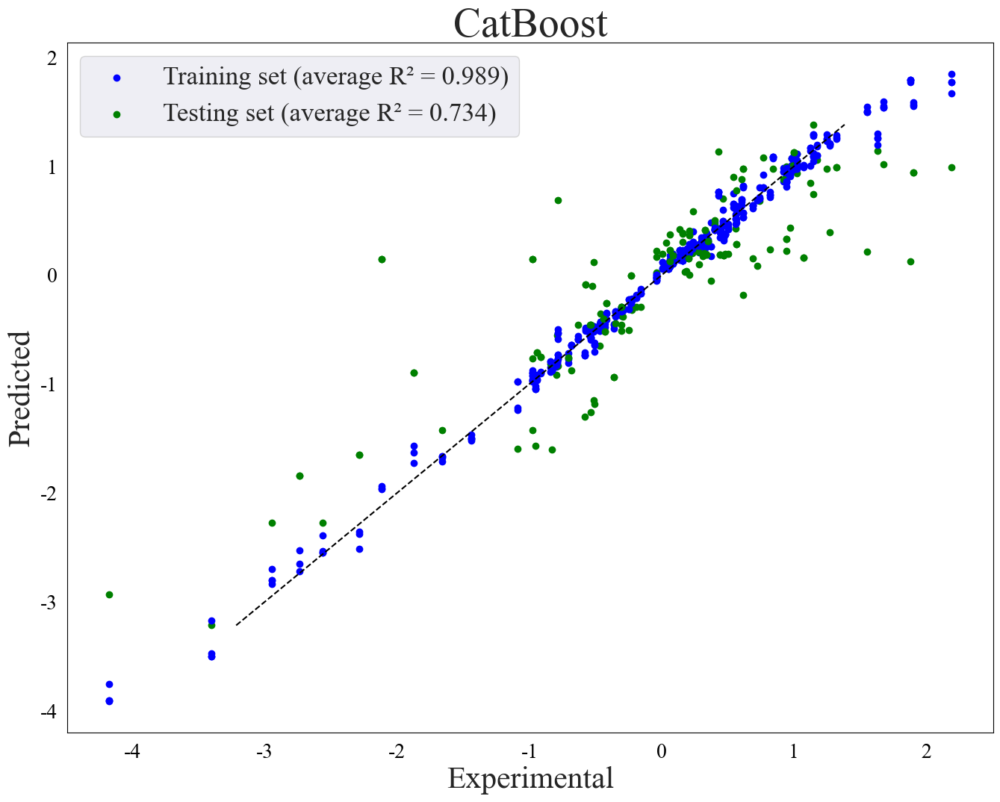

In [84]:
r2_train_cat = []
r2_test_cat = []
mae_train_cat = []
mae_test_cat = []
mse_train_cat = []
mse_test_cat = []
# 用于存储每个样本的预测值
predictions_cat = np.zeros(y_new.shape).reshape(-1, 1)
# 存储所有折的SHAP值
all_shap_values = []
all_expected_values = []
all_X_val = []
shap_values_list_cat = []

# 设置全局字体
plt.rcParams['font.family'] = 'serif'  # 设置字体类型，例如 'serif', 'sans-serif'
plt.rcParams['font.serif'] = ['Times New Roman']  # 指定具体的 serif 字体
plt.rcParams['font.size'] = 10  # 设置字体大小
plt.figure(figsize=(16, 12), facecolor='none')
fold = 0

# 定义 K 倍验证
kf = KFold(n_splits=k_num, shuffle=True,random_state=32)
# 执行 K 倍验证
for idx_train, idx_test in kf.split(X_new):
    X_train, X_test = X_new.iloc[idx_train], X_new.iloc[idx_test]
    y_train, y_test = y_new[idx_train], y_new[idx_test]

    cat_model = CatBoostRegressor(**study1.best_params)

    cat_model.fit(X_train, y_train)
    # 进行预测
    y_test_pred_t1 = cat_model.predict(X_test)
    y_train_pred_t1 = cat_model.predict(X_train)

    cat_train_t1 = r2_score(y_train, y_train_pred_t1)
    cat_test_t1 = r2_score(y_test, y_test_pred_t1)
    cat_train_mse = mean_squared_error(y_train, y_train_pred_t1)
    cat_test_mse = mean_squared_error(y_test, y_test_pred_t1)
    cat_train_mae = mean_absolute_error(y_train, y_train_pred_t1)
    cat_test_mae = mean_absolute_error(y_test, y_test_pred_t1)

    # 将预测值保存到对应的位置
    # predictions[idx_train] = y_train_pred1.reshape(-1,1)
    predictions_cat[idx_test] = y_test_pred_t1.reshape(-1, 1)
    r2_train_cat.append(cat_train_t1)
    r2_test_cat.append(cat_test_t1)
    mae_train_cat.append(cat_train_mae)
    mae_test_cat.append(cat_test_mae)
    mse_train_cat.append(cat_train_mse)
    mse_test_cat.append(cat_test_mse)

    # 计算 SHAP 值
    explainer = shap.TreeExplainer(cat_model)
    shap_values = explainer.shap_values(X_test)
    shap_values1 = explainer(X_test)
    all_X_val.append(idx_test)
    for SHAPs in shap_values:
        shap_values_list_cat.append(SHAPs)

    # 实际值与预测值的散点图
    plt.scatter(y_train, y_train_pred_t1, c='b')
    plt.scatter(y_test, y_test_pred_t1 ,c= 'g')


    fold += 1

plt.scatter(y_train, y_train_pred_t1, c='b', label=f'Training set (average R² = {sum(r2_train_cat) / len(r2_train_cat):.3f})')
plt.scatter(y_test, y_test_pred_t1 ,c= 'g' ,label=f'Testing set (average R² = {sum(r2_test_cat) / len(r2_test_cat):.3f})')

# 确定对角线的起止点
min_val = min(predictions_cat)
max_val = max(predictions_cat)
plt.rcParams['axes.unicode_minus'] = False

# 添加对角线，表示完美预测
plt.plot([min_val, max_val], [min_val, max_val], 'k--')

# 获取当前坐标轴
ax = plt.gca()

#隐藏右边和上边的边框
ax.spines['right'].set_color('black')
ax.spines['top'].set_color('black')
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_color('black')

# 设置坐标轴刻度样式
ax.tick_params(axis='both',  # 'x', 'y', 或 'both'
               which='major',  # 'both', 'major', 或 'minor'
               color='black',  # 刻度线的颜色
               labelcolor='black',
               direction='out',
               length=6,  # 刻度线的长度
               width=5,  # 刻度线颜色
               labelsize=20  # 标签字体大小
               )  # 刻度标签的颜色

# 设置坐标轴背景颜色
ax.set_facecolor('none')
# 添加图例和标签
plt.grid(False)
plt.xlabel('Experimental',fontsize = 30)
plt.ylabel('Predicted',fontsize = 30)
plt.title('CatBoost',fontsize = 40)
plt.legend(fontsize = 25)
plt.savefig('完美曲线_aveg_Cat.png',dpi=1000)
# 显示图表
plt.show()

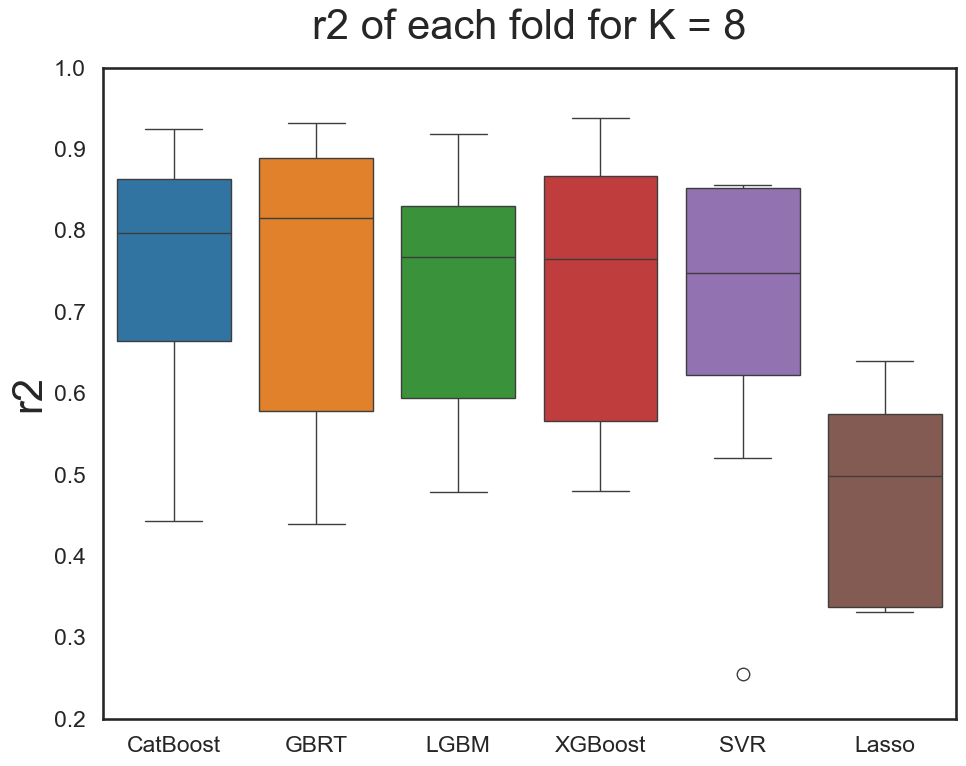

In [379]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

data = {
    'CatBoost':  r2_test_cat,  # 示例数据
    'GBRT': r2_test_gb,
    'LGBM':r2_test_lgb,
    'XGBoost':  r2_test_xgb,
    'SVR': r2_test_SVR,
    'Lasso': r2_test_EN

}
r2_test = pd.DataFrame(data)

# 设置图形样式
plt.figure(figsize=(10, 8))
sns.set_style("white")  # 白色背景
sns.set_context("talk") # 调整字体大小

# 绘制水平箱线图
ax = sns.boxplot(
    data=r2_test,
    orient="v",
    order=['CatBoost',  # 示例数据
    'GBRT',
    'LGBM',
    'XGBoost',
    'SVR',
    'Lasso']  # 控制算法显示顺序
)

# 添加标题和标签
plt.title("r2 of each fold for K = 8", fontsize=30, pad=20)
plt.ylabel("r2", fontsize=30)
plt.ylim(0.20, 1.00)  # 根据原图坐标轴范围设置

plt.tight_layout()
# 如果需要保存图片可添加：
plt.savefig("8-fold_boxplot.png", dpi=300, bbox_inches="tight")
plt.show()


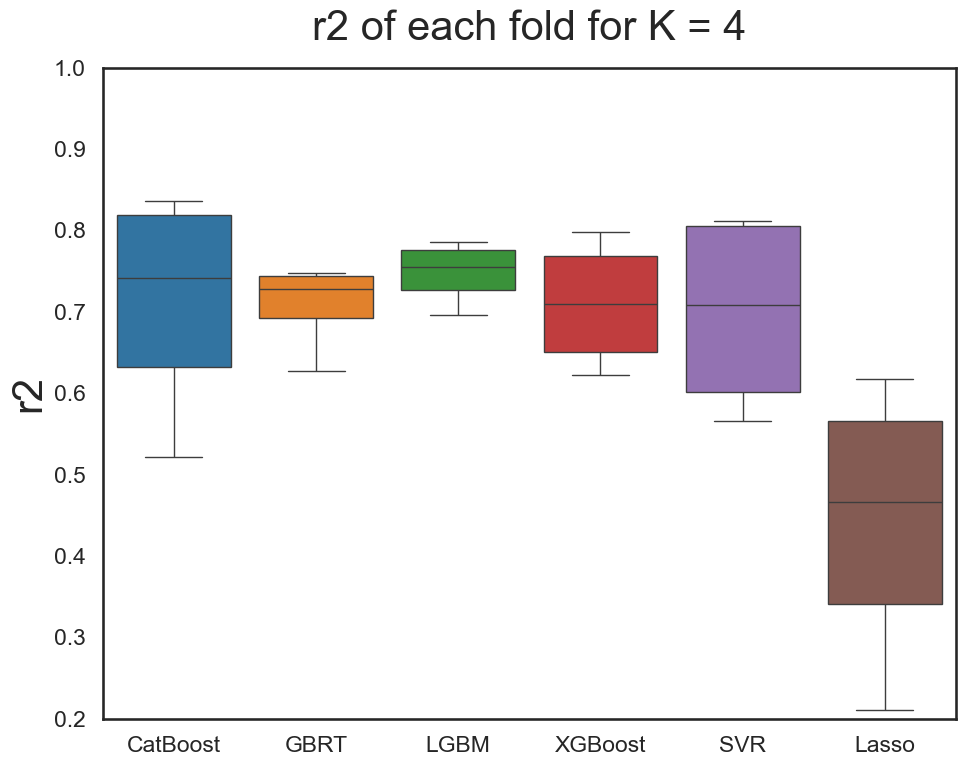

In [351]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

data = {
    'CatBoost':  r2_test_cat,  # 示例数据
    'GBRT': r2_test_gb,
    'LGBM':r2_test_lgb,
    'XGBoost':  r2_test_xgb,
    'SVR': r2_test_SVR,
    'Lasso': r2_test_EN

}
r2_test = pd.DataFrame(data)

# 设置图形样式
plt.figure(figsize=(10, 8))
sns.set_style("white")  # 白色背景
sns.set_context("talk") # 调整字体大小

# 绘制水平箱线图
ax = sns.boxplot(
    data=r2_test,
    orient="v",
    order=['CatBoost',  # 示例数据
    'GBRT',
    'LGBM',
    'XGBoost',
    'SVR',
    'Lasso']  # 控制算法显示顺序
)

# 添加标题和标签
plt.title("r2 of each fold for K = 4", fontsize=30, pad=20)
plt.ylabel("r2", fontsize=30)
plt.ylim(0.20, 1.00)  # 根据原图坐标轴范围设置

plt.tight_layout()
# 如果需要保存图片可添加：
plt.savefig("4-fold_boxplot_01.png", dpi=300, bbox_inches="tight")
plt.show()


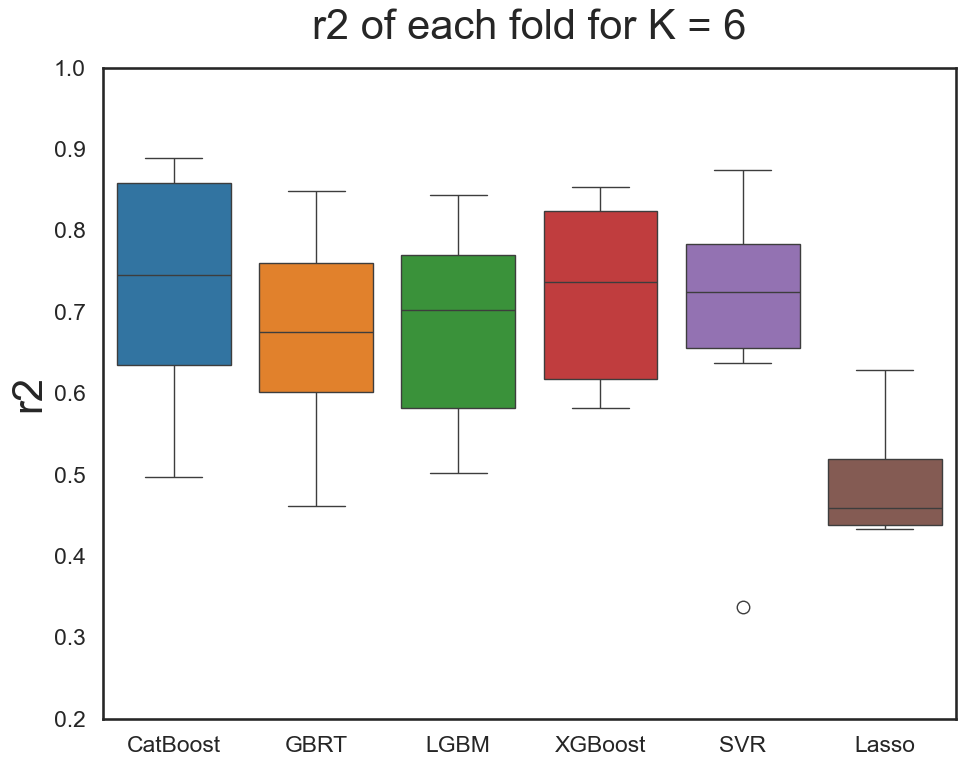

In [366]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

data = {
    'CatBoost':  r2_test_cat,  # 示例数据
    'GBRT': r2_test_gb,
    'LGBM':r2_test_lgb,
    'XGBoost':  r2_test_xgb,
    'SVR': r2_test_SVR,
    'Lasso': r2_test_EN

}
r2_test = pd.DataFrame(data)

# 设置图形样式
plt.figure(figsize=(10, 8))
sns.set_style("white")  # 白色背景
sns.set_context("talk") # 调整字体大小

# 绘制水平箱线图
ax = sns.boxplot(
    data=r2_test,
    orient="v",
    order=['CatBoost',  # 示例数据
    'GBRT',
    'LGBM',
    'XGBoost',
    'SVR',
    'Lasso']  # 控制算法显示顺序
)

# 添加标题和标签
plt.title("r2 of each fold for K = 6", fontsize=30, pad=20)
plt.ylabel("r2", fontsize=30)
plt.ylim(0.20, 1.00)  # 根据原图坐标轴范围设置


plt.tight_layout()
# 如果需要保存图片可添加：
plt.savefig("6-fold_boxplot_01.png", dpi=300, bbox_inches="tight")
plt.show()
